## Cre vs IkbSR-Cre 
12/14/52 - Data generated from KP Rosa26-RIK/+ mice infected with doxycycline inducible IkbSR-Cre construct vs a Cre construct control; Doxycycline was induced for 1 week at 16 weeks post tumor induction (PTI) and tumors were harvested at 17 weeks PTI. data submitted by Jason/Carleigh/CHP/Emma/Eliud/Hannah on 6/22/23

Analyze global run on cellranger v6 data and create h5_ad files for further analysis

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib
from matplotlib import pyplot as plt

from pathlib import Path
import anndata

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [3]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"

In [4]:
Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [5]:
results_file = 'write/JC2499_CrevsIkbSRCre.h5ad'  # the file that will store the analysis results

In [6]:
adata = sc.read_10x_h5('JC2499_filtered_feature_bc_matrix.h5', gex_only=False)

reading JC2499_filtered_feature_bc_matrix.h5
 (0:00:01)


/home/chanj2/part2a/lib/python3.11/site-packages/anndata/_core/anndata.py:1798: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [7]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [8]:
samples = list(adata[:,adata.var['feature_types']=='Antibody Capture'].var.index)

In [9]:
print(samples)

['AY1264_B0301', 'AY1267_B0302', 'AY1268_B0303', 'AY1422_B0304', 'AY1271_B0305', 'AY1262_B0306', 'AY1263_B0307', 'AY1425_B0308', 'AY1483_B0309', 'AY1484_B0310']


In [10]:
# Now filter out barcodes
hashadata = adata[:,samples]
adata = adata[:,[y for y in adata.var_names if y not in samples]]

In [11]:
hashadata.var

,gene_ids,feature_types,genome,pattern,read,sequence
AY1264_B0301,AY1264_B0301,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,ACCCACCAGTAAGAC
AY1267_B0302,AY1267_B0302,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,GGTCGAGAGCATTCA
AY1268_B0303,AY1268_B0303,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,CTTGCCGCATGTCAT
AY1422_B0304,AY1422_B0304,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,AAAGCATTCTTCACG
AY1271_B0305,AY1271_B0305,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,CTTTGTCTTTGTGAG
AY1262_B0306,AY1262_B0306,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TATGCTGCCACGGTA
AY1263_B0307,AY1263_B0307,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,GAGTCTGCCAGTATC
AY1425_B0308,AY1425_B0308,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TATAGAACGCCAGGC
AY1483_B0309,AY1483_B0309,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TGCCTATGAAACAAG
AY1484_B0310,AY1484_B0310,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,CCGATTGTAACAGAC


## Preprocessing

/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:269: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


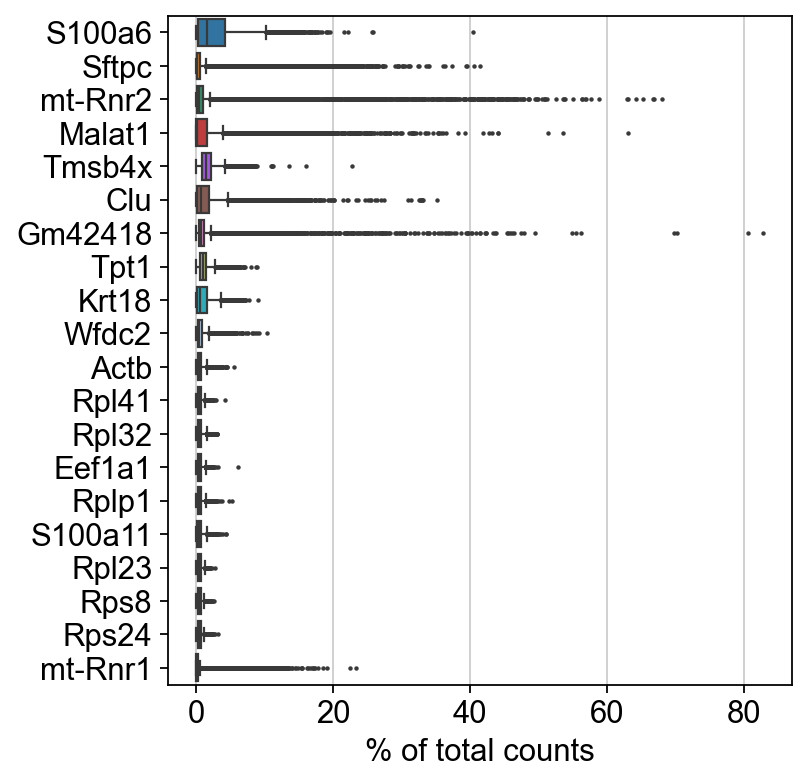

In [12]:
sc.pl.highest_expr_genes(adata, n_top=20, )

Basic filtering:

In [13]:
sc.pp.filter_cells(adata, min_counts=1500)
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 1023 cells that have less than 1500 counts
filtered out 18 cells that have less than 300 genes expressed
filtered out 29416 genes that are detected in less than 3 cells


In [14]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') # annotate the group of mitochondrial genes as 'MT'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

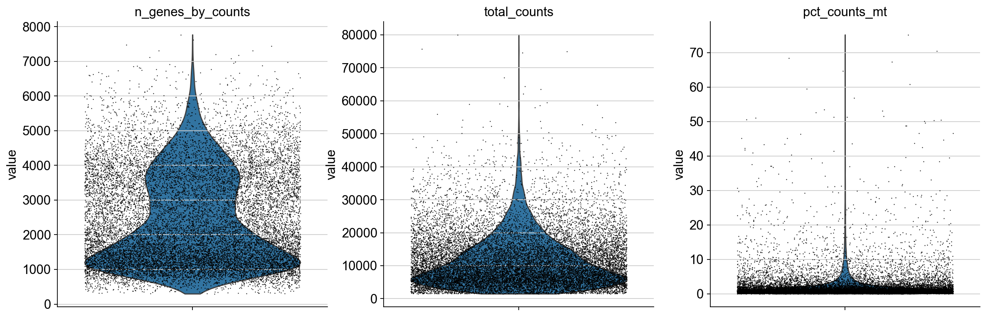

In [15]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

(array([   6.,   58.,  385., 1494., 2706., 4330., 4720., 2898.,  760.,
          28.]),
 array([0.67302963, 0.70115142, 0.72927322, 0.75739502, 0.78551681,
        0.81363861, 0.84176041, 0.8698822 , 0.898004  , 0.9261258 ,
        0.95424759]),
 <BarContainer object of 10 artists>)

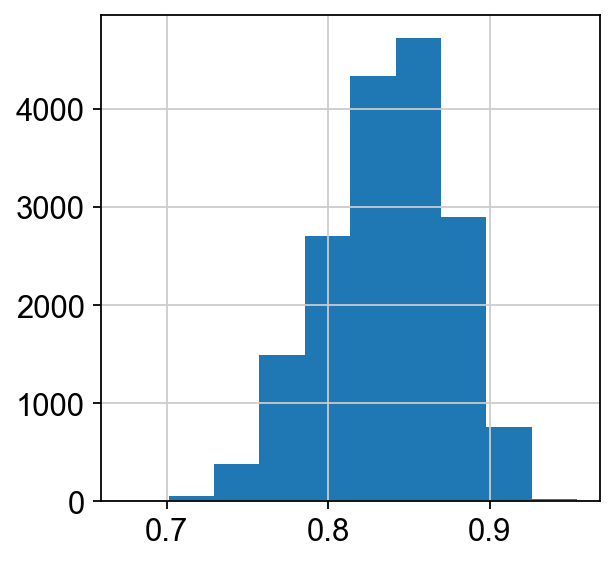

In [16]:
adata.obs["log10GenesPerUMI"] = adata.obs['n_genes_by_counts'].apply(math.log10) / adata.obs['total_counts'].apply(math.log10)
matplotlib.pyplot.hist(adata.obs["log10GenesPerUMI"])

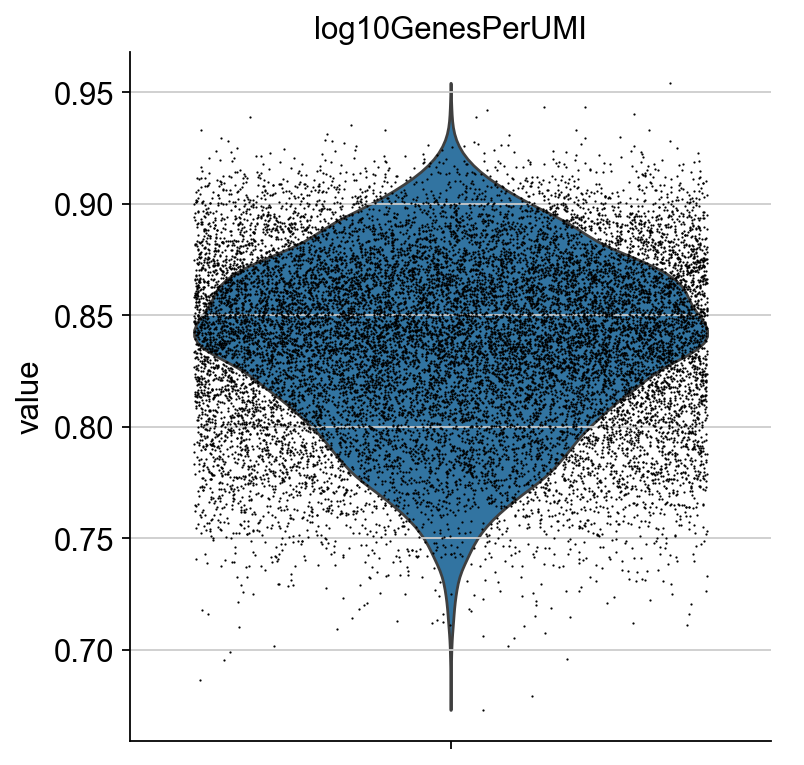

In [17]:
sc.pl.violin(adata, ['log10GenesPerUMI'],
             jitter=0.4, multi_panel=True, rotation=90)
#99% seems like a good Human pct count cutoff

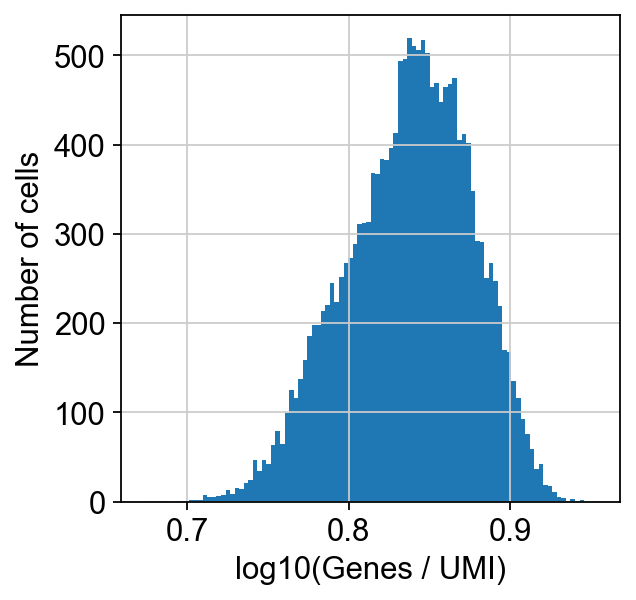

In [18]:
import matplotlib.pyplot as plt

plt.figure()
plt.hist(adata.obs["log10GenesPerUMI"], bins=100)
plt.xlabel("log10(Genes / UMI)")
plt.ylabel("Number of cells")
plt.show()


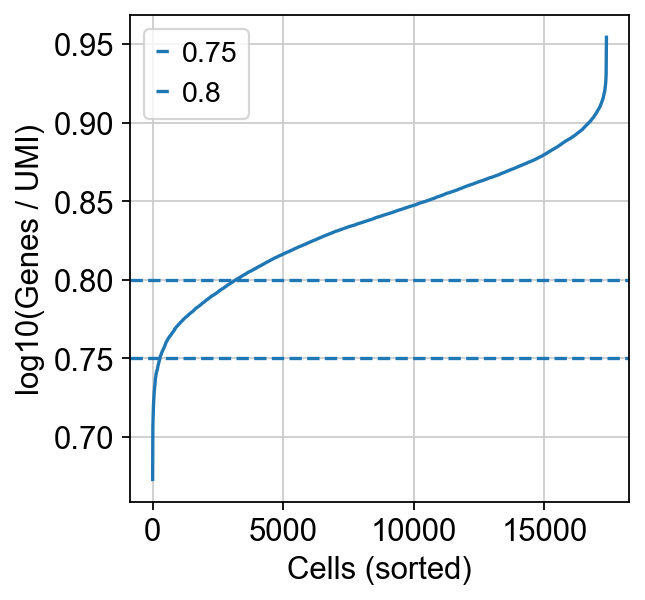

In [19]:
import numpy as np
import matplotlib.pyplot as plt

vals = np.sort(adata.obs["log10GenesPerUMI"].values)

plt.figure()
plt.plot(vals)
plt.xlabel("Cells (sorted)")
plt.ylabel("log10(Genes / UMI)")
plt.axhline(0.75, linestyle="--", label="0.75")
plt.axhline(0.8, linestyle="--", label="0.8")
plt.legend()
plt.show()


In [20]:
#Filter by Log10GenesPerUMI
adata = adata[adata.obs.log10GenesPerUMI >= 0.75,:]

In [21]:
#adata = adata[adata.obs.n_genes_by_counts < 2500, :]
adata = adata[adata.obs.pct_counts_mt <= 20, :]

## Run Demultiplexing

In [22]:
hashadata = hashadata[hashadata.obs.index.isin(adata.obs.index), :]

In [23]:
hashadata.var_names

Index(['AY1264_B0301', 'AY1267_B0302', 'AY1268_B0303', 'AY1422_B0304',
       'AY1271_B0305', 'AY1262_B0306', 'AY1263_B0307', 'AY1425_B0308',
       'AY1483_B0309', 'AY1484_B0310'],
      dtype='object')

In [24]:
hashCounts = pd.DataFrame(hashadata.X.todense(), columns=hashadata.var_names, index=adata.obs.index)

In [25]:
hashDisc = hashCounts.describe([.1,.2,.3,.4,.5,.6,.7,.8,.9,0.99,0.999])
hashDisc

,AY1264_B0301,AY1267_B0302,AY1268_B0303,AY1422_B0304,AY1271_B0305,AY1262_B0306,AY1263_B0307,AY1425_B0308,AY1483_B0309,AY1484_B0310
count,16918.000000,16918.000000,16918.000000,16918.000000,16918.000000,16918.000000,16918.000000,16918.000000,16918.000000,16918.000000
mean,395.202728,287.589020,262.166168,555.378174,246.257294,51.921505,72.313866,101.929192,129.806534,112.155518
std,2890.324219,1557.646484,1109.552612,2025.603149,713.407410,537.379089,431.043671,538.641663,561.034180,652.787720
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
10%,11.000000,8.000000,7.000000,12.000000,4.000000,0.000000,1.000000,10.000000,6.000000,2.000000
20%,14.000000,10.000000,9.000000,15.000000,5.000000,1.000000,2.000000,12.000000,7.000000,3.000000
30%,16.000000,12.000000,11.000000,18.000000,6.000000,1.000000,3.000000,14.000000,9.000000,4.000000
40%,18.000000,13.000000,13.000000,20.000000,8.000000,2.000000,3.000000,16.000000,10.000000,5.000000
50%,21.000000,15.000000,15.000000,23.000000,9.000000,2.000000,4.000000,18.000000,12.000000,6.000000
60%,25.000000,17.000000,17.000000,27.000000,11.000000,3.000000,4.000000,20.000000,13.000000,8.000000


In [26]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(hashDisc.loc["90%",hashName])
    hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
hashIDs

AY1264_B0301
1260.9000000000033
AY1267_B0302
39.0
AY1268_B0303
287.3000000000011
AY1422_B0304
1203.0
AY1271_B0305
915.0
AY1262_B0306
6.0
AY1263_B0307
9.0
AY1425_B0308
79.0
AY1483_B0309
189.0
AY1484_B0310
189.0


/tmp/ipykernel_3285603/2942643048.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/tmp/ipykernel_3285603/2942643048.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/tmp/ipykernel_3285603/2942643048.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False  True  True]' has dtype incompatible with float32, please exp

,AY1264_B0301,AY1267_B0302,AY1268_B0303,AY1422_B0304,AY1271_B0305,AY1262_B0306,AY1263_B0307,AY1425_B0308,AY1483_B0309,AY1484_B0310
AAACCCAAGCTCCGAC-1,False,False,False,False,False,False,False,False,False,False
AAACCCAAGCTTTCCC-1,False,False,False,False,False,True,True,False,True,False
AAACCCAAGGAATCGC-1,False,False,False,True,False,False,False,False,False,False
AAACCCACAACAAGAT-1,False,False,False,False,False,False,False,False,False,True
AAACCCACACAGTACT-1,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCATTGCTT-1,False,False,False,False,False,False,False,False,False,False
TTTGTTGTCCCGTTCA-1,False,False,False,False,False,False,True,False,False,False
TTTGTTGTCCGGCAAC-1,False,False,False,False,False,False,False,False,False,True
TTTGTTGTCGAGCCTG-1,False,False,True,False,False,False,False,False,False,False


In [27]:
from matplotlib import pyplot as plt

In [28]:
hashCounts

,AY1264_B0301,AY1267_B0302,AY1268_B0303,AY1422_B0304,AY1271_B0305,AY1262_B0306,AY1263_B0307,AY1425_B0308,AY1483_B0309,AY1484_B0310
AAACCCAAGCTCCGAC-1,770.0,27.0,10.0,38.0,9.0,1.0,7.0,20.0,24.0,9.0
AAACCCAAGCTTTCCC-1,23.0,19.0,16.0,25.0,9.0,20.0,15.0,15.0,1252.0,4.0
AAACCCAAGGAATCGC-1,16.0,7.0,11.0,2938.0,12.0,3.0,8.0,12.0,5.0,6.0
AAACCCACAACAAGAT-1,9.0,10.0,13.0,29.0,15.0,4.0,7.0,13.0,16.0,1241.0
AAACCCACACAGTACT-1,16.0,14.0,12.0,13.0,9.0,5.0,3.0,9.0,171.0,5.0
...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCATTGCTT-1,14.0,12.0,40.0,17.0,4.0,0.0,1.0,11.0,11.0,3.0
TTTGTTGTCCCGTTCA-1,12.0,7.0,2.0,14.0,2.0,1.0,211.0,16.0,8.0,4.0
TTTGTTGTCCGGCAAC-1,24.0,14.0,8.0,43.0,5.0,1.0,1.0,23.0,10.0,793.0
TTTGTTGTCGAGCCTG-1,10.0,32.0,6198.0,29.0,6.0,3.0,1.0,18.0,7.0,7.0


In [29]:
plt.rcParams['figure.figsize'] = (4,4)

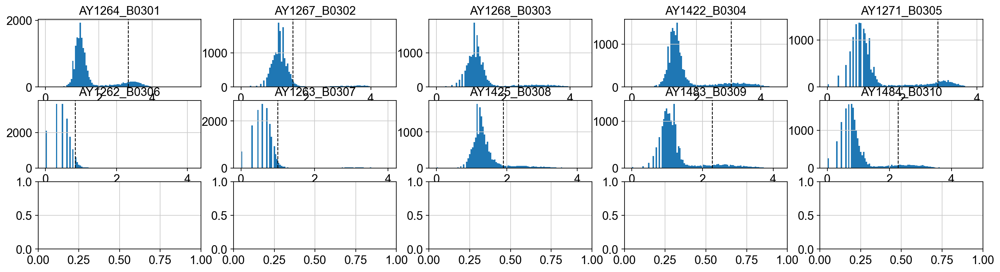

In [30]:
fig, axs = plt.subplots(3,5, figsize =(20, 5))

for i, hashName in enumerate(hashadata.var_names):
    hashCounts2 = np.log10(hashCounts[hashName]+1)
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].hist(hashCounts2, bins = 100)
    axs[i//5,i%5].axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)

#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

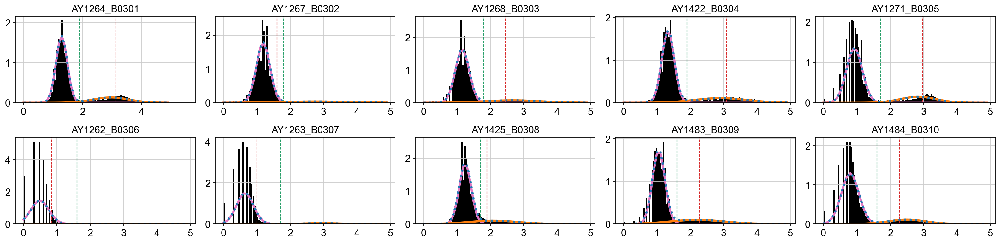

In [31]:
from sklearn.mixture import BayesianGaussianMixture
from scipy.stats import norm
fig, axs = plt.subplots(2,5, figsize =(20, 5))
dfHashBoundry = pd.DataFrame(np.zeros(len(hashadata.var_names)),hashadata.var_names, columns=["boundry"])
gmm = BayesianGaussianMixture(n_components=2, random_state=250,init_params='k-means++')
binEx = np.arange(0,5,5/100).reshape(-1,1)

for i, hashName in enumerate(hashadata.var_names):
    hashCount = np.array(np.log10(hashCounts[hashName]+1)).reshape(-1, 1)
    fitGMM = gmm.fit(hashCount)
    mean = fitGMM.means_  
    covs  = fitGMM.covariances_
    weights = fitGMM.weights_
  
    fitGmmBound = fitGMM.predict(binEx)

    if mean[0][0] < mean[1][0]:
        left_idx, right_idx = 0, 1
    else:
        left_idx, right_idx = 1, 0

    
    x_axis = np.arange(0, 5, 0.1)
    
    y_left = norm.pdf(x_axis, float(mean[left_idx][0]), np.sqrt(float(covs[left_idx][0][0]))) * weights[left_idx]
    y_right = norm.pdf(x_axis, float(mean[right_idx][0]), np.sqrt(float(covs[right_idx][0][0]))) * weights[right_idx]

    hashBoundry = False #binEx[np.where(fitGmmBound == 1)[0][0]][0]  

    diff = y_right - y_left
    crossings = np.where(np.diff(np.sign(diff)) > 0)[0]  # where right overtakes left
    
    if len(crossings) > 0:
        # Take the first crossing where right becomes dominant
        idx = crossings[0]
        hashBoundry = x_axis[idx + 1]  # slightly to the right
    else:
        # If no intersection found, fall back to right mean or a fixed value
        hashBoundry = float(mean[right_idx][0])

    
    naiveBoundry = np.log10(int(hashDisc.loc["90%",hashName])+1)
    
    dfHashBoundry.loc[hashName] = hashBoundry
    
    # Plot 2
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].axvline(naiveBoundry, c='C3', linestyle='dashed', linewidth=1) #red
    axs[i//5,i%5].axvline(hashBoundry, c='C2', linestyle='dashed', linewidth=1)  #green
    axs[i//5,i%5].hist(hashCount, density=True, color='black', bins=100)        
    axs[i//5,i%5].plot(x_axis, y_left, lw=3, c='C6')                            #pink
    axs[i//5,i%5].plot(x_axis, y_right, lw=3, c='C1')                            #orange
    axs[i//5,i%5].plot(x_axis, y_left+y_right, lw=3, c='C0', ls=':')            #dotted blue
    
plt.tight_layout(pad=1.0)
#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

In [32]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
#set manual minimum threshold to be 1
for hashName in hashadata.var_names:
    print(hashName)
    print(dfHashBoundry.loc[hashName].values[0])
    #manually set minimum threshold to 1 given poor HashData
    if (dfHashBoundry.loc[hashName].values[0] < 1):
        dfHashBoundry.loc[hashName].values[0] = 1
    print(dfHashBoundry.loc[hashName].values[0])
    hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
#hashIDs

AY1264_B0301
1.9000000000000001
1.9000000000000001
AY1267_B0302
1.8
1.8
AY1268_B0303
1.8
1.8
AY1422_B0304
1.9000000000000001
1.9000000000000001
AY1271_B0305
1.7000000000000002
1.7000000000000002
AY1262_B0306
1.6
1.6
AY1263_B0307
1.7000000000000002
1.7000000000000002
AY1425_B0308
1.7000000000000002
1.7000000000000002
AY1483_B0309
1.6
1.6
AY1484_B0310
1.6
1.6


/tmp/ipykernel_3285603/4060069450.py:11: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ True False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/tmp/ipykernel_3285603/4060069450.py:11: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/tmp/ipykernel_3285603/4060069450.py:11: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False  True  True]' ha

In [33]:
classification = np.empty(len(adata), dtype="object")
i = 0
for cellBar, hashBool in hashIDs.iterrows():
    numHashes = sum(hashBool)
    if (numHashes == 1):
        classif = hashID[hashBool.values].values[0]
    elif (numHashes > 1):
        classif = "doublet"
    else:
        classif = "negative"
    classification[i] = classif
    i = i + 1
    #break

In [34]:
adata.obs["Classification"] = classification
hashadata.obs["Classification"] = classification
adata.obs["Classification"].value_counts()

/tmp/ipykernel_3285603/4135005838.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["Classification"] = classification
/tmp/ipykernel_3285603/4135005838.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  hashadata.obs["Classification"] = classification


Classification
doublet         4489
AY1271_B0305    1904
AY1264_B0301    1784
AY1422_B0304    1720
AY1483_B0309    1342
AY1484_B0310    1339
AY1268_B0303    1186
AY1425_B0308    1024
negative         894
AY1267_B0302     651
AY1263_B0307     443
AY1262_B0306     142
Name: count, dtype: int64

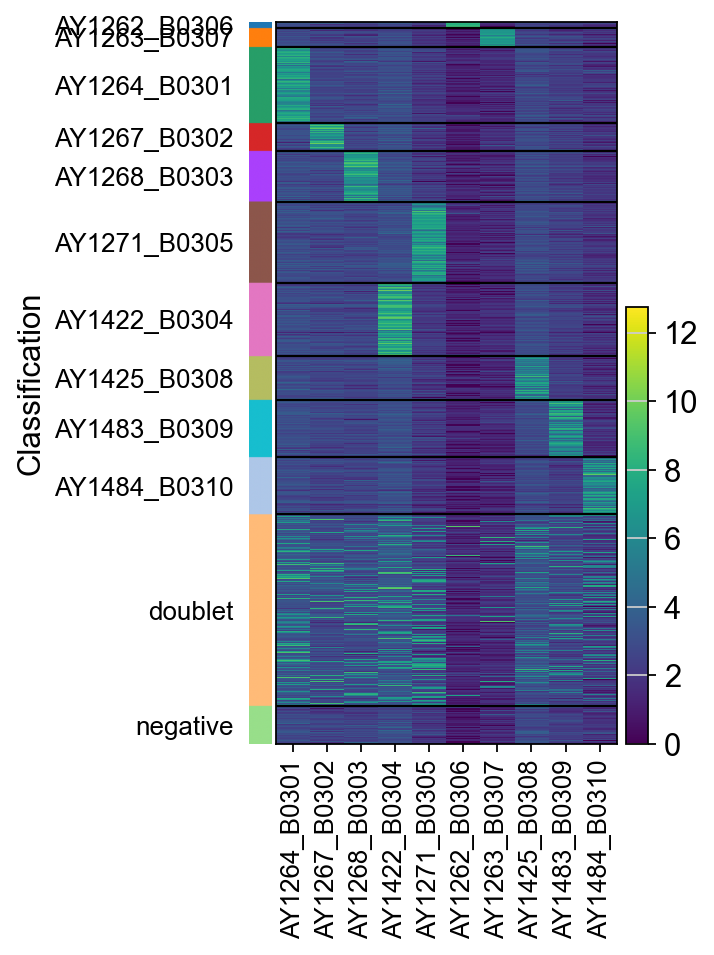

In [35]:
#output visualization of hashing
sc.pl.heatmap(hashadata, hashadata.var_names, groupby="Classification", log=True)#, save = f"_{figName}_hash.png")

## Set transgenes counts

(array([1.6791e+04, 8.7000e+01, 2.5000e+01, 8.0000e+00, 5.0000e+00,
        1.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00]),
 array([ 0.        ,  1.20000005,  2.4000001 ,  3.60000014,  4.80000019,
         6.        ,  7.20000029,  8.40000057,  9.60000038, 10.80000019,
        12.        ]),
 <BarContainer object of 10 artists>)

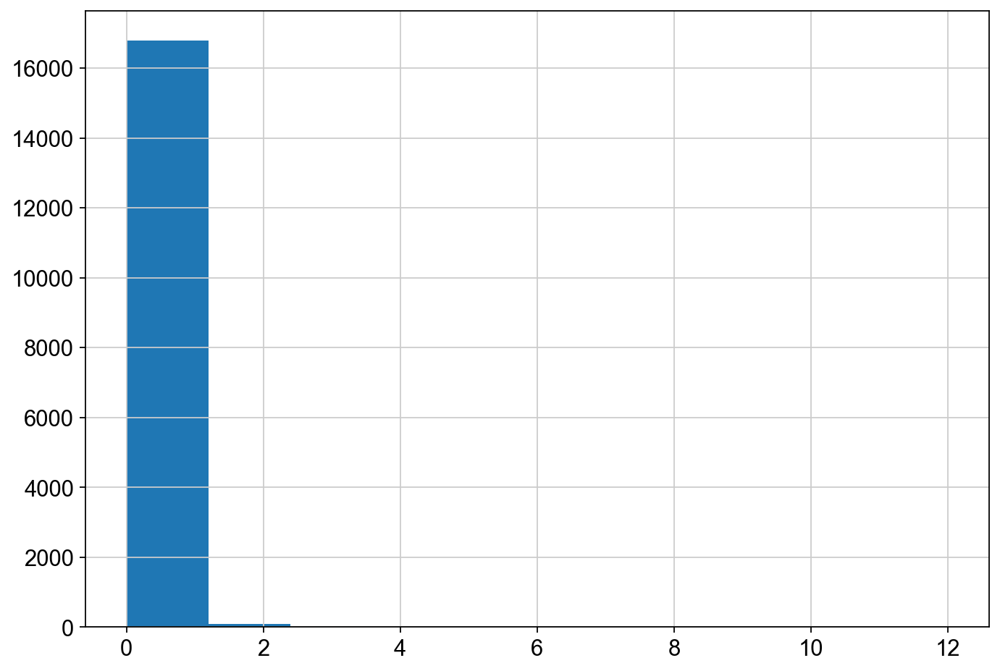

In [36]:
#Remove any cell with PTPRC counts
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(adata.X[:,adata.var.index.isin(['Cre'])].toarray())
#ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
#adata.obs['shRen'] = 0

#adata.obs['shRenilla'][adata.X[:,adata.var.index.isin(['shRenilla'])] >0] #= adata.X[:,adata.var.index.isin(['shRenilla'])]

In [37]:
adata.obs['Cre_count'] = adata.X[:,adata.var.index.isin(['Cre'])].toarray()

## Remove doublets, negative cells

In [38]:
adata = adata[~adata.obs['Classification'].isin(['doublet','negative']),:]

In [39]:
adata.obs.Classification.value_counts()

Classification
AY1271_B0305    1904
AY1264_B0301    1784
AY1422_B0304    1720
AY1483_B0309    1342
AY1484_B0310    1339
AY1268_B0303    1186
AY1425_B0308    1024
AY1267_B0302     651
AY1263_B0307     443
AY1262_B0306     142
Name: count, dtype: int64

## Set Groups

In [40]:
#Set shRNA groups
adata.obs['Group'] = 'Cre'
adata.obs['Group'][adata[adata.obs.Classification.isin(['AY1262_B0306','AY1263_B0307','AY1425_B0308',
                                                        'AY1483_B0309','AY1484_B0310']),:].obs.index] = 'IkbSR-Cre'

/tmp/ipykernel_3285603/4004678245.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['Group'] = 'Cre'
/tmp/ipykernel_3285603/4004678245.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-ve

In [41]:
adata.obs[['Classification','Group']].value_counts()

Classification  Group    
AY1271_B0305    Cre          1904
AY1264_B0301    Cre          1784
AY1422_B0304    Cre          1720
AY1483_B0309    IkbSR-Cre    1342
AY1484_B0310    IkbSR-Cre    1339
AY1268_B0303    Cre          1186
AY1425_B0308    IkbSR-Cre    1024
AY1267_B0302    Cre           651
AY1263_B0307    IkbSR-Cre     443
AY1262_B0306    IkbSR-Cre     142
Name: count, dtype: int64

## Make backup copy of raw counts

In [42]:
adata.layers['counts']=adata.X.copy()

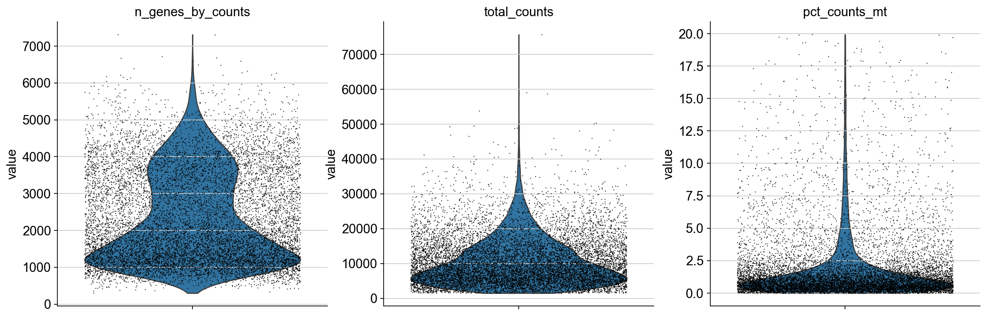

In [43]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

## Continue preprocessing

In [44]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [45]:
sc.pp.log1p(adata)

In [46]:
sc.pp.highly_variable_genes(adata) #batch_key=Classification

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


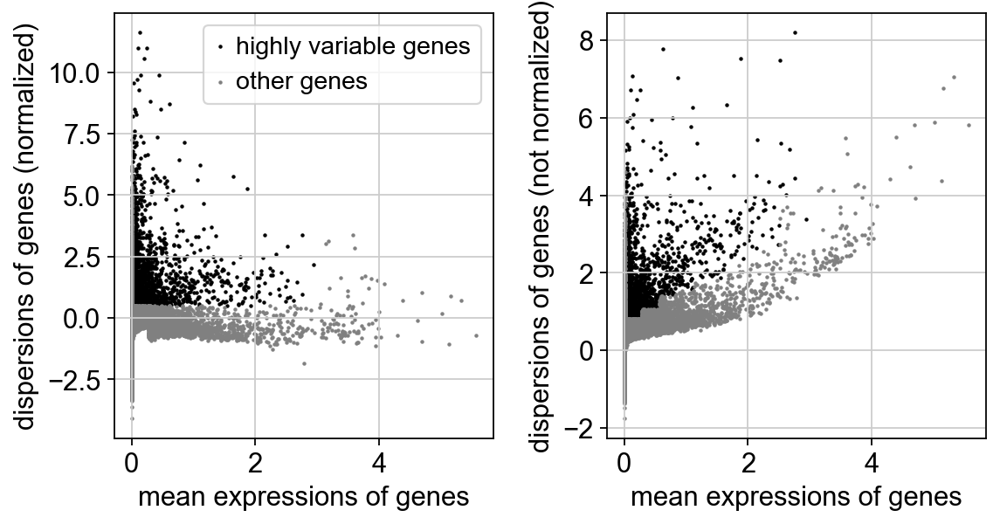

In [47]:
sc.pl.highly_variable_genes(adata)

In [48]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['Ikbsr-FLAG'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['mKate2'] = False

/tmp/ipykernel_3285603/2033711310.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['Ikbsr-FLAG'] = False
/tmp/ipykernel_3285603/2033711310.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a

In [49]:
samples

['AY1264_B0301',
 'AY1267_B0302',
 'AY1268_B0303',
 'AY1422_B0304',
 'AY1271_B0305',
 'AY1262_B0306',
 'AY1263_B0307',
 'AY1425_B0308',
 'AY1483_B0309',
 'AY1484_B0310']

In [50]:
adata.raw = adata

In [51]:
adata.write('write/JC2499_allmice.h5ad', compression='gzip')

In [52]:
sc.pp.scale(adata, max_value=10)

/home/chanj2/part2a/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [53]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=100)

computing PCA
    with n_comps=100
    finished (0:00:05)


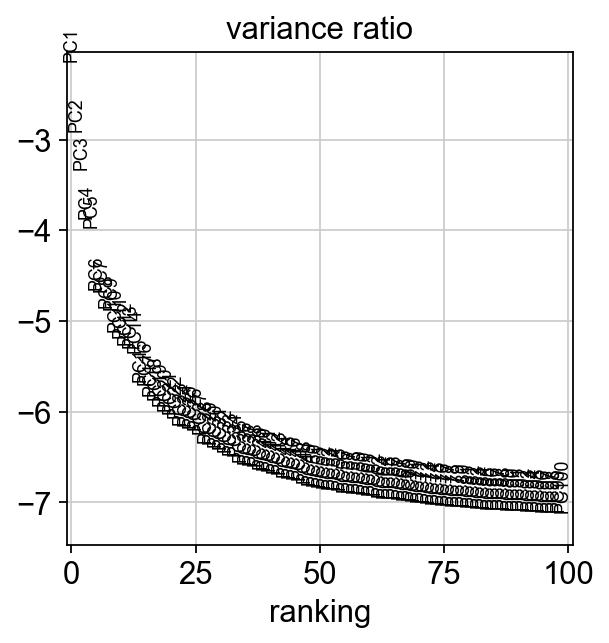

In [54]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=100)

In [55]:
adata.write(results_file, compression='gzip')

In [56]:
adata

AnnData object with n_obs × n_vars = 11535 × 25427
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Cre_count', 'Group'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

## Computing the neighborhood graph

In [57]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50


/home/chanj2/part2a/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:19)


## Embedding the neighborhood graph

In [58]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:15)


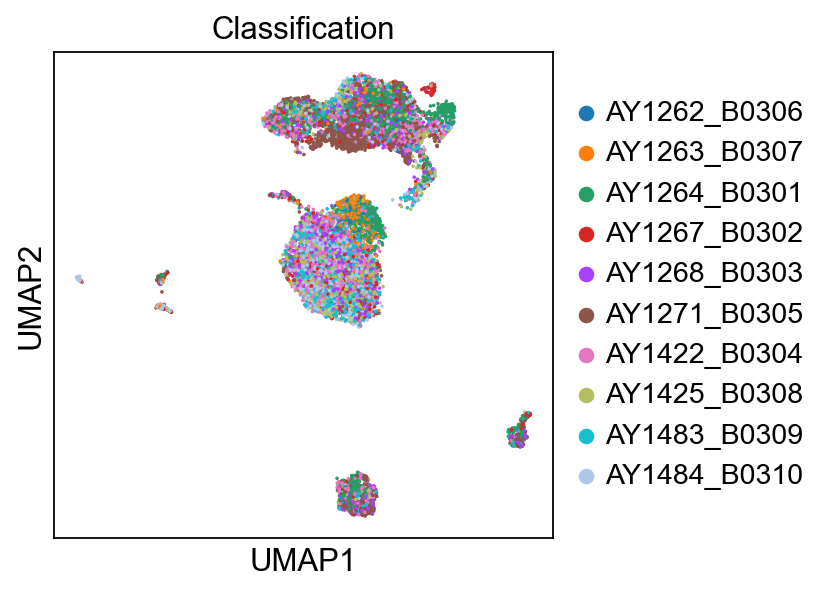

In [59]:
sc.pl.umap(adata, color=['Classification'])

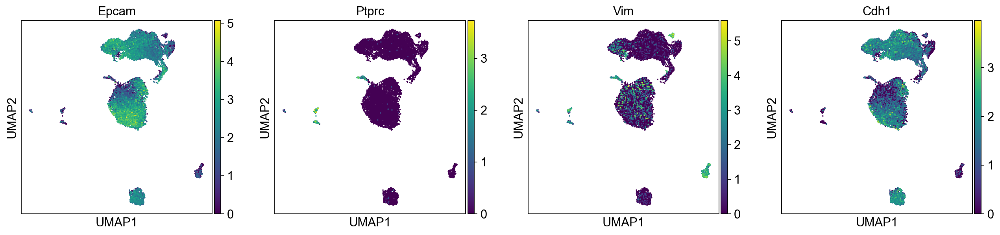

In [60]:
sc.pl.umap(adata, color=['Epcam', 'Ptprc','Vim', 'Cdh1',])#'Cdh2'

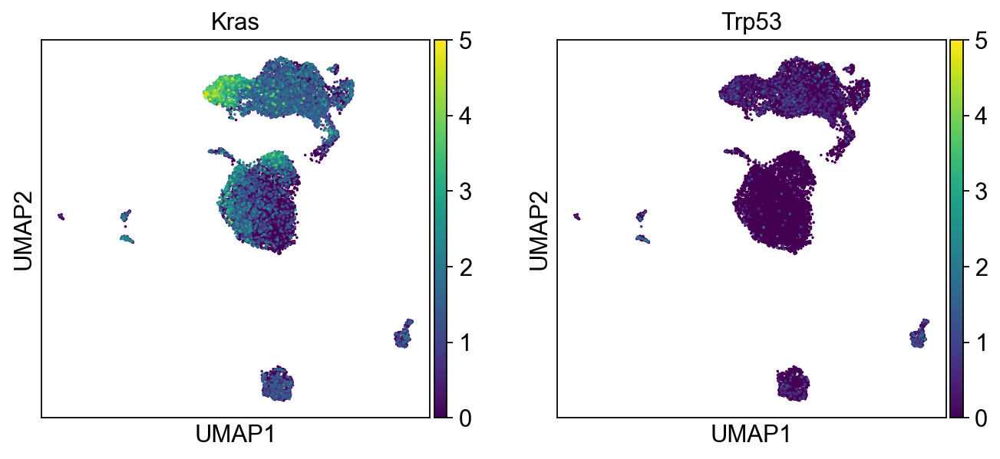

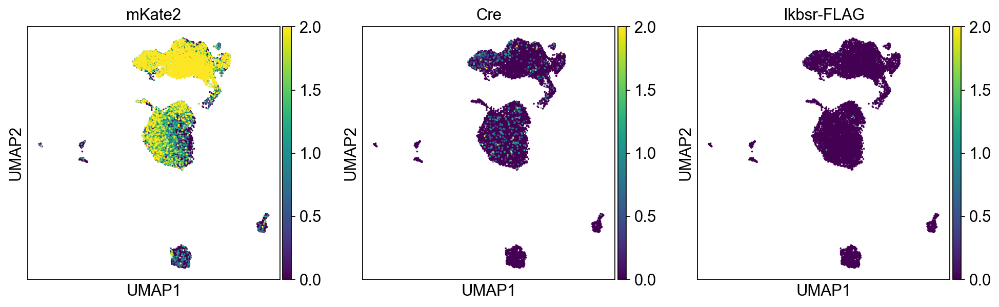

In [61]:
sc.pl.umap(adata, color=['Kras','Trp53'], vmax=5)
sc.pl.umap(adata, color=['mKate2','Cre','Ikbsr-FLAG'], vmax=2)

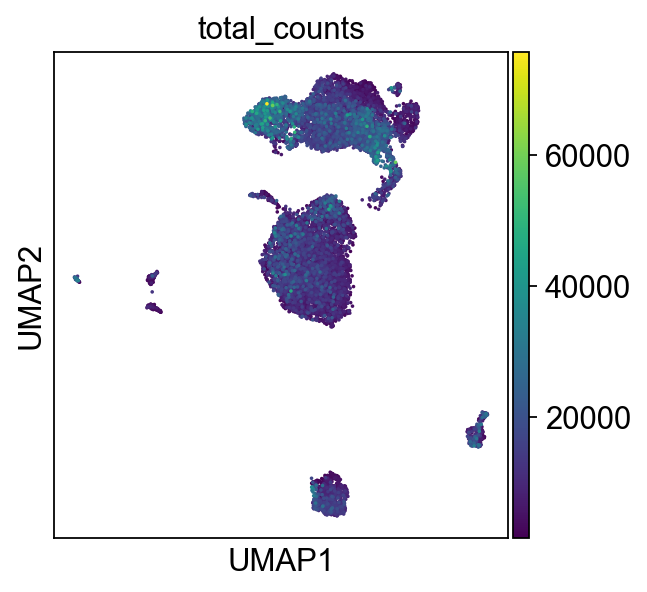

In [62]:
sc.pl.umap(adata, color=['total_counts'])

In [63]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        elif hpcs == 'cell2020_no_Slc4a11':         
            with open('../../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']   
                    if 'Slc4a11' in clusters[row[0]]:
                        clusters[row[0]].remove('Slc4a11')
                        print("Slc4a11 removed")
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [64]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i)  
        #sc.tl.score_genes(ad, clusters['Highly_mixed'],score_name="Highly_mixed")
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [65]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
        #sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    846 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    794 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    696 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    798 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    843 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Ldha-ps2'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    946 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs)

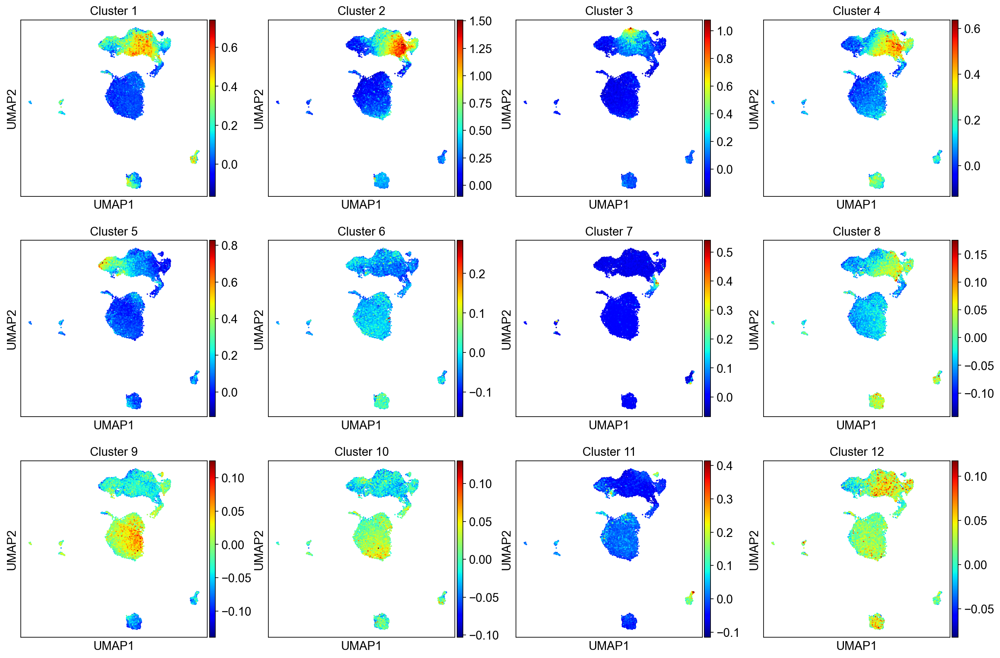

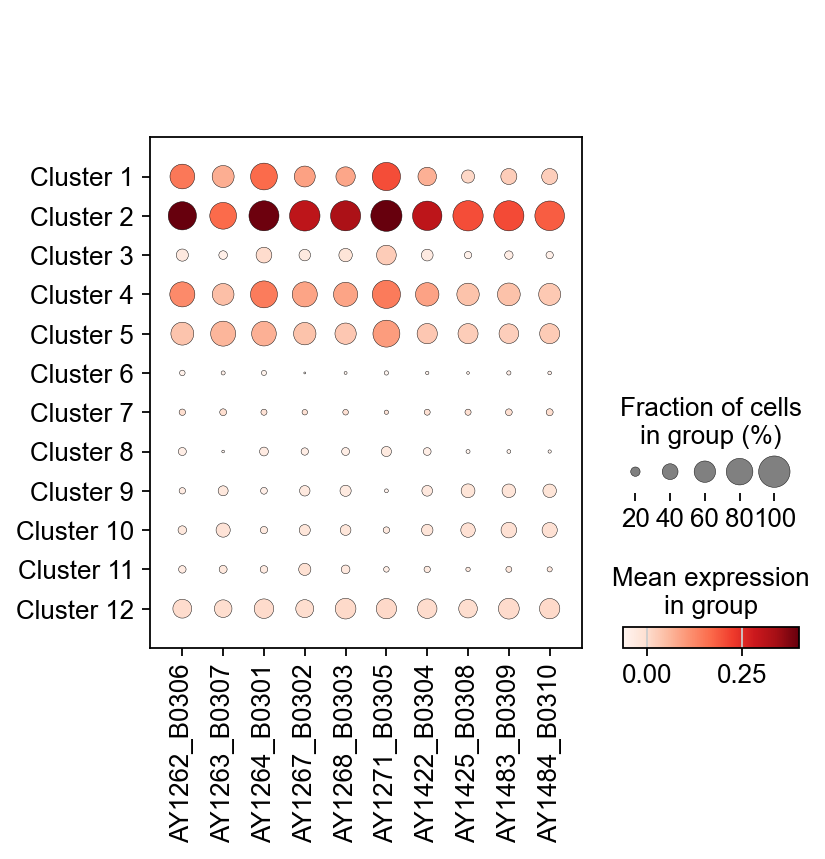

In [66]:
scoreAndPlot(adata,numgenes=100)

## Clustering the neighborhood graph

In [71]:
#sc.tl.leiden(adata, resolution=0.30)
sc.tl.leiden(adata, resolution=0.15)

running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


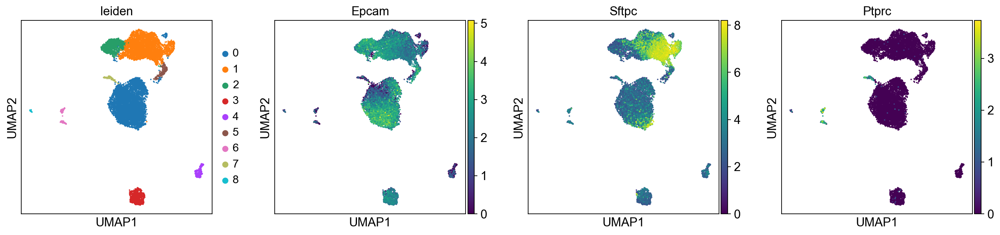

(None,)

In [72]:
sc.pl.umap(adata, color=['leiden', 'Epcam', 'Sftpc', # Tumor cells
                         'Ptprc']), #immune
                         # 'Cd3e', 'Cd4', 'Cd8a', #T cell
                         # 'Cd19', 'Ms4a1', 'Cd22', # B cell
                         # #'Itgax', 'Il3ra', # Dendritic Cell
                         # 'Ncam1',# 'Ncr1', # NK Cell
                         # 'Cd34', # Hematopoetic stem cell
                         # #'Cd14', 'Cd33', # macrophage
                         # #'Ceacam8' # Granulocyte
                         # 'Itga2b', 'Itgb3', 'Selp', #platelet
                         # #'Gypa',  # erythrocyte
                         # #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         # 'Cd109', 'Wnt5a', 'Kras'])

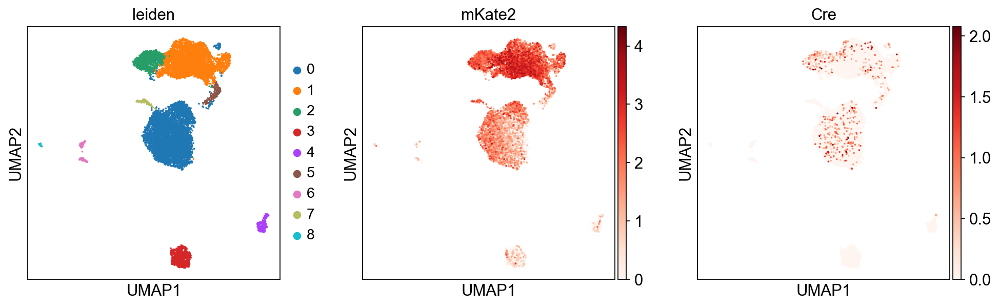

In [73]:
sc.pl.umap(adata,color=['leiden','mKate2','Cre'], cmap='Reds')

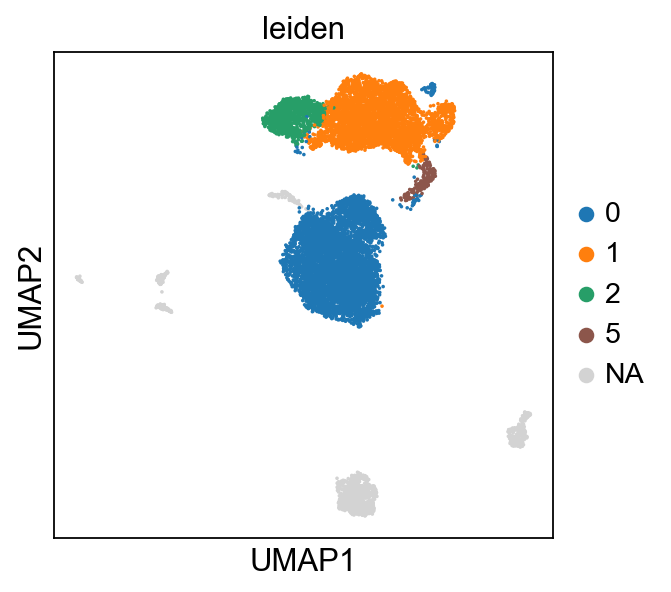

In [74]:
sc.pl.umap(adata, color=['leiden'], groups=['0','1','2','5']) # cluster 3 seems to be fibroblasts

## Select Tumor Cells

In [75]:
# Select only those subset of cells that are useful
adata2 = sc.read('write/JC2499_allmice.h5ad')
adata = adata2[adata.obs['leiden'].isin(['0','1','2','5']),:] # remove fibroblast cells
del adata2

In [76]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p']['base'] = None

In [77]:
sc.pp.highly_variable_genes(adata)#, batch_key='Classification')

extracting highly variable genes
    finished (0:00:00)


/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:744: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["hvg"] = {"flavor": flavor}


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [78]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['Ikbsr-FLAG'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Cre'] = False
#for x in library:
#    adata.var.highly_variable[x] = False

/tmp/ipykernel_3285603/3736702553.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['Ikbsr-FLAG'] = False
/tmp/ipykernel_3285603/3736702553.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a

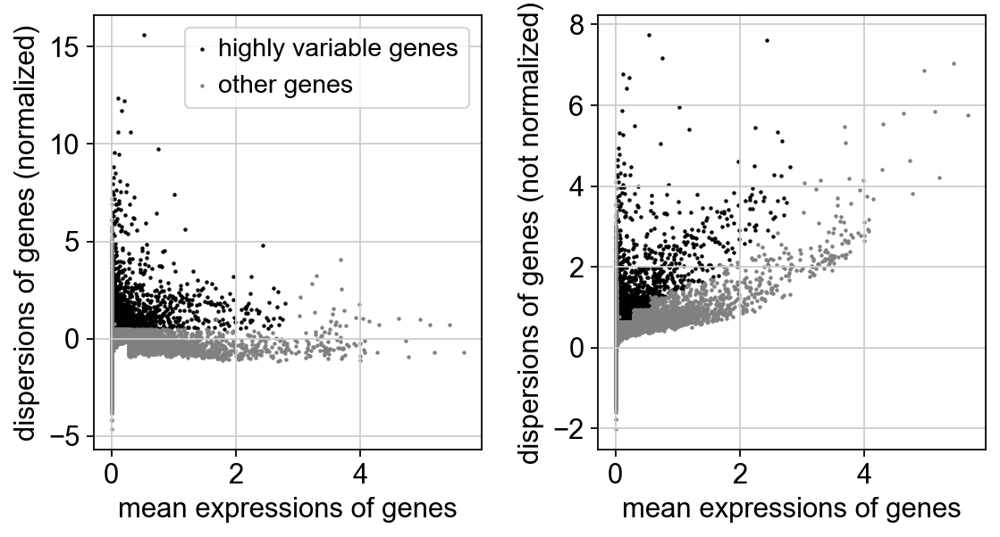

In [79]:
sc.pl.highly_variable_genes(adata)

In [80]:
adata.raw = adata

In [81]:
adata.write('write/JC2499_allmice-tumor.h5ad', compression='gzip')
#adata = sc.read('write/JC2499_allmice-tumor.h5ad')

## Potentially end here

## Now rerun algorithm

In [76]:
sc.pp.scale(adata, max_value=10)

/home/chanj2/part2a/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [77]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:07)


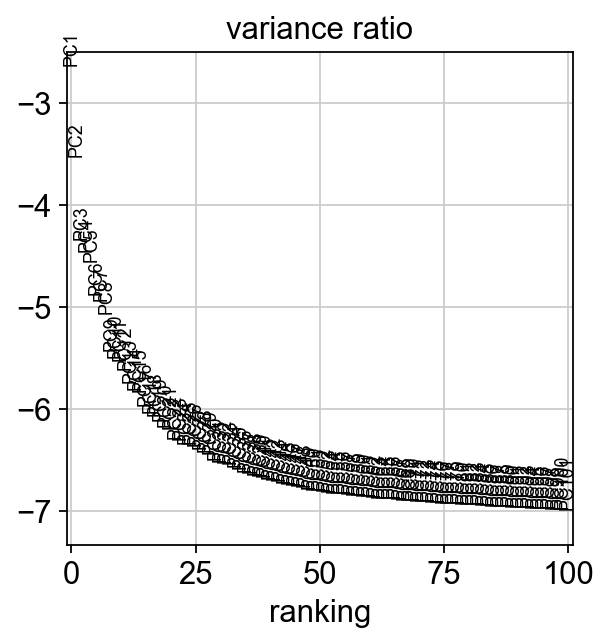

In [78]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=100)

In [79]:
adata.write(results_file, compression='gzip')

In [80]:
adata

AnnData object with n_obs × n_vars = 8367 × 25427
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Cre_count', 'Group'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

## Computing the neighborhood graph

In [81]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


## Embedding the neighborhood graph

In [82]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:31)


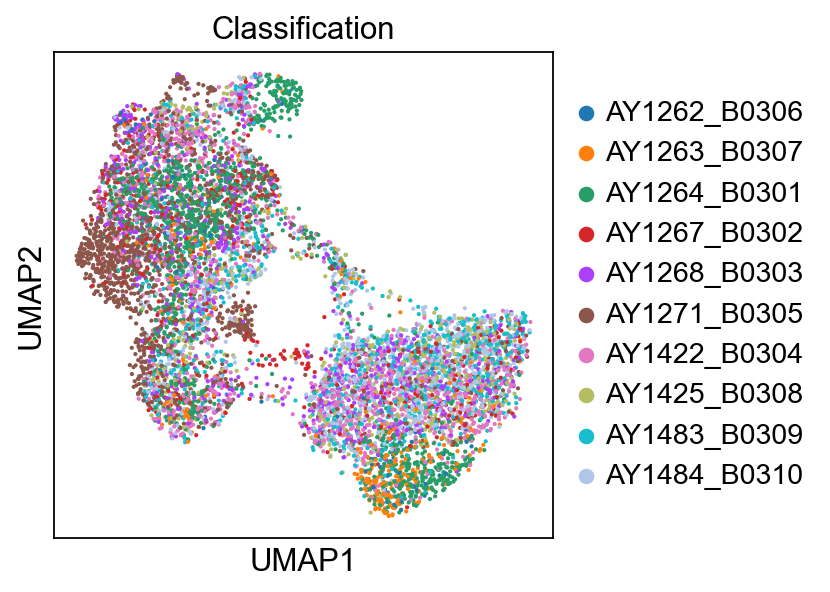

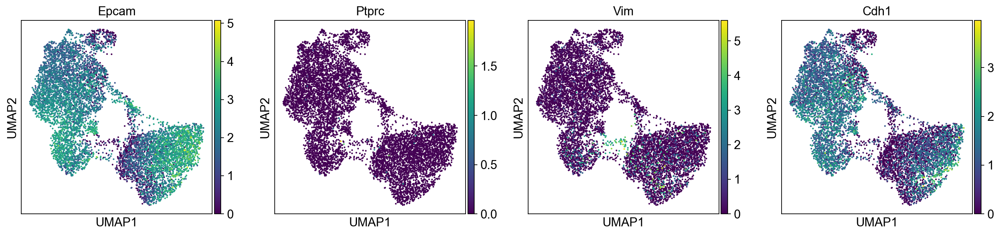

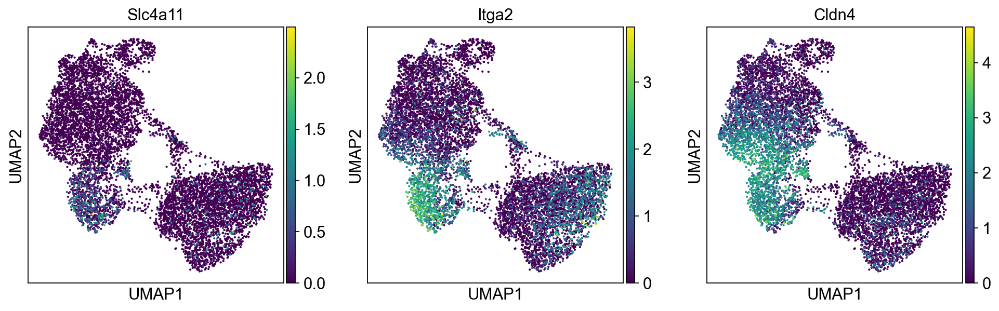

In [83]:
sc.pl.umap(adata, color=['Classification'])
#sc.pl.umap(adata, color=['Porcn', 'Lgr5', 'Lgr6','Axin2']) #LGR5 not found #
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1',]) #CDH2 not found #'Cdh2'
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) #, 'Abcb1'
#sc.pl.umap(adata, color=['Hopx', 'Pdpn'])
#sc.pl.umap(adata, color=['Cd81', 'Cd19'])
#sc.pl.umap(adata, color=['Trp53','Meg3'], vmax=5)

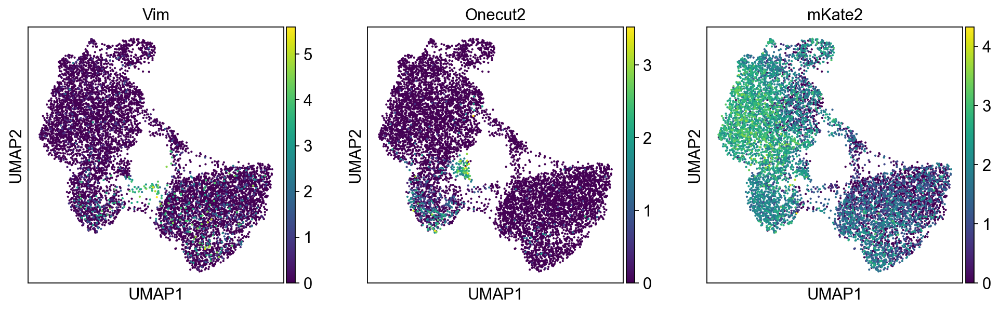

In [84]:
sc.pl.umap(adata, color=[ 'Vim', 'Onecut2', 'mKate2', ])#'Ikbsr-FLAG' 'Sox11',

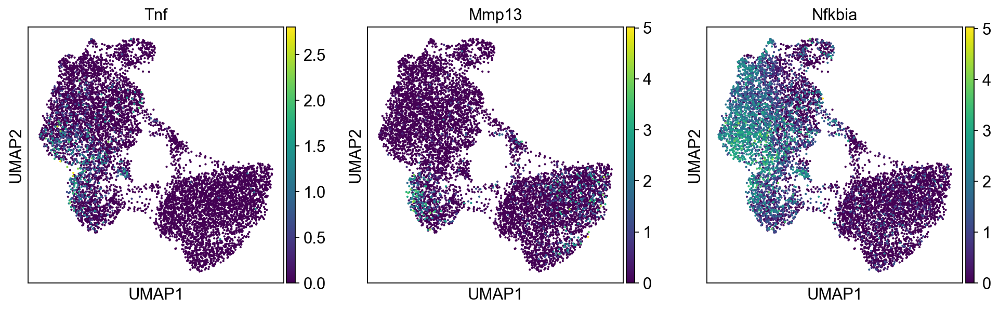

computing score 'score'
    finished: added
    'score', score of gene set (adata.obs).
    349 total control genes are used. (0:00:00)


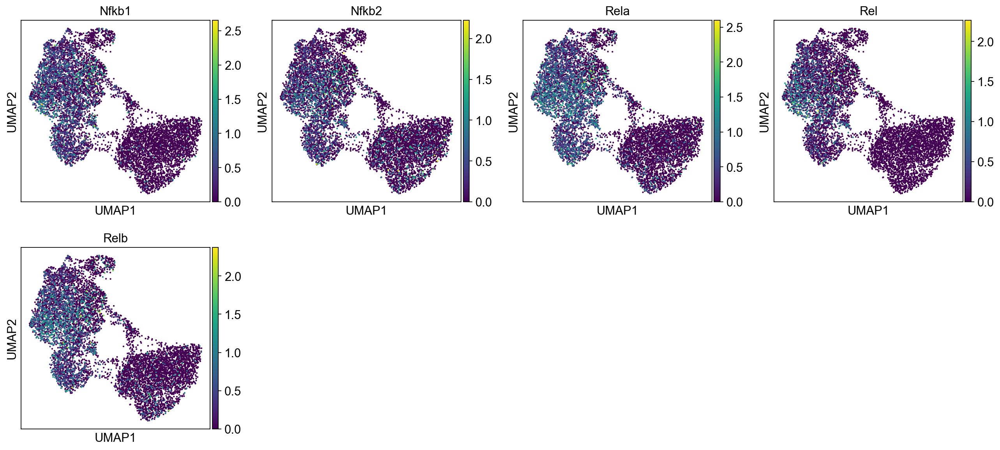

In [85]:
#NFkB targets
nfkb = ['Tnf', 'Mmp13','Nfkbia']
nfkball = ['Tnf', 'Mmp13', 'Nfkbia', 'Bcl2', 'Bcl2l1', 'Xiap', 'Birc2', 'Il6', 'Birc5', 'Ccnd1', 'Mmp3']
nfkbfactors = ['Nfkb1', 'Nfkb2', 'Rela', 'Rel', 'Relb']
sc.pl.umap(adata,color=nfkb)
sc.tl.score_genes(adata, nfkball)
sc.pl.umap(adata, color=nfkbfactors)

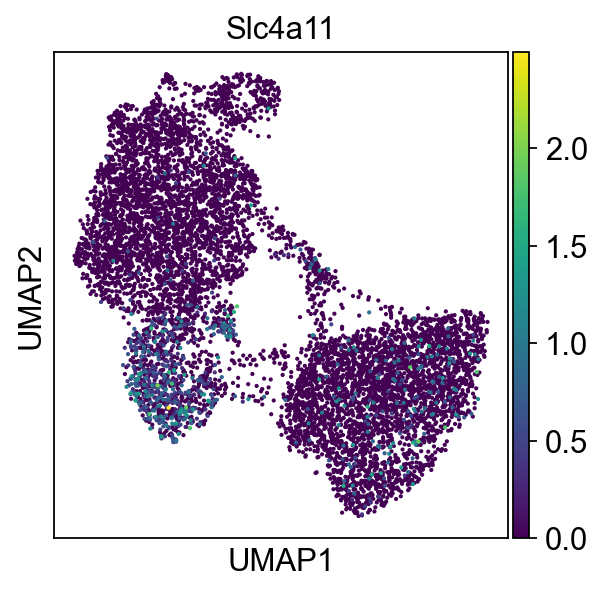

In [86]:
sc.pl.umap(adata, color='Slc4a11')

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    845 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    645 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    746 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    798 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    747 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Ldha-ps2'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    944 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs)

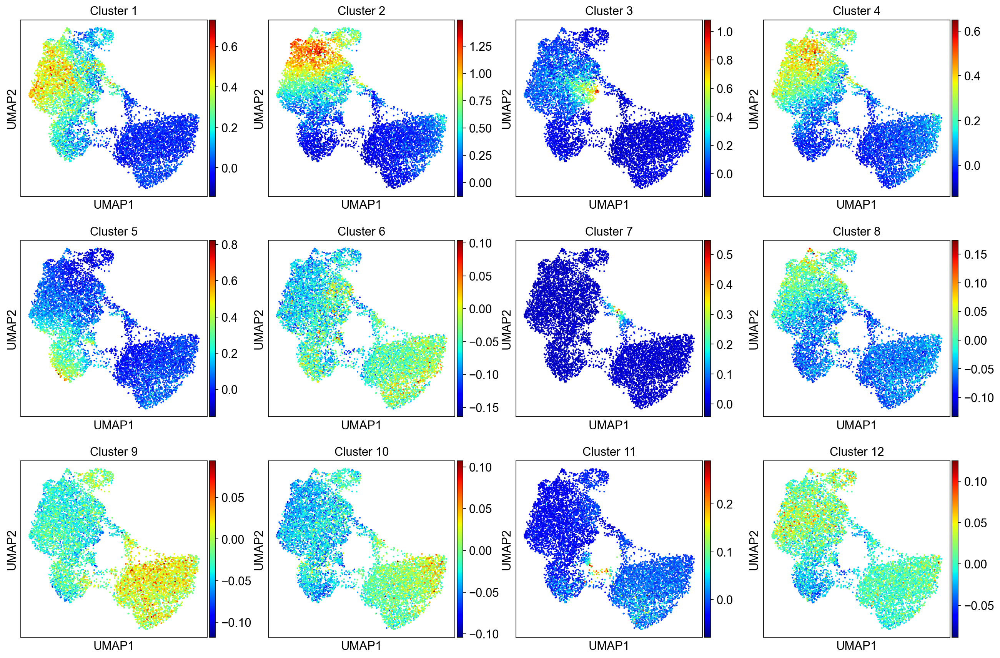

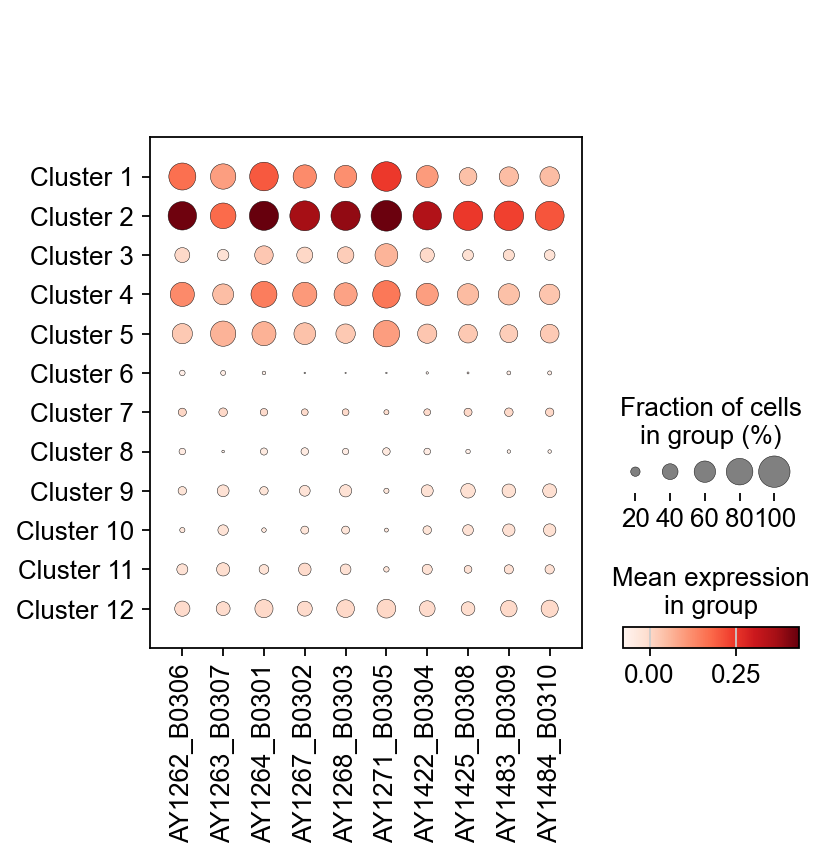

In [87]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata, numgenes=100)

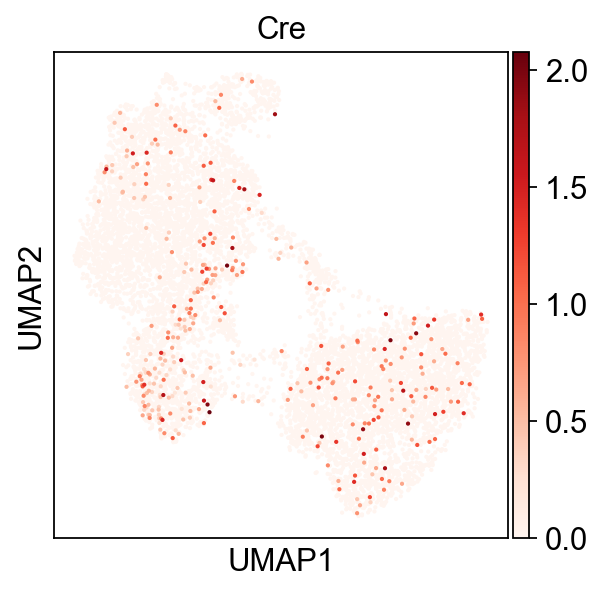

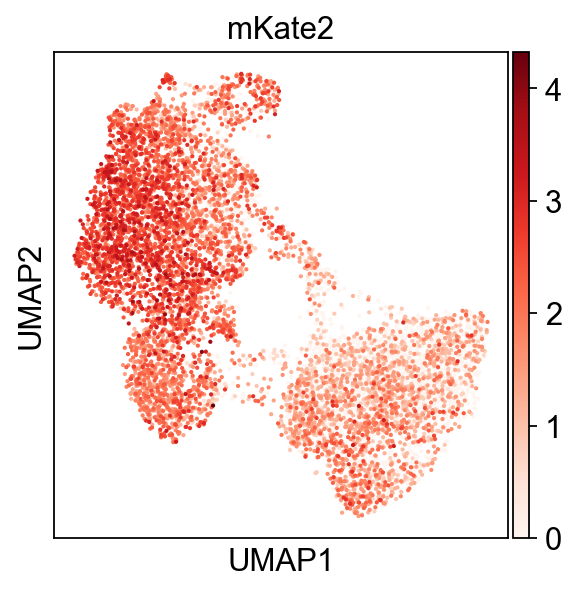

In [88]:
sc.pl.umap(adata, color=['Cre'], cmap='Reds')
sc.pl.umap(adata, color=['mKate2'], cmap='Reds')

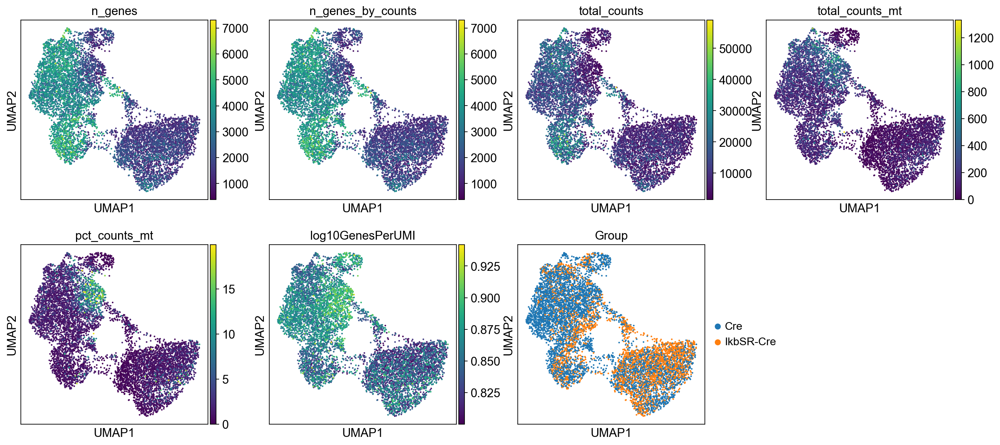

In [89]:
sc.pl.umap(adata, color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI','Group'])

## Clustering the neighborhood graph

running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


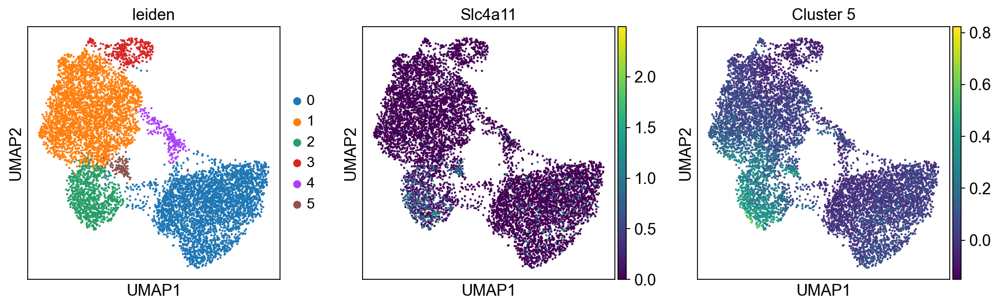

In [90]:
sc.tl.leiden(adata, resolution=.25)
sc.pl.umap(adata, color=['leiden','Slc4a11','Cluster 5'])

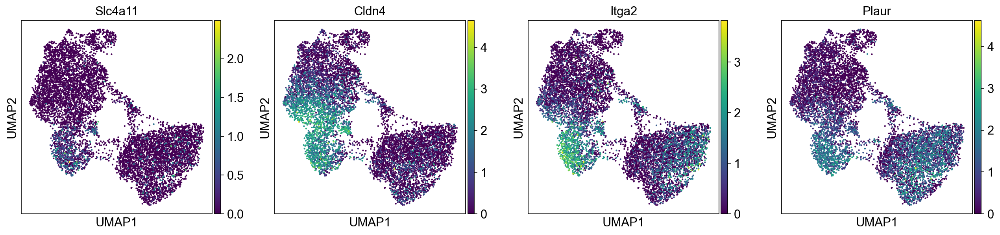

In [91]:
sc.pl.umap(adata, color=['Slc4a11','Cldn4','Itga2', 'Plaur']) #'Tigit',

In [92]:
adata.write_h5ad(results_file)

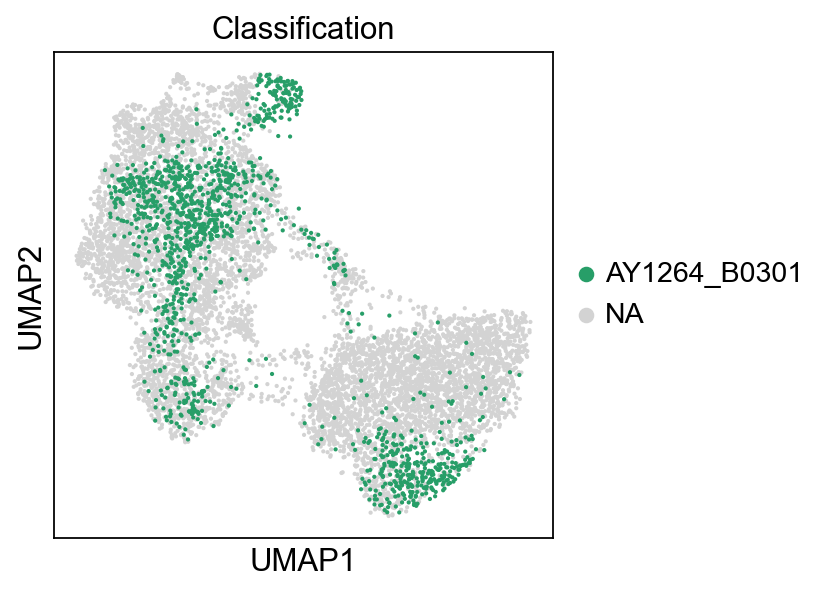

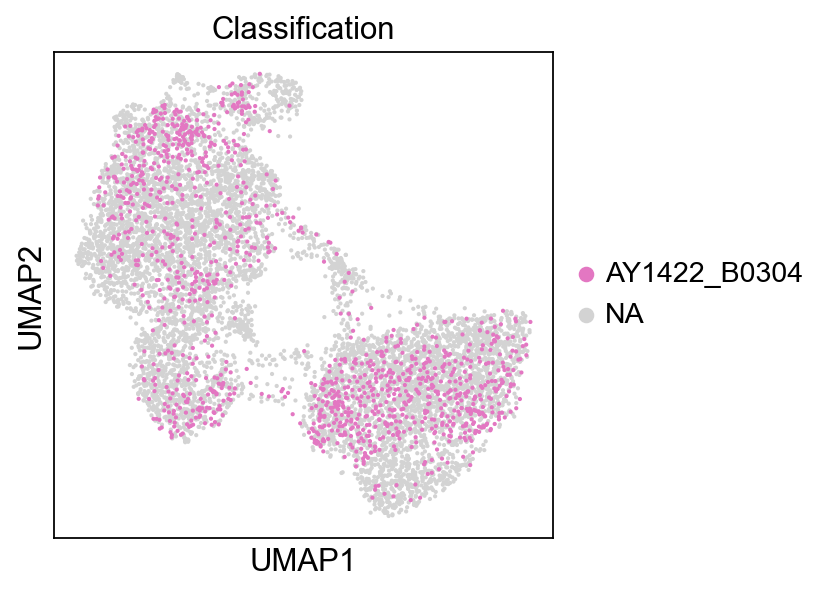

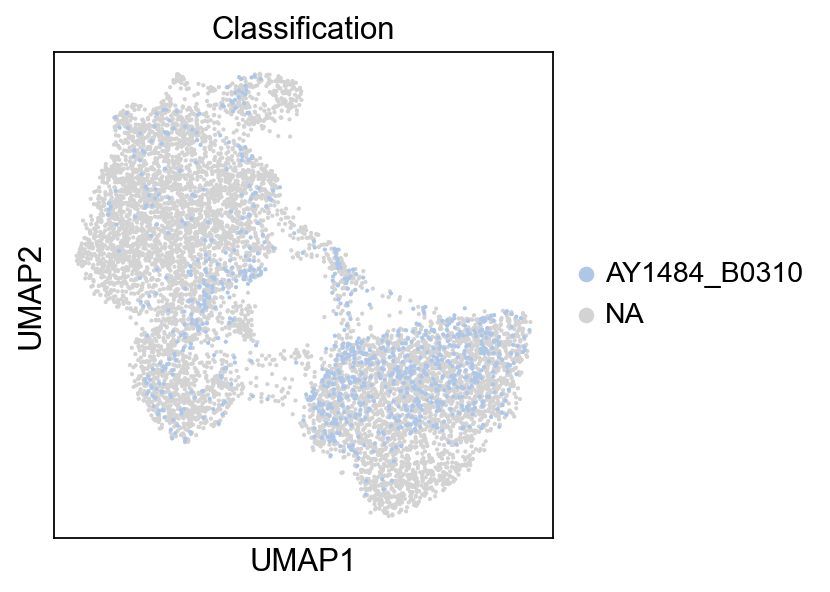

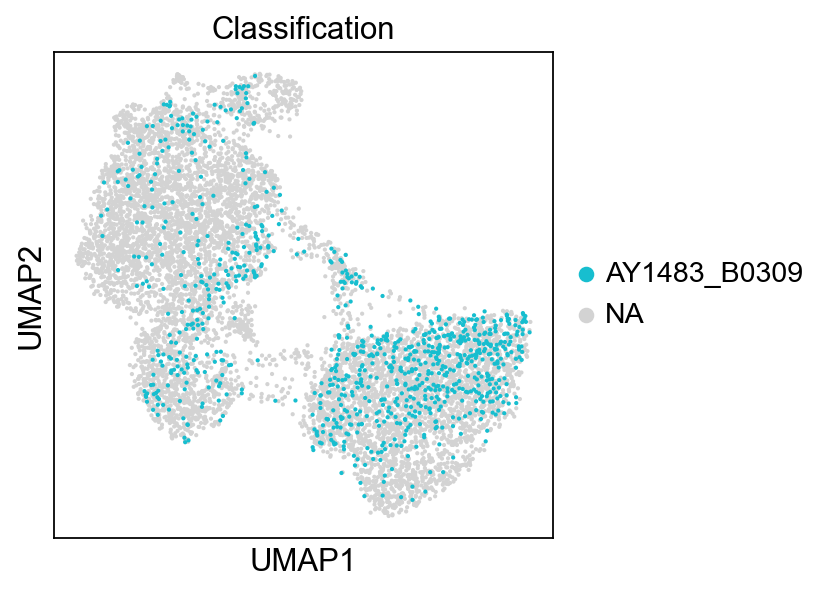

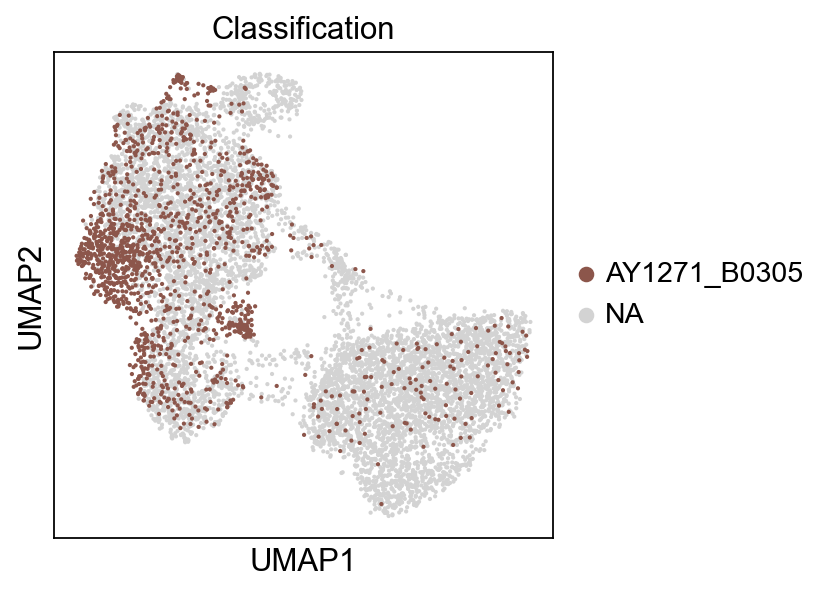

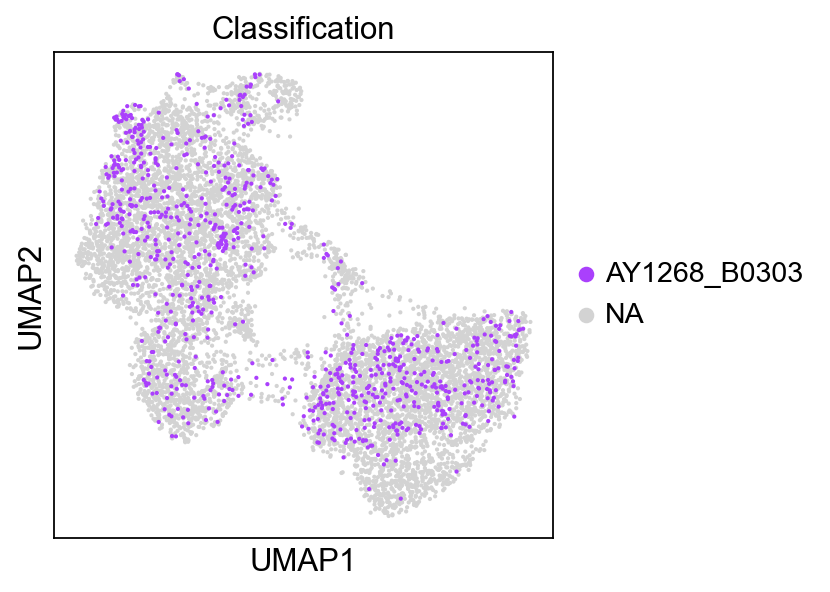

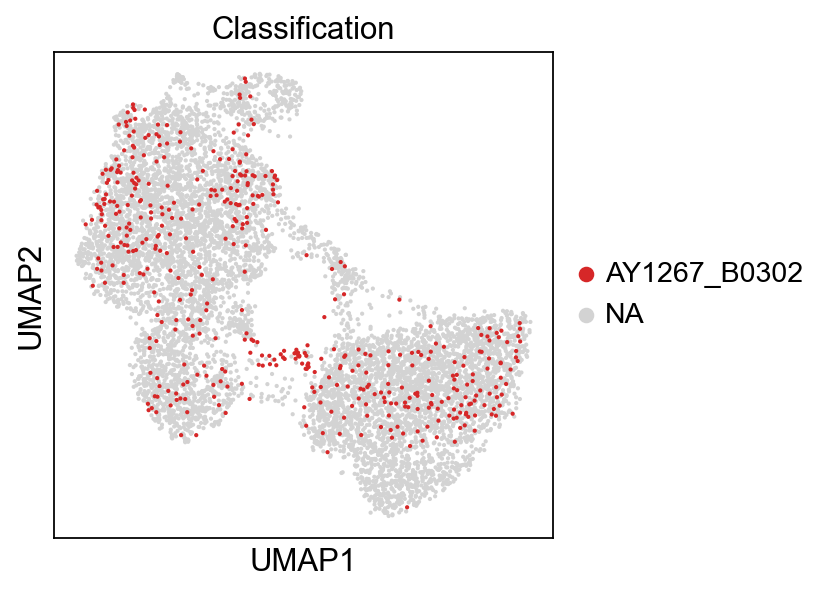

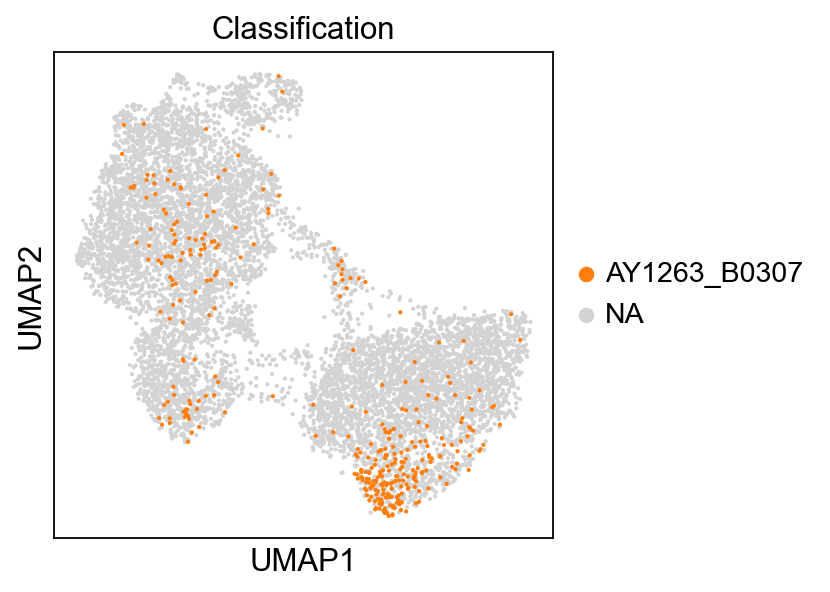

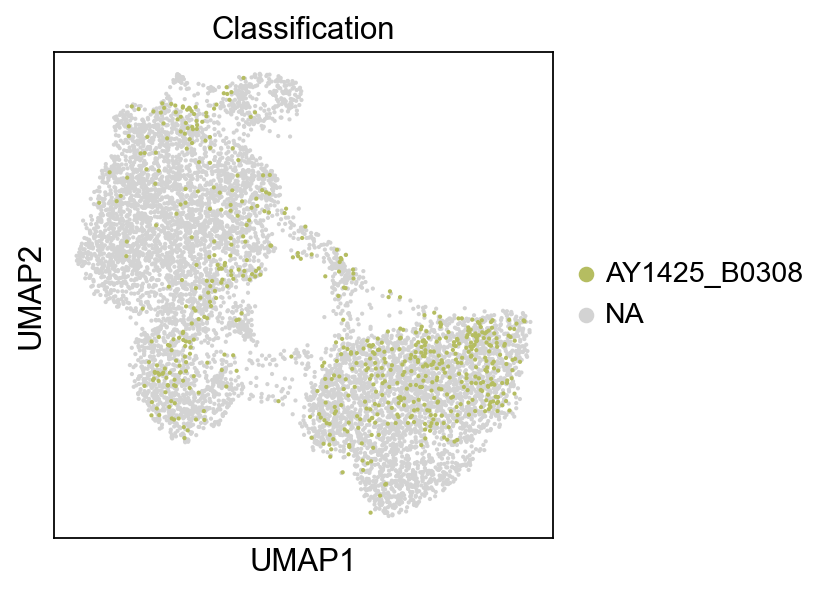

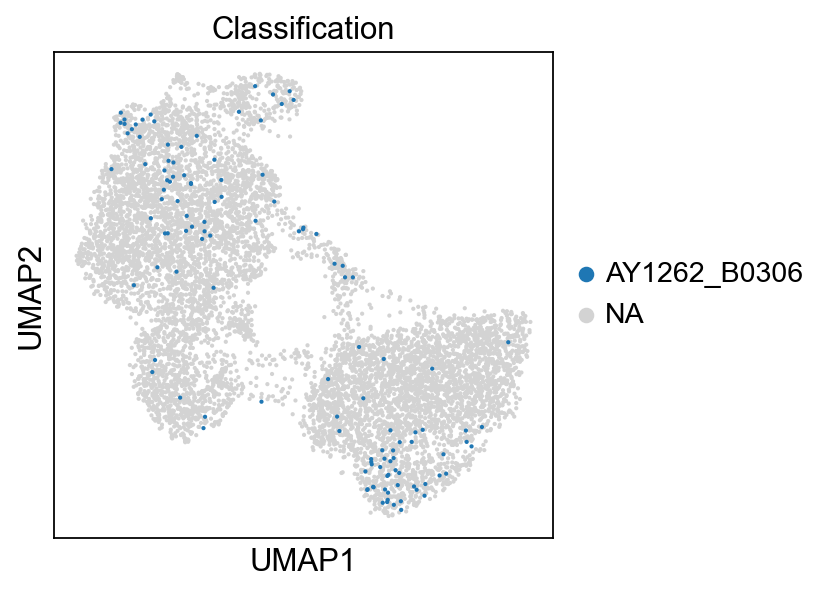

In [93]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

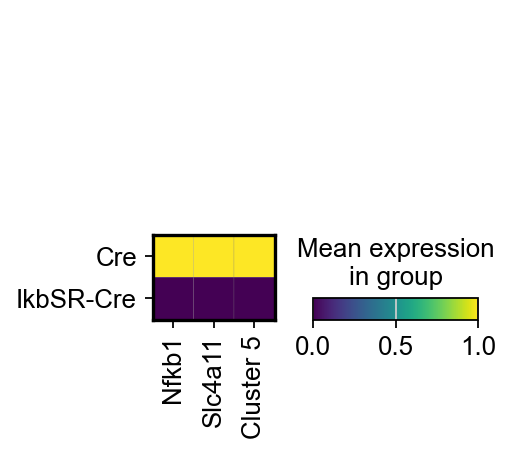

In [94]:
sc.pl.matrixplot(adata, ['Nfkb1','Slc4a11','Cluster 5'], groupby='Group', standard_scale='var')

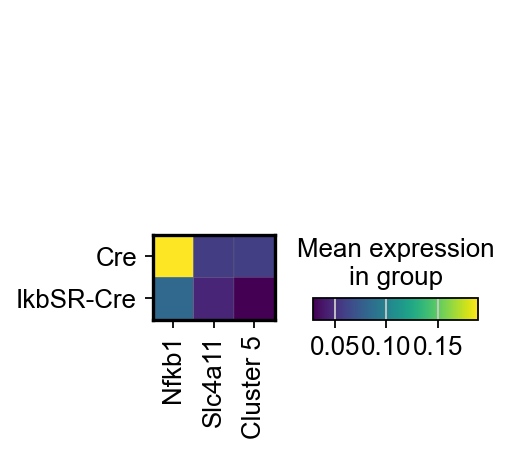

In [95]:
sc.pl.matrixplot(adata, ['Nfkb1','Slc4a11','Cluster 5'], groupby='Group')

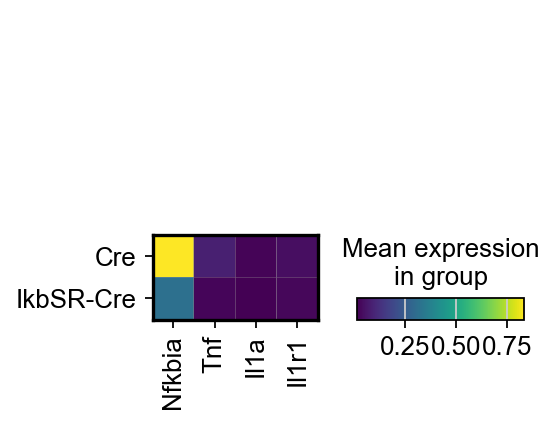

In [96]:
sc.pl.matrixplot(adata, ['Nfkbia','Tnf','Il1a','Il1r1'], groupby='Group')

## Logistic Regression

In [97]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../common_files/genes.joblib')

In [98]:
adata_log = adata[:,adata.var.index.isin(names)]

In [99]:
adata_names = [x for x in adata_log.var.index]

In [100]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [101]:
smartseq = anndata.read_h5ad('../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [102]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [103]:
names = [x for x in names_adata.var.index]

In [104]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')
logreg = LogisticRegression(random_state=250, solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


In [105]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[140,   7,   2,   0,   1,   1,   1,   0,   0,   0,   0,   0],
       [  8,  69,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  1,   1,   0,  67,   0,   0,   0,   7,   1,   0,   0,   0],
       [  1,   0,   3,   0, 179,   1,   0,   4,   0,   0,   0,   1],
       [  0,   0,   0,   1,   0,  33,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  14,   1,   0,   0,   0,   0],
       [  0,   0,   1,   1,   1,   0,   0, 139,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   3,   0,   0,   3,   0,  54,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   0,   0,  41]])

Text(0.5, 295.64444444444445, 'Predicted label')

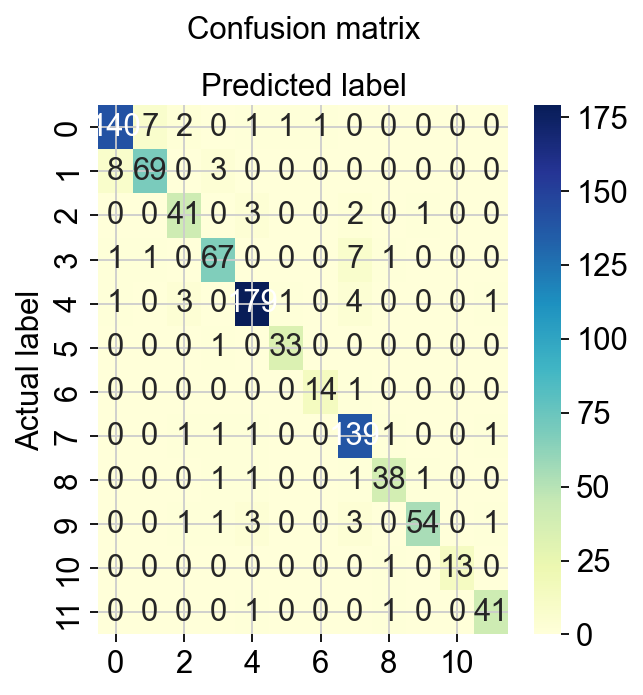

In [106]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [107]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.93      0.92      0.93       152
           2       0.90      0.86      0.88        80
           3       0.85      0.87      0.86        47
           4       0.91      0.87      0.89        77
           5       0.95      0.95      0.95       189
           6       0.94      0.97      0.96        34
           7       0.93      0.93      0.93        15
           8       0.89      0.97      0.92       144
           9       0.90      0.90      0.90        42
          10       0.96      0.86      0.91        63
          11       1.00      0.93      0.96        14
          12       0.93      0.95      0.94        43

    accuracy                           0.92       900
   macro avg       0.92      0.92      0.92       900
weighted avg       0.92      0.92      0.92       900



In [108]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [109]:
class_of_interest = '09'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

np.int64(8)

/home/chanj2/part2a/lib/python3.11/site-packages/sklearn/utils/_plotting.py:176: FutureWarning: `**kwargs` is deprecated and will be removed in 1.9. Pass all matplotlib arguments to `curve_kwargs` as a dictionary instead.
  warnings.warn(


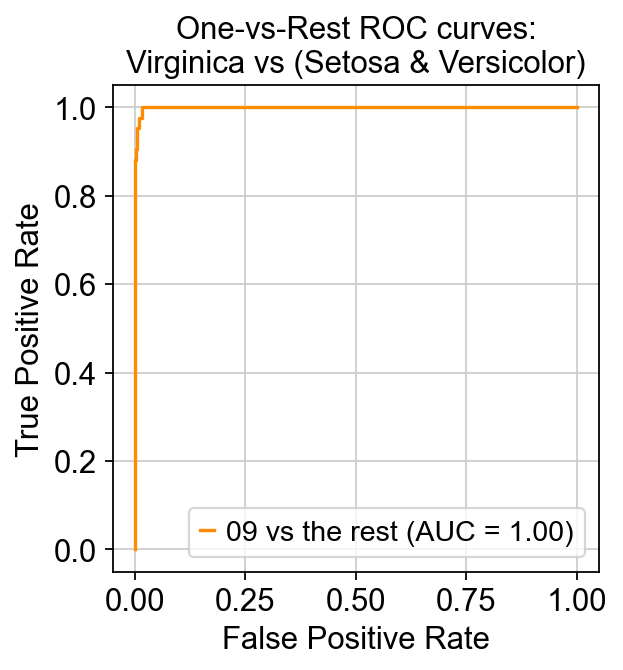

In [110]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [111]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [112]:
map(str,y_pred)

In [113]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [114]:
#results_binary = y_pred
#probs_binary = y_proba

results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,1.844239e-08,1.079385e-04,1.267897e-01,2.158556e-02,1.575118e-06,4.569972e-05,4.285146e-04,8.503645e-01,2.703732e-06,2.679567e-05,2.318573e-05,6.237898e-04,0.850364,0
1,01,01,9.999918e-01,1.890631e-07,1.024357e-08,7.044999e-08,8.892978e-08,9.961711e-07,6.694383e-06,2.493352e-10,2.140121e-09,5.858889e-09,9.702652e-08,6.266484e-09,0.999992,1
2,08,08,4.506927e-09,2.967443e-07,4.012847e-07,2.241340e-06,7.202310e-06,9.080664e-07,3.567419e-05,9.998761e-01,9.380262e-06,6.091710e-05,6.336967e-06,5.376370e-07,0.999876,1
3,05,10,4.540586e-08,7.221264e-06,2.703583e-05,3.524212e-07,5.438817e-01,6.085215e-04,6.931353e-05,4.205936e-05,3.659710e-04,4.539826e-01,7.446424e-05,9.407138e-04,0.543882,0
4,08,08,7.466882e-08,4.524979e-07,6.643729e-08,5.069989e-06,1.178730e-05,1.421760e-06,1.222161e-04,9.995929e-01,2.333514e-04,1.975593e-05,6.703168e-06,6.222496e-06,0.999593,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,2.741324e-04,1.586246e-07,3.161208e-06,3.925985e-05,9.898739e-01,4.807211e-03,3.273039e-04,2.294702e-03,6.596439e-04,1.541872e-03,1.664906e-04,1.215234e-05,0.989874,1
896,05,05,2.861344e-10,3.538958e-07,2.288370e-07,1.742920e-07,9.999857e-01,6.828169e-06,3.536465e-07,5.862595e-10,1.201549e-07,2.325310e-07,5.078655e-06,8.988108e-07,0.999986,1
897,08,08,2.591943e-06,6.120942e-05,8.654819e-06,1.389443e-02,5.536461e-08,4.784143e-06,1.004043e-04,9.846275e-01,1.073175e-03,1.765659e-04,2.197356e-05,2.867569e-05,0.984627,1
898,05,05,7.481340e-11,2.014232e-07,4.620438e-06,8.220940e-12,9.999936e-01,6.544815e-08,3.093801e-07,5.396427e-07,7.891025e-08,7.534787e-08,3.673308e-07,1.227875e-07,0.999994,1


In [115]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.36-0.88,0.359109,0.876150,0.612403
1,0.88-0.98,0.876150,0.980993,0.890625
2,0.98-1.0,0.980993,0.996559,0.953488
3,1.0-1.0,0.999022,0.999880,0.996109


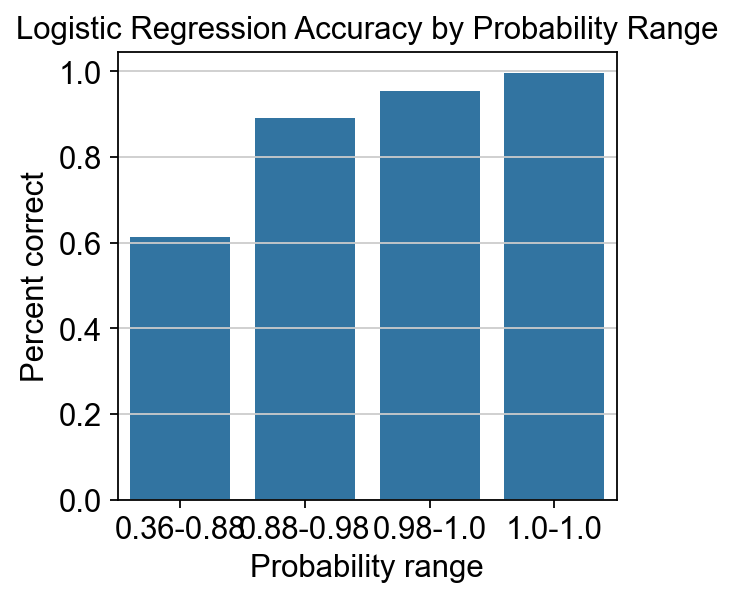

In [116]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [117]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

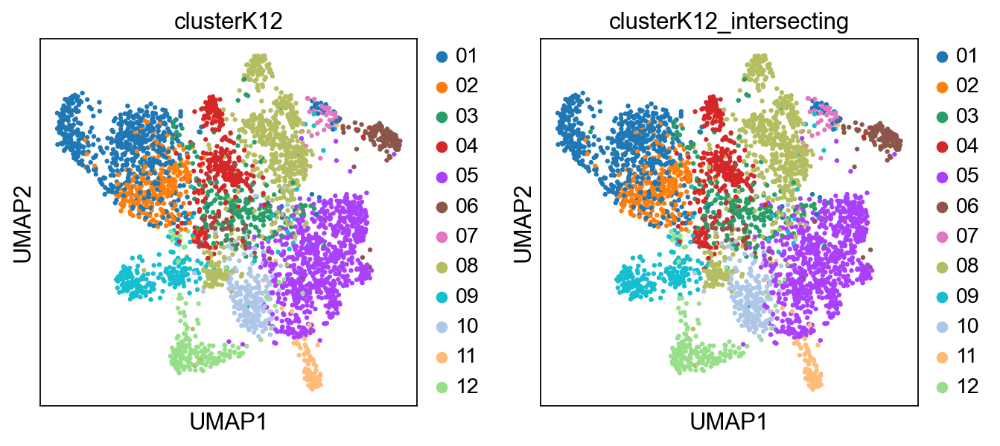

In [118]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [119]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [120]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.98

In [121]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,1.252443e-12,1.300158e-10,9.706537e-11,2.887438e-13,1.215031e-08,2.723651e-11,4.254636e-09,1.025568e-11,1.774145e-10,8.373082e-11,1.000000e+00,1.278366e-09,1.000000
1,12,2.070501e-10,2.350123e-11,9.031596e-11,2.538751e-09,2.636555e-09,9.135007e-07,1.663221e-08,4.422211e-08,9.696548e-08,3.922559e-07,8.939361e-09,9.999985e-01,0.999999
2,05,8.734030e-04,2.125944e-07,3.611152e-04,1.594661e-07,9.987409e-01,1.865085e-05,6.857323e-07,1.162652e-10,3.156076e-07,9.249904e-07,8.772873e-07,2.722453e-06,0.998741
3,10,4.931776e-07,3.430253e-07,4.524698e-07,1.836833e-03,6.762912e-07,9.398298e-06,6.912223e-06,2.367460e-03,7.722570e-06,9.957496e-01,4.034793e-06,1.604849e-05,0.995750
4,01,9.999964e-01,5.749128e-09,1.418360e-06,1.616036e-06,1.053815e-08,1.022580e-07,7.202144e-08,1.980705e-10,1.787783e-10,7.564136e-09,3.201420e-07,1.713784e-08,0.999996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,2.995286e-10,8.788600e-08,6.296245e-09,1.231612e-07,1.253913e-08,6.813957e-09,5.379911e-07,9.999961e-01,2.888892e-06,1.427490e-07,5.477258e-08,8.592011e-09,0.999996
3596,09,7.003502e-08,2.406483e-07,1.121898e-07,7.014456e-08,1.030423e-06,5.412747e-08,1.241023e-06,3.491895e-04,9.996446e-01,2.270386e-07,3.059420e-06,1.036171e-07,0.999645
3597,08,3.586323e-08,4.325646e-06,8.618380e-08,4.541911e-05,2.522870e-08,5.764482e-08,7.666553e-06,9.998397e-01,9.657352e-05,2.886777e-06,2.275881e-06,9.112128e-07,0.999840
3598,08,7.492762e-09,2.215599e-06,2.816793e-06,2.163609e-06,4.006866e-04,2.147052e-07,1.116819e-05,9.995498e-01,9.479700e-06,1.543421e-05,4.214224e-06,1.783451e-06,0.999550


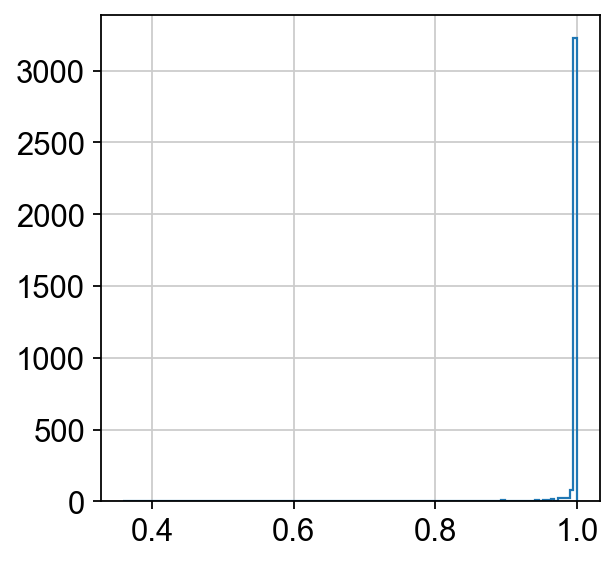

In [122]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## Evaluate LogisticRegression

In [123]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [124]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [125]:
adata_log_ordered.var.index

Index(['Cdc45', 'Klf6', 'Fer', 'Brat1', 'Ccnd2', 'Scnn1g', 'Mnt', 'Tpd52l1',
       'Ckmt1', 'Tmprss2',
       ...
       '5830408C22Rik', 'Gm5905', 'Gm42031', 'Gm9908', 'Gm45752', 'Gm7730',
       'Gm42047', 'Gm7390', 'AC160637.1', 'Gm3776'],
      dtype='object', length=3987)

In [126]:
y_pred = logreg.predict(adata_log_ordered.X)

In [127]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/tmp/ipykernel_1968340/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [128]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

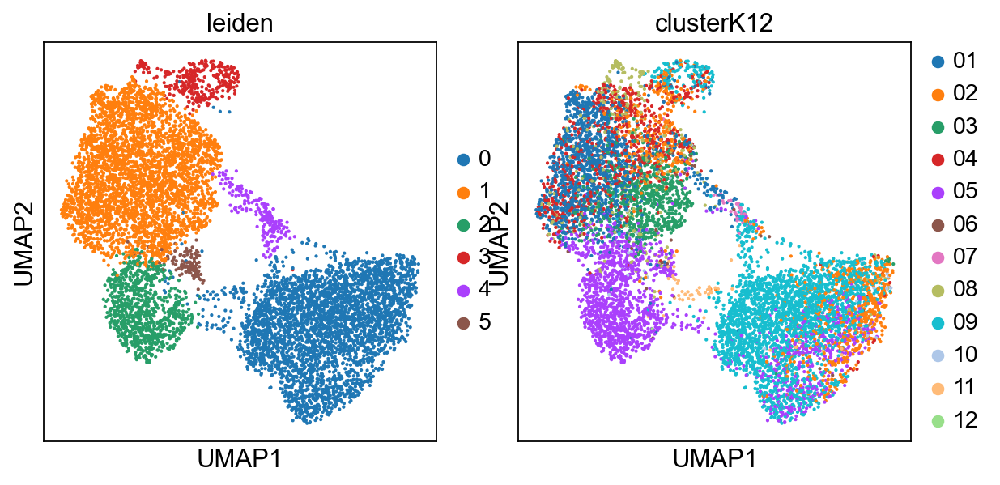

In [129]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

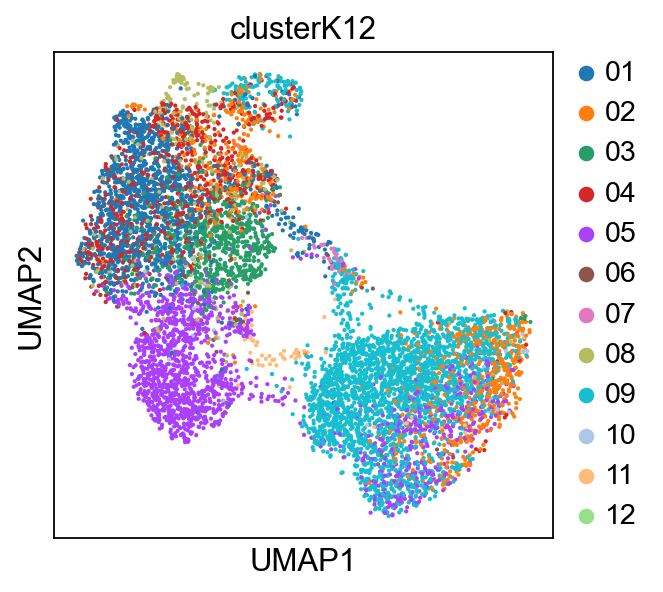

In [130]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

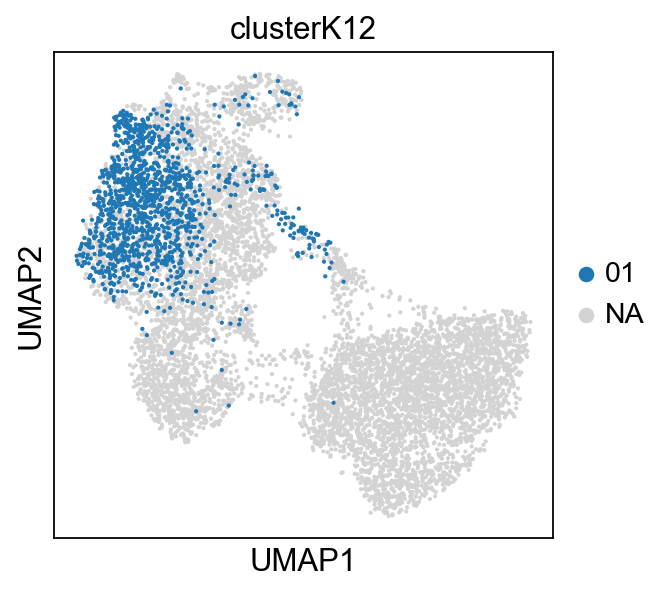

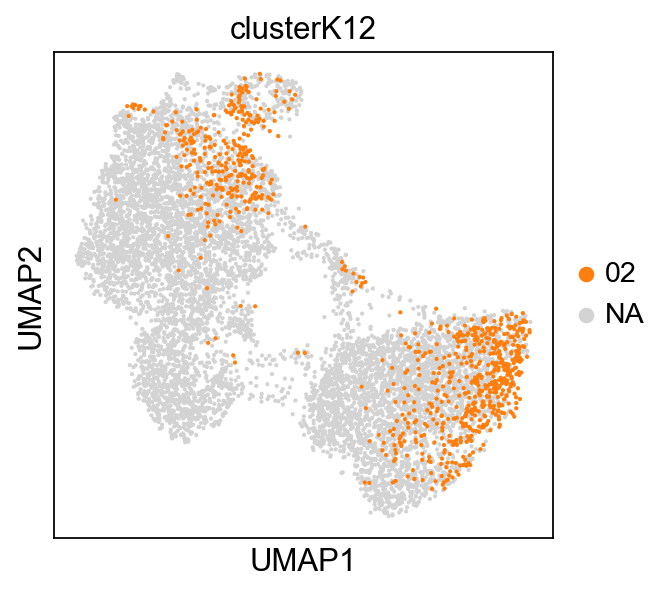

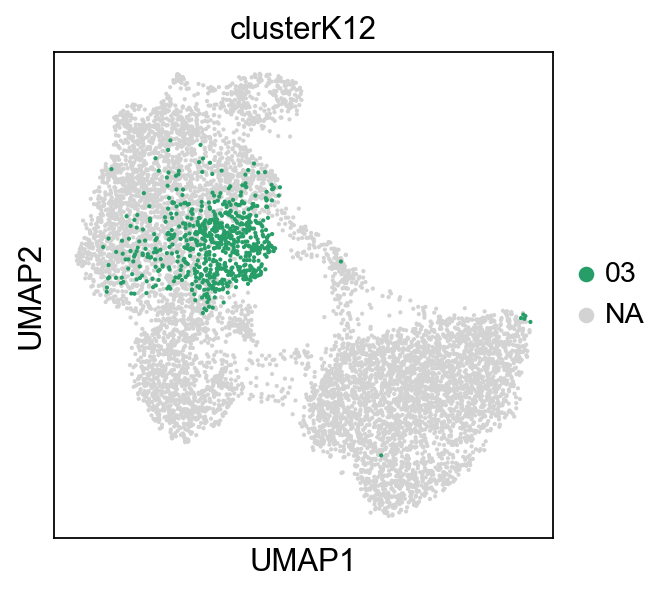

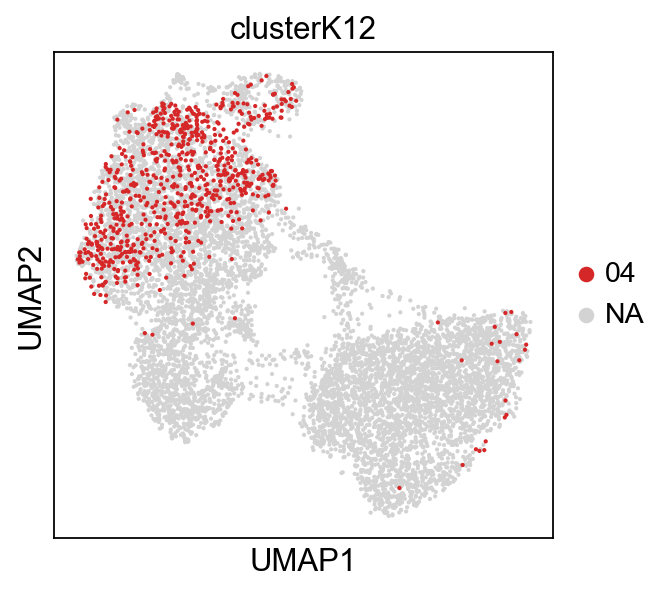

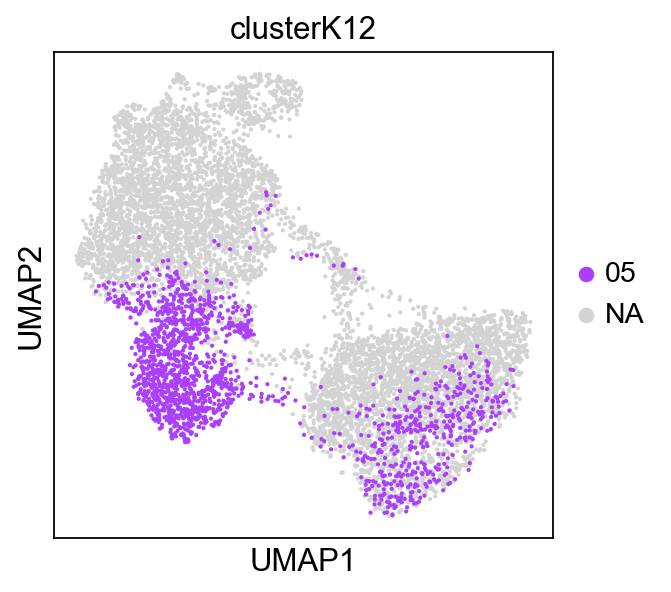

...

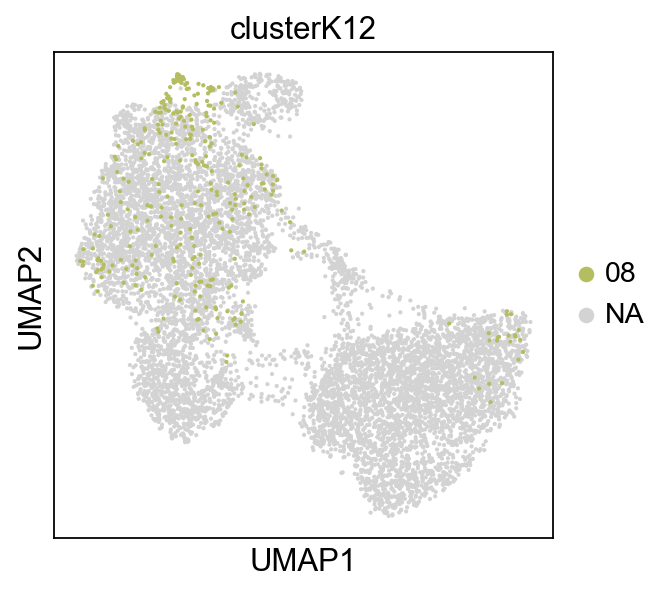

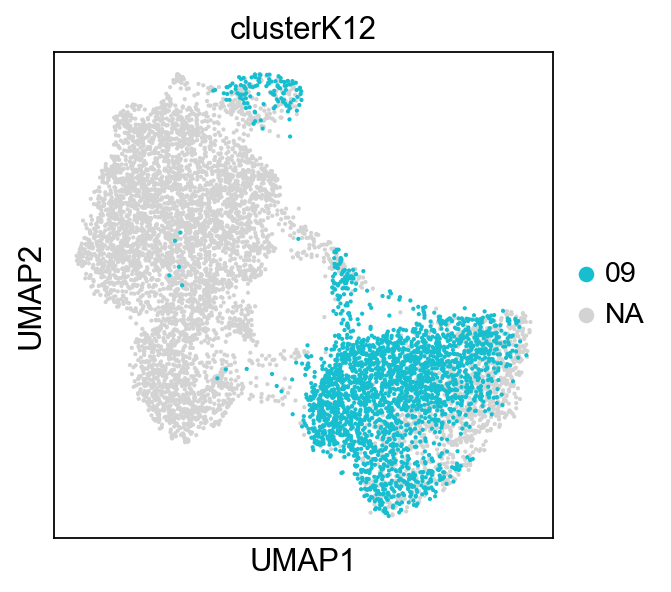

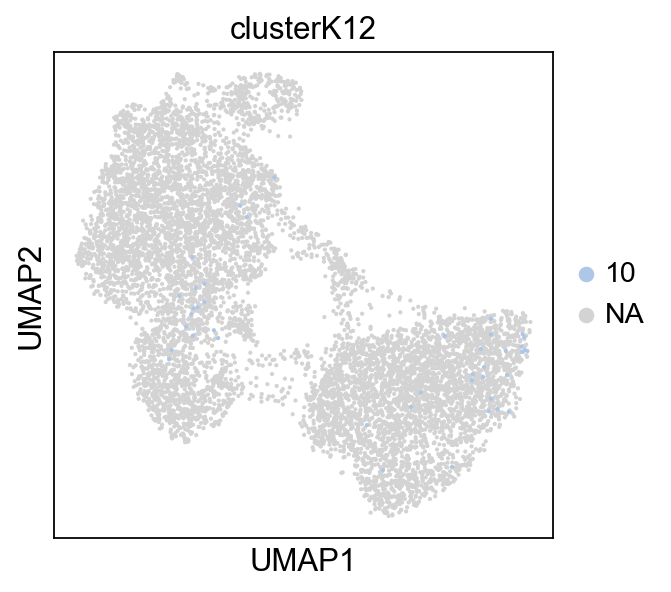

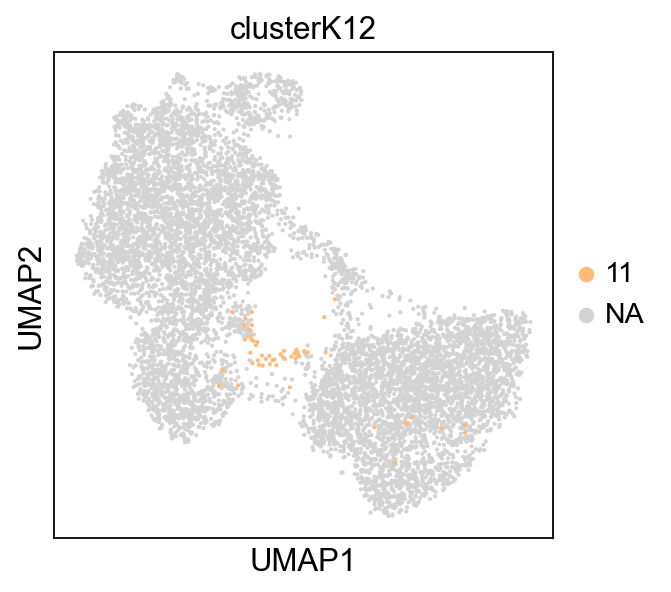

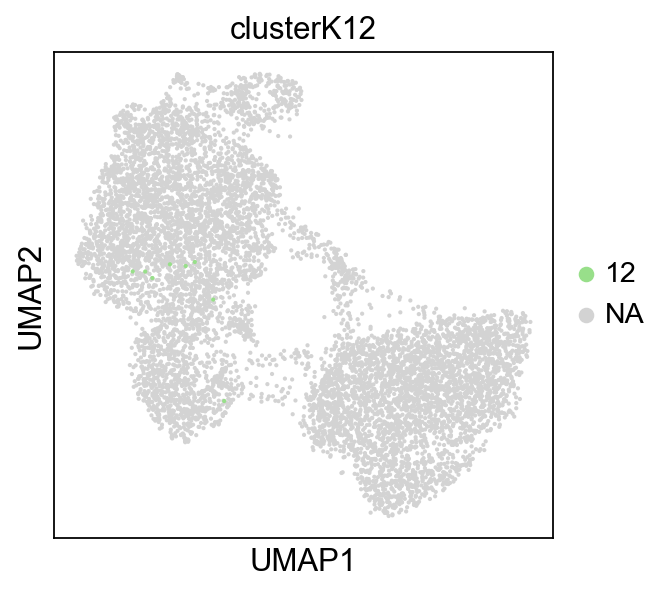

In [131]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

In [132]:
# bug fix
adata_log_ordered.uns['log1p']['base'] = None

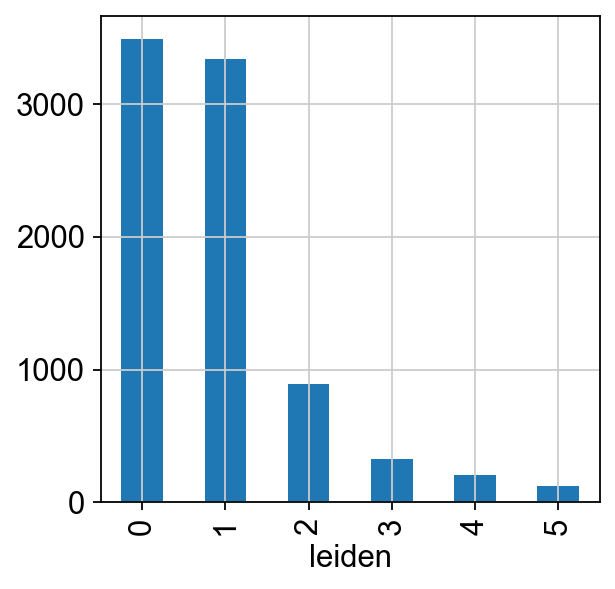

In [133]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

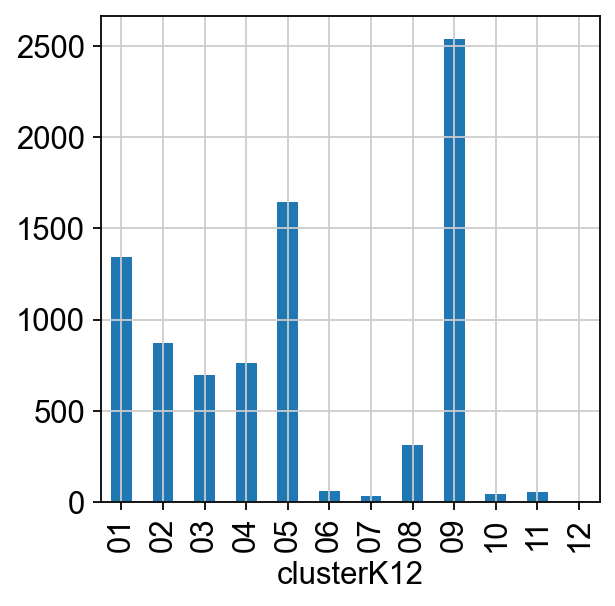

In [134]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

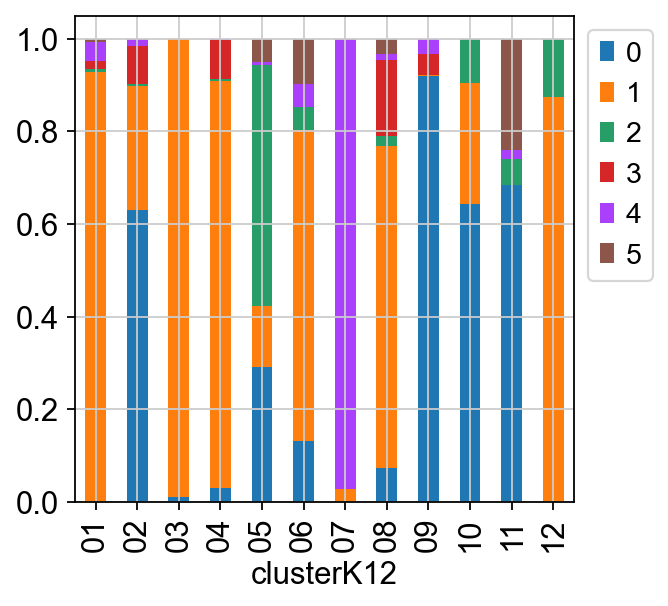

In [135]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [136]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,02,0.008360,8.262065e-01,0.000132,9.334663e-02,8.009467e-07,0.001401,0.001819,1.355834e-02,0.053213,0.000683,0.000726,0.000553,0.826207
1,09,0.003289,4.009897e-02,0.009340,1.010304e-02,5.499904e-03,0.004907,0.005677,1.336797e-02,0.876629,0.011961,0.014124,0.005003,0.876629
2,02,0.002902,6.987955e-01,0.022286,6.328157e-02,1.170710e-02,0.015163,0.015859,2.028428e-02,0.052755,0.051101,0.014756,0.031110,0.698796
3,09,0.000327,1.884337e-01,0.001556,1.370369e-03,7.981778e-02,0.025034,0.014254,1.299555e-02,0.606422,0.008970,0.032174,0.028645,0.606422
4,01,0.957447,3.986909e-07,0.015001,7.356918e-03,2.268266e-03,0.001403,0.002398,4.963027e-03,0.000014,0.002284,0.001224,0.005641,0.957447
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8362,04,0.409386,1.076027e-03,0.000055,5.646264e-01,4.529033e-07,0.000306,0.002313,2.049067e-02,0.000009,0.001080,0.000267,0.000391,0.564626
8363,05,0.000017,4.500034e-07,0.000007,3.930199e-07,9.992604e-01,0.000077,0.000034,1.487556e-07,0.000145,0.000111,0.000312,0.000035,0.999260
8364,05,0.000020,8.720107e-04,0.000186,2.170386e-05,9.712501e-01,0.000444,0.001086,1.980718e-04,0.020097,0.000979,0.004631,0.000216,0.971250
8365,08,0.003045,5.072719e-02,0.005154,1.133733e-01,7.671135e-06,0.002540,0.010521,8.025384e-01,0.000429,0.007389,0.001823,0.002452,0.802538


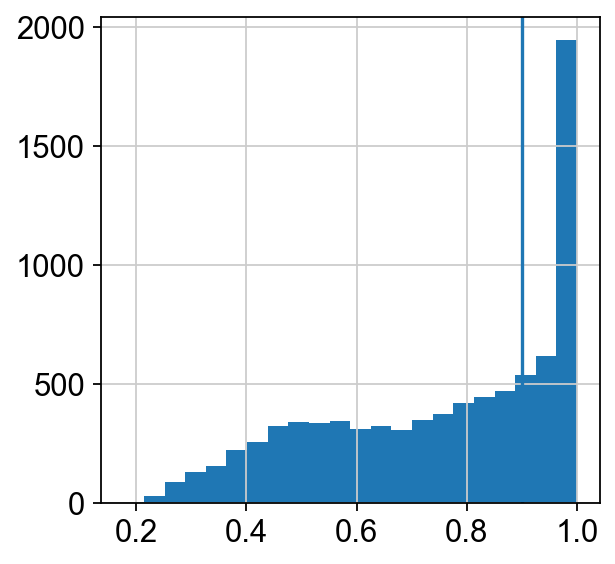

In [137]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [138]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.18-0.47,0.175,0.473
1,0.47-0.6,0.473,0.605
2,0.6-0.74,0.605,0.741
3,0.74-0.85,0.741,0.850
4,0.85-0.94,0.850,0.936
5,0.94-0.99,0.936,0.993
6,0.99-1.0,0.993,1.000


In [139]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/tmp/ipykernel_1968340/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in

In [140]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCAAGCTCCGAC-1       02
AAACCCAAGGAATCGC-1       09
AAACCCACAACAAGAT-1    other
AAACCCACACAGTACT-1    other
AAACCCACAGAGGGTT-1       01
                      ...  
TTTGTTGGTCGTGATT-1    other
TTTGTTGGTGGCCTCA-1       05
TTTGTTGTCCCGTTCA-1       05
TTTGTTGTCGAGCCTG-1       08
TTTGTTGTCTAGCAAC-1    other
Name: clusterK12_stringent, Length: 8367, dtype: object

In [141]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

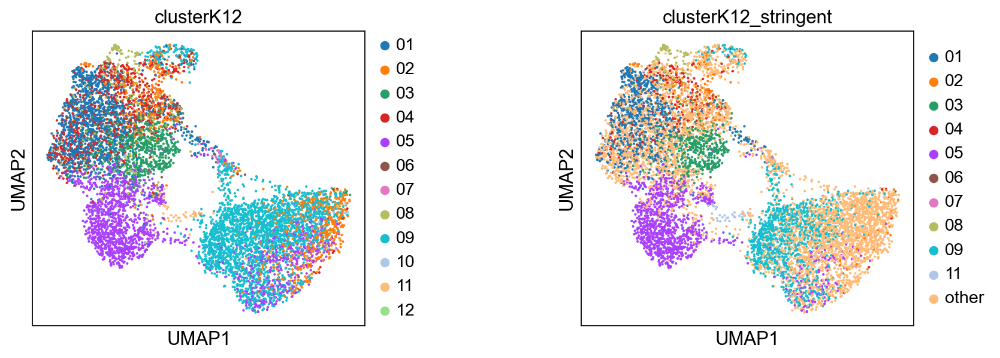

In [142]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

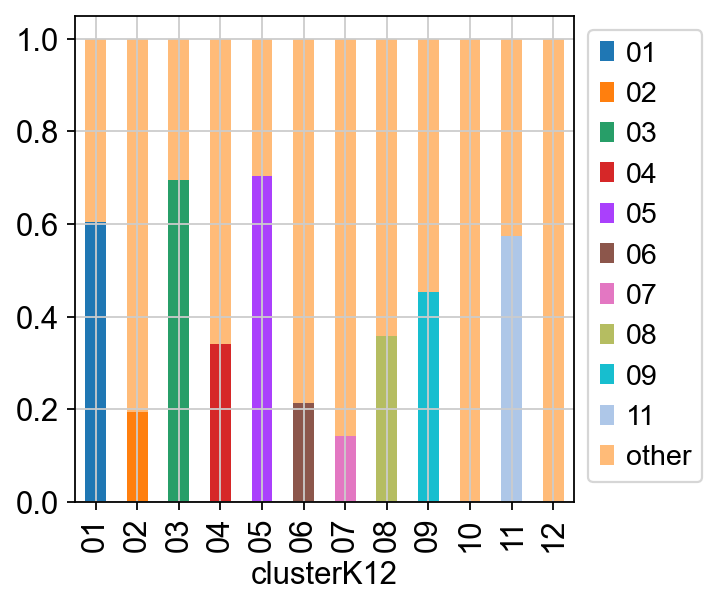

In [143]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

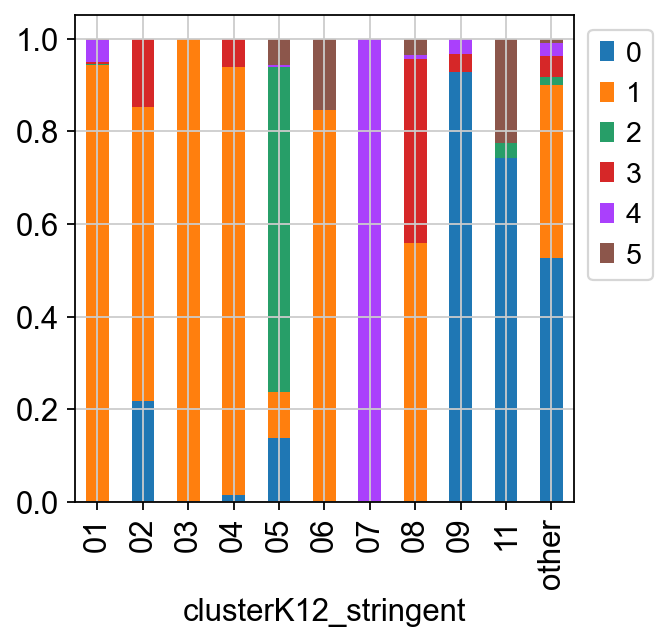

In [144]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

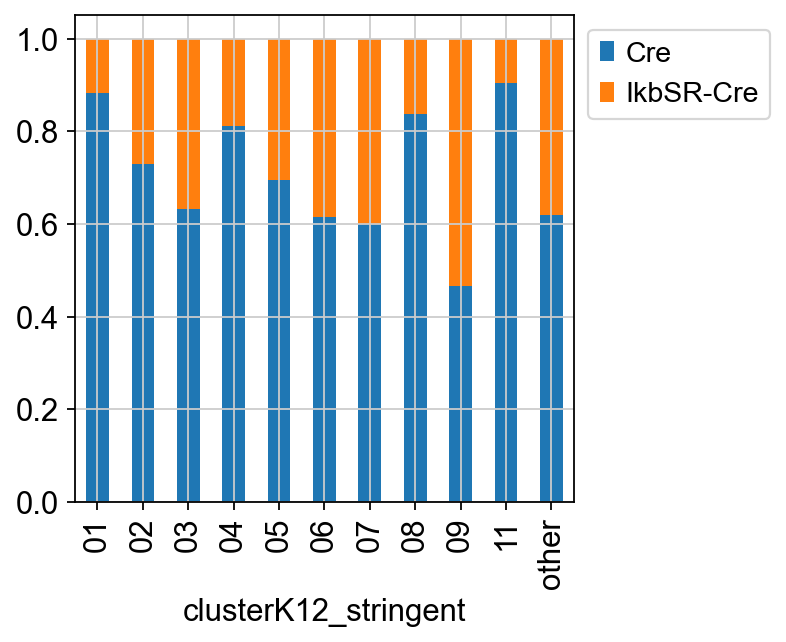

In [145]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Group'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

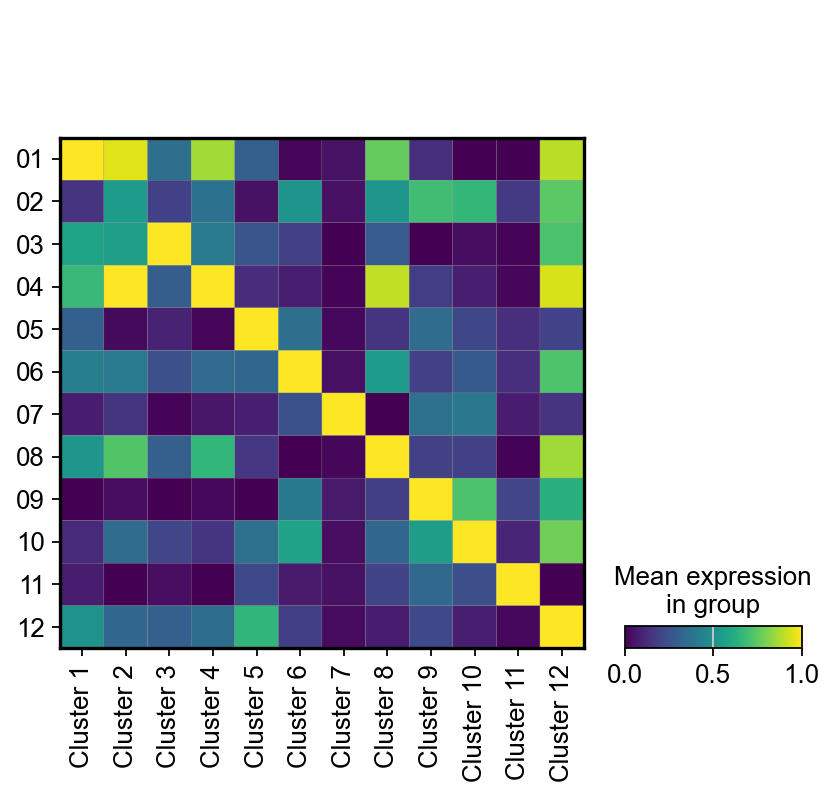

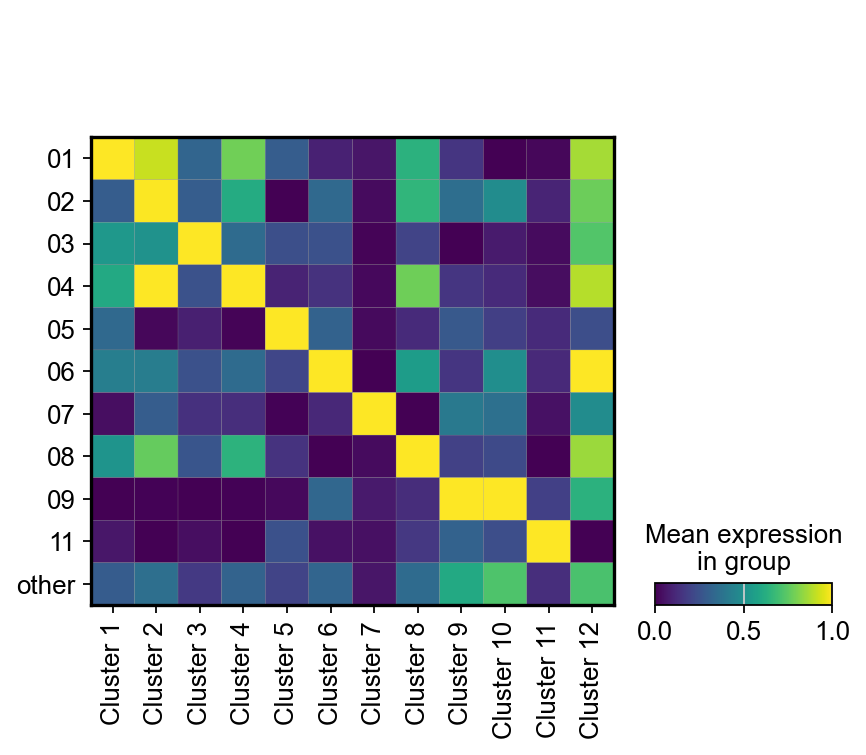

In [146]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

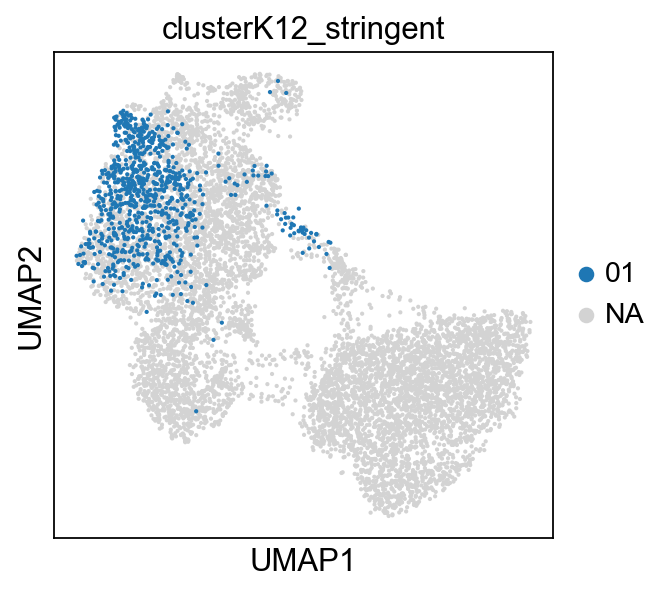

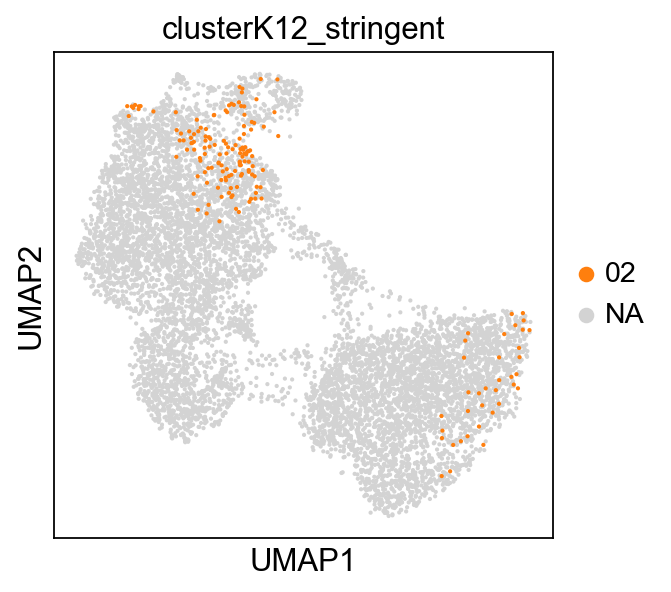

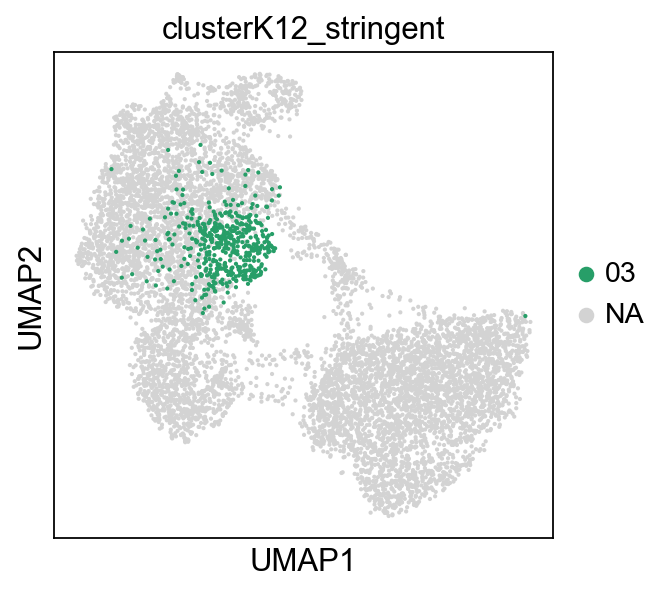

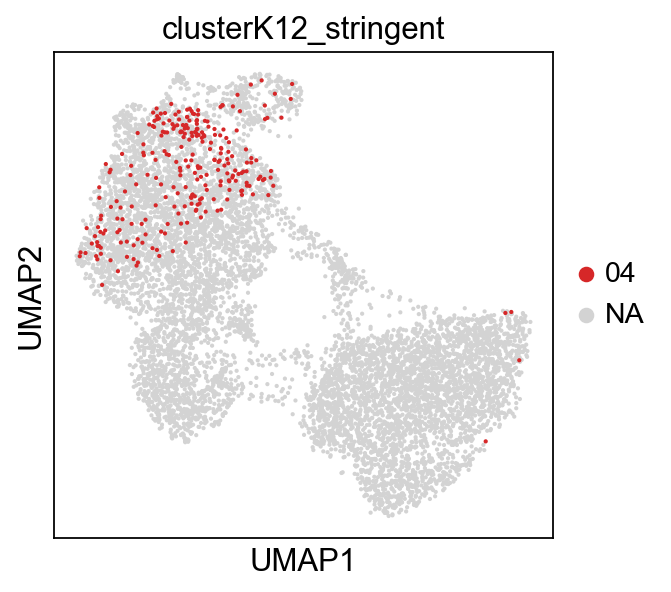

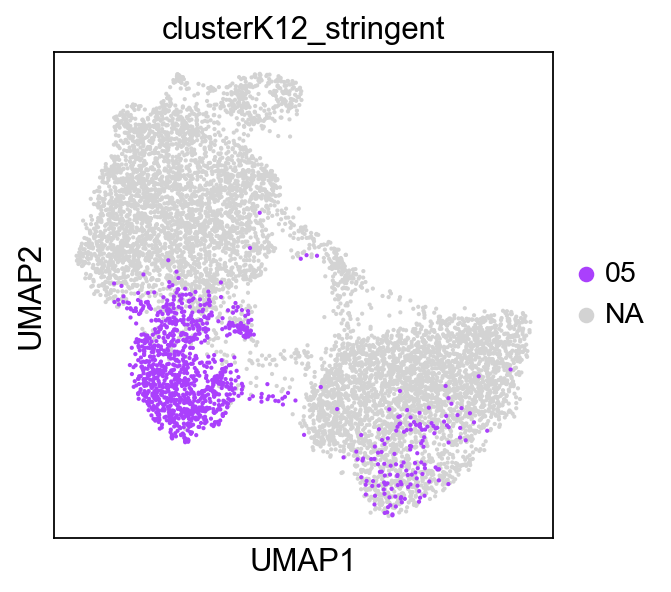

...

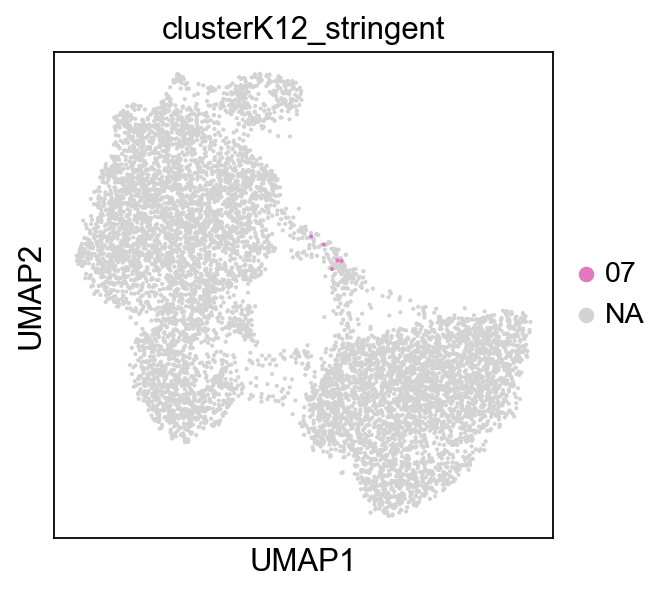

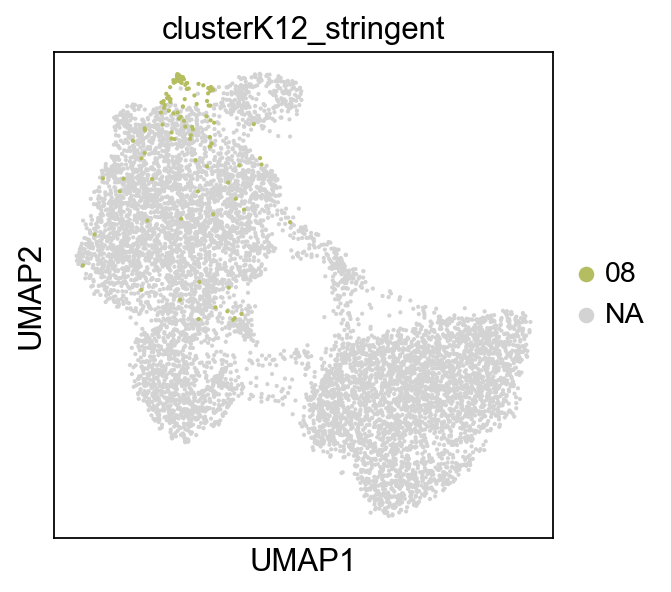

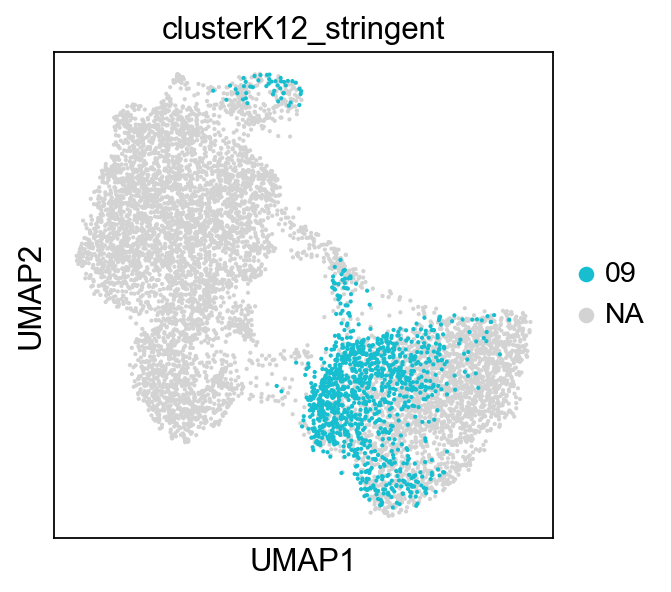

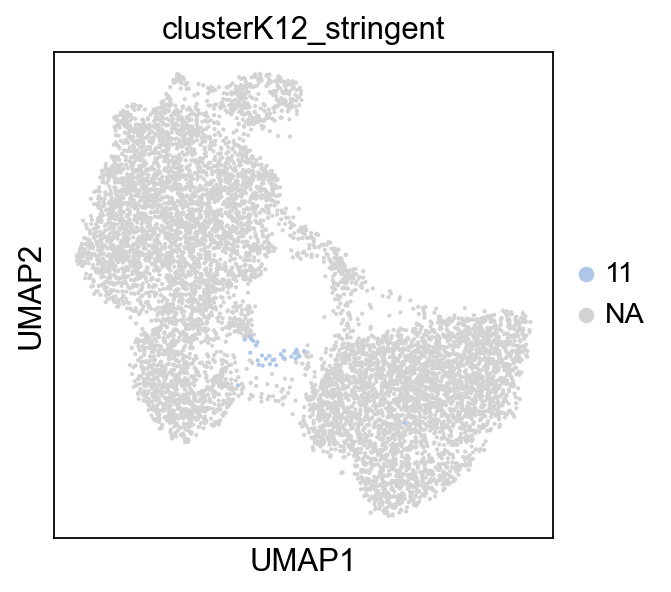

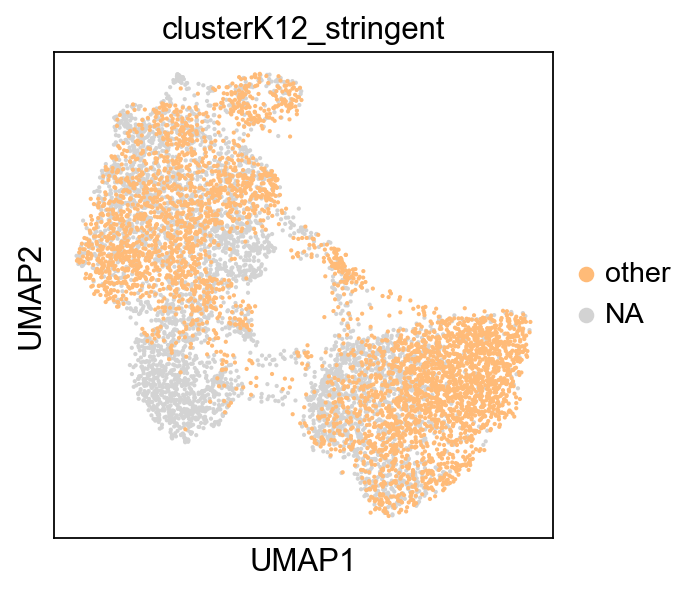

In [147]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [148]:
adata_log_ordered.obs.clusterK12.value_counts()

clusterK12
09    2539
05    1642
01    1345
02     872
04     762
03     697
08     310
06      61
11      54
10      42
07      35
12       8
Name: count, dtype: int64

In [149]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#sc.pl.violin(adata_log_ordered, cancerCell, groupby='clusterK12')

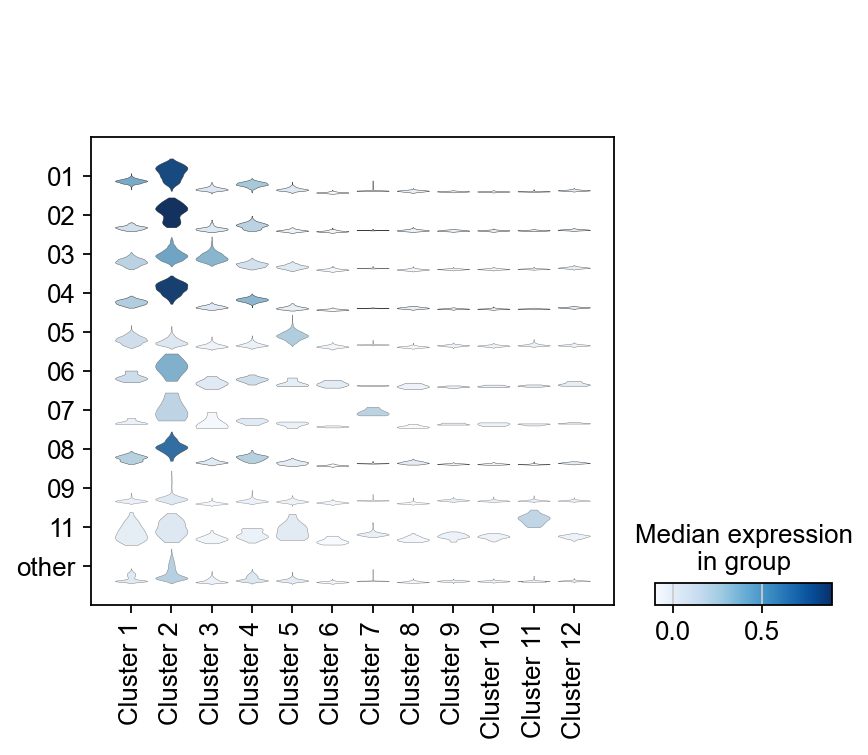

In [150]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

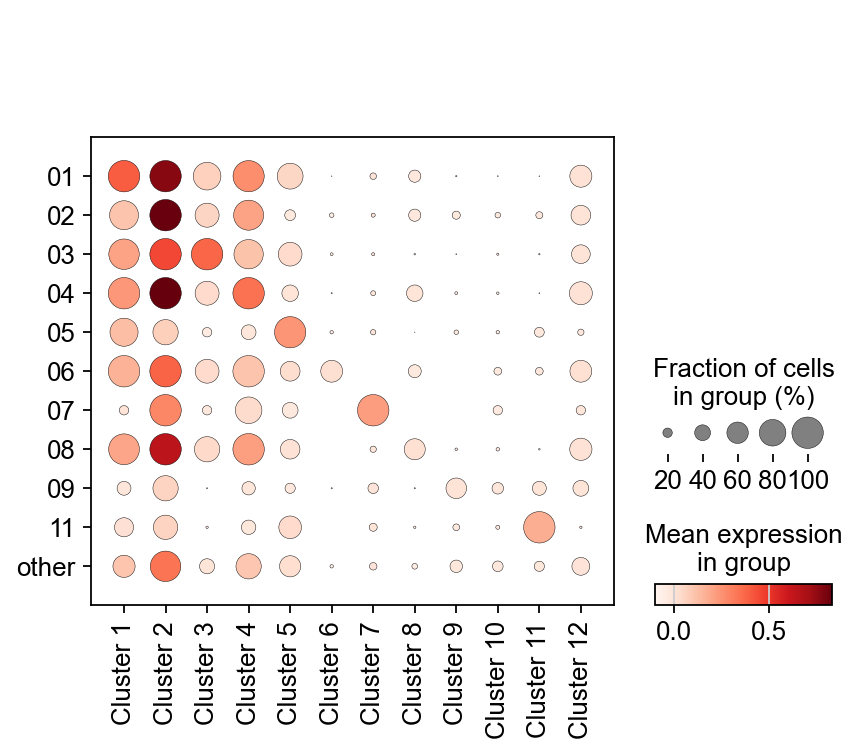

In [151]:
sc.pl.dotplot(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

In [152]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

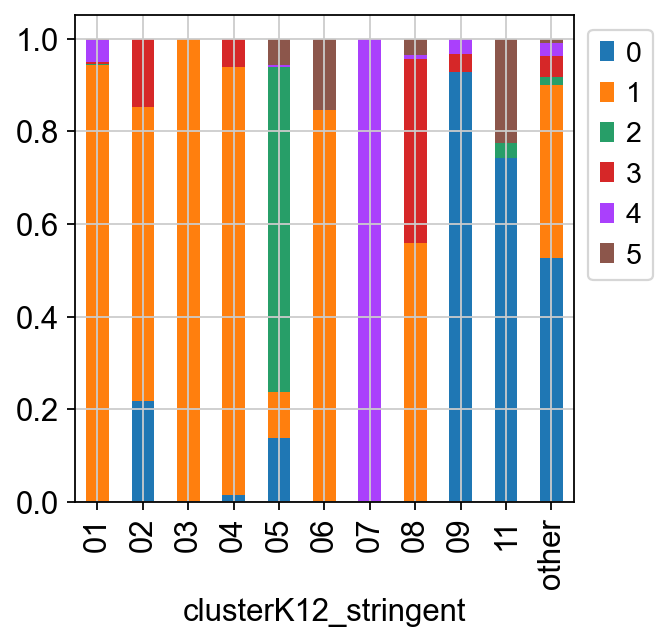

In [153]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

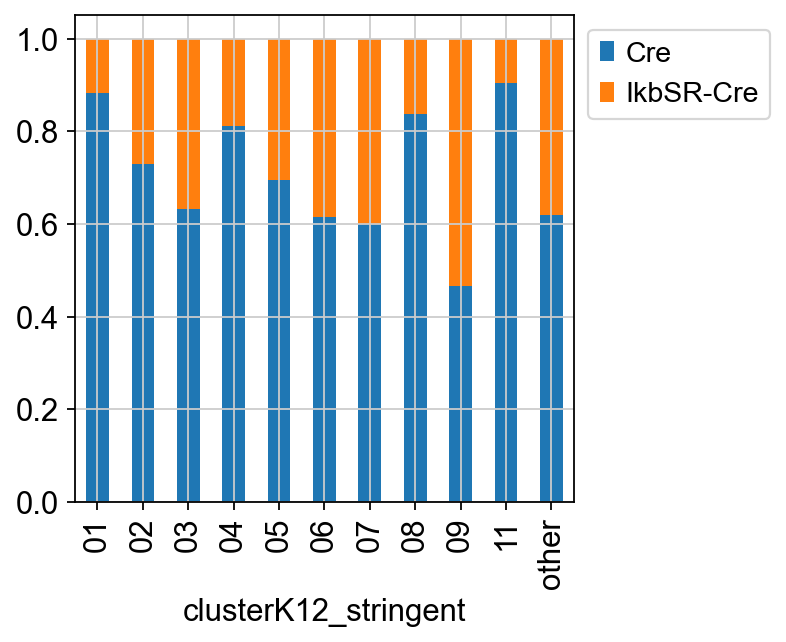

In [154]:
 cell_proportion_df = pd.crosstab(adata.obs['Group'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [155]:
sc.tl.embedding_density(adata, basis='umap', groupby='clusterK12')

computing density on 'umap'
--> added
    'umap_density_clusterK12', densities (adata.obs)
    'umap_density_clusterK12_params', parameter (adata.uns)


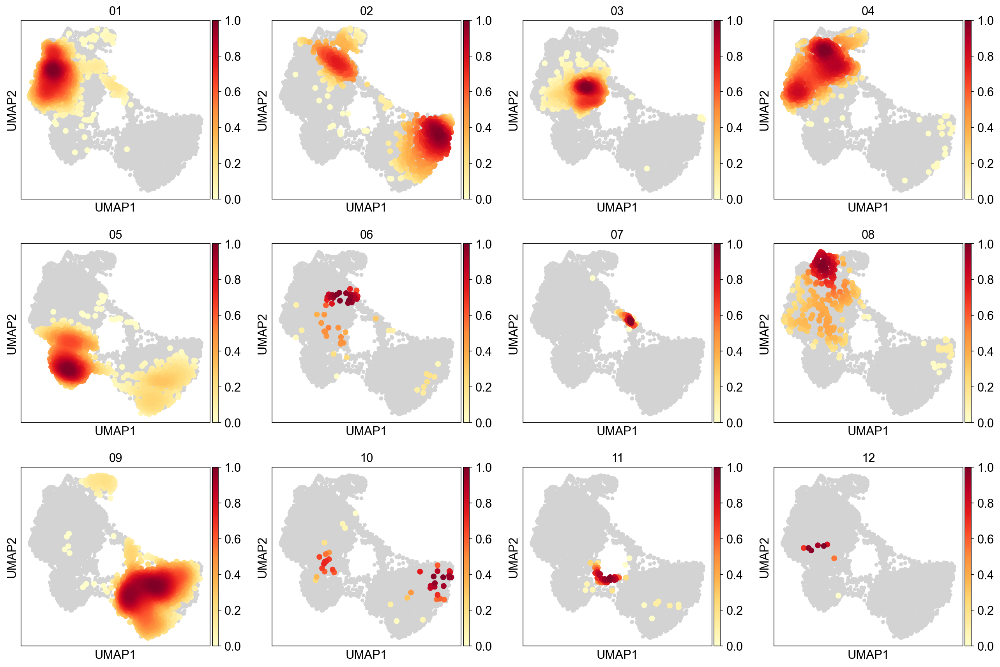

In [156]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_clusterK12')

In [157]:
sc.tl.embedding_density(adata, basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


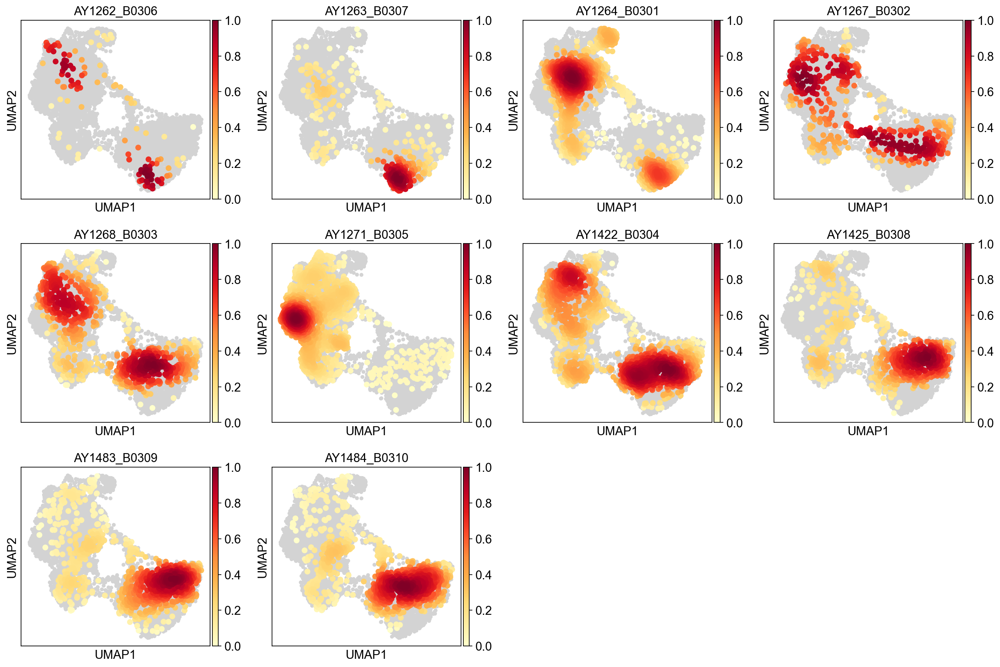

In [158]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Classification')

In [159]:
sc.tl.embedding_density(adata, basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


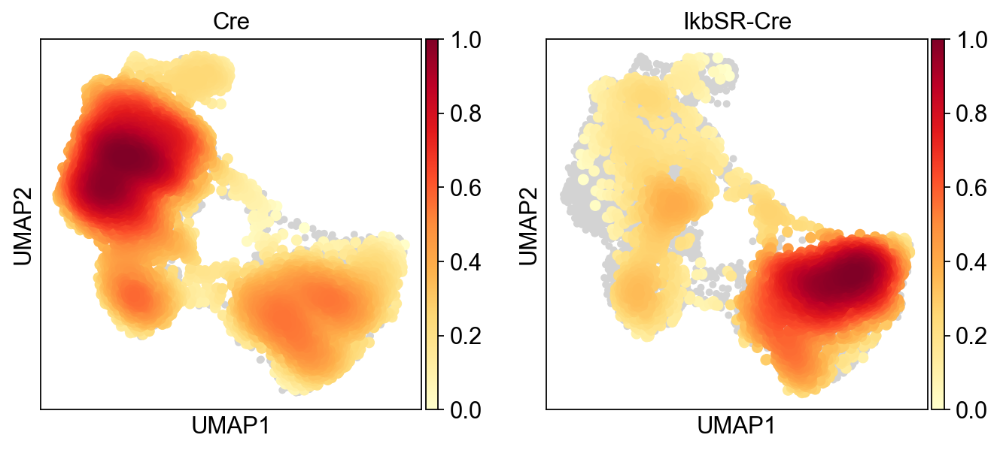

In [160]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Group',group=['Cre','IkbSR-Cre'])

/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/plotting/_tools/__init__.py:1640: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[density_col_name] = dens_values


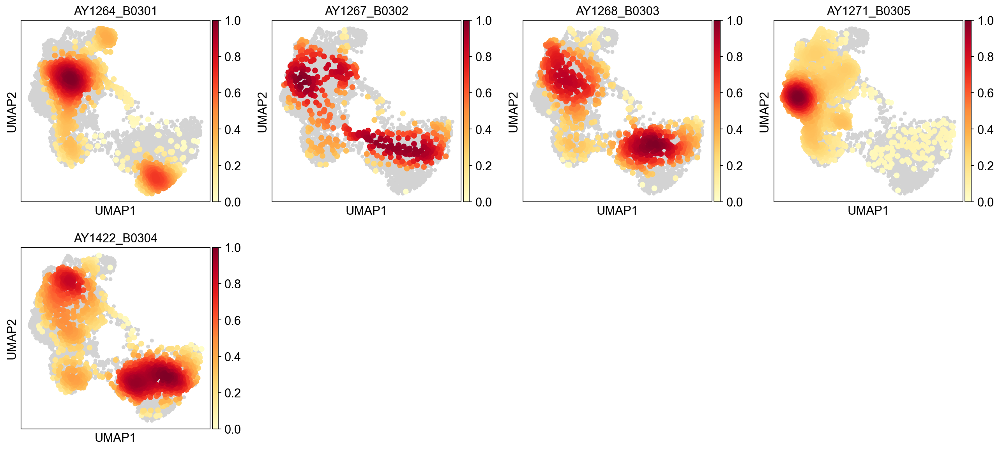

In [161]:
sc.pl.embedding_density(adata[adata.obs.Group.isin(['Cre']),:], basis='umap', key='umap_density_Classification')

/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/plotting/_tools/__init__.py:1640: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[density_col_name] = dens_values


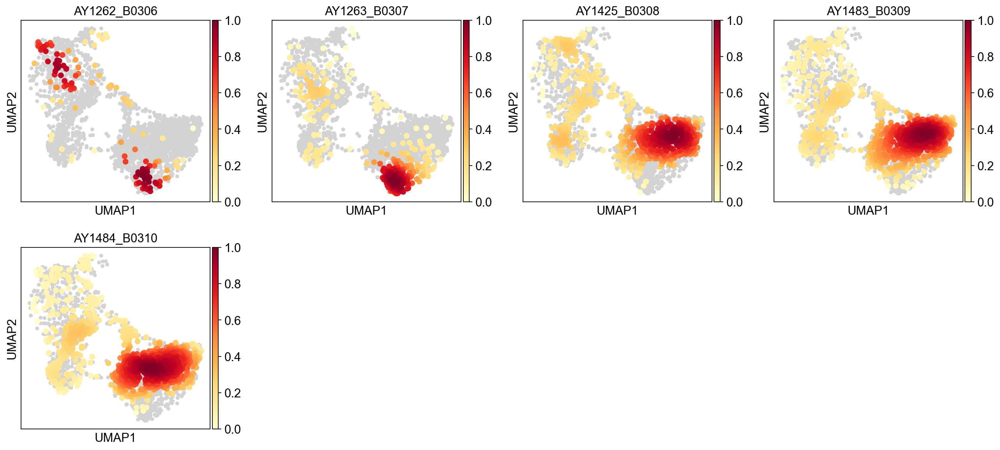

In [162]:
sc.pl.embedding_density(adata[adata.obs.Group.isin(['IkbSR-Cre']),:], basis='umap', key='umap_density_Classification')

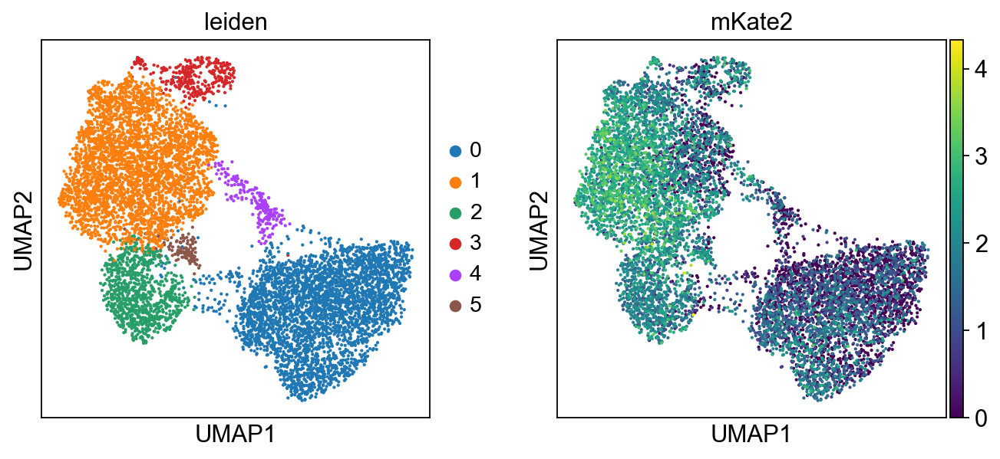

In [163]:
sc.pl.umap(adata, color=['leiden','mKate2'])

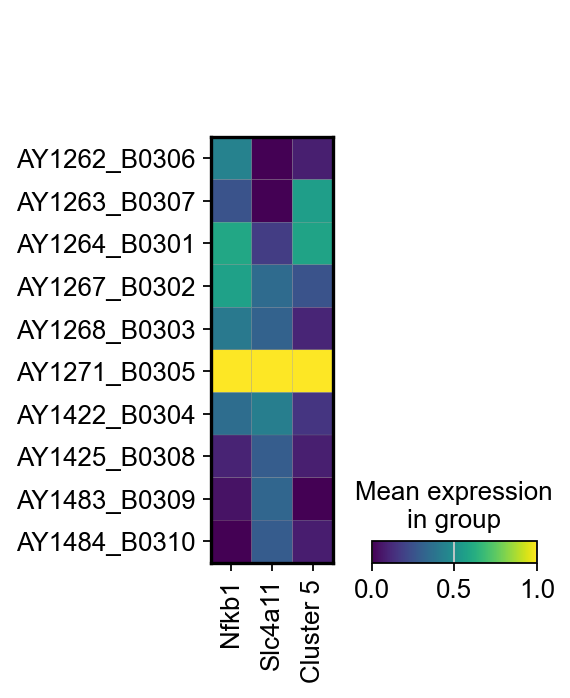

In [164]:
sc.pl.matrixplot(adata, ['Nfkb1','Slc4a11','Cluster 5'], groupby='Classification', standard_scale='var')

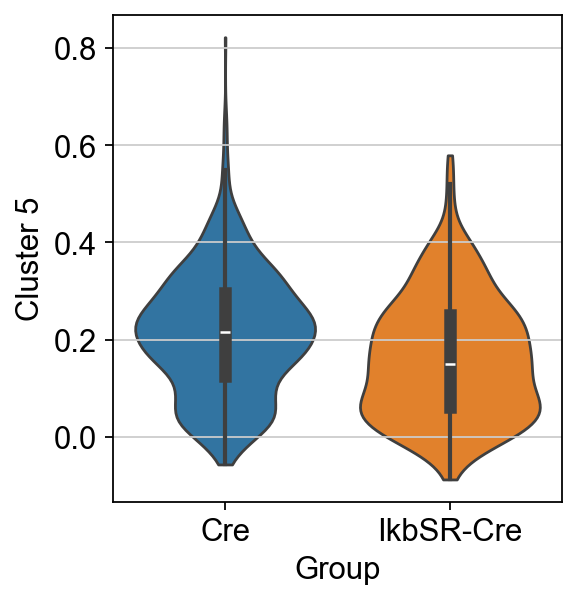

In [165]:
sc.pl.violin(adata[adata.obs.clusterK12.isin(['05']),:], ['Cluster 5'], groupby='Group', order=['Cre','IkbSR-Cre'],stripplot=False, inner='box')

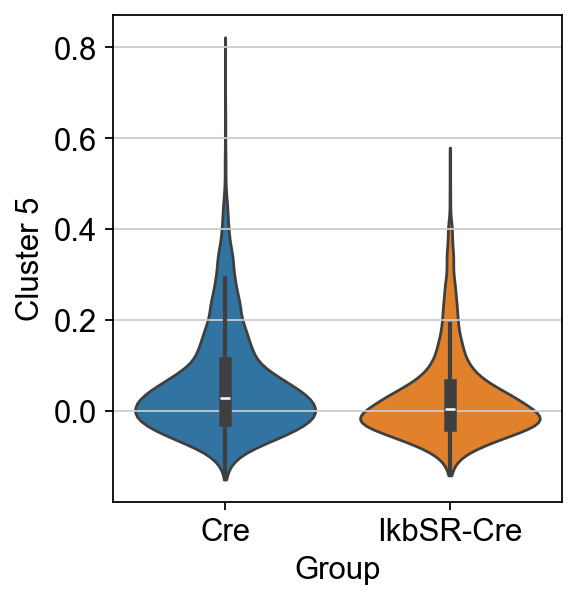

In [166]:
sc.pl.violin(adata, ['Cluster 5'], groupby='Group', order=['Cre','IkbSR-Cre'],stripplot=False, inner='box')

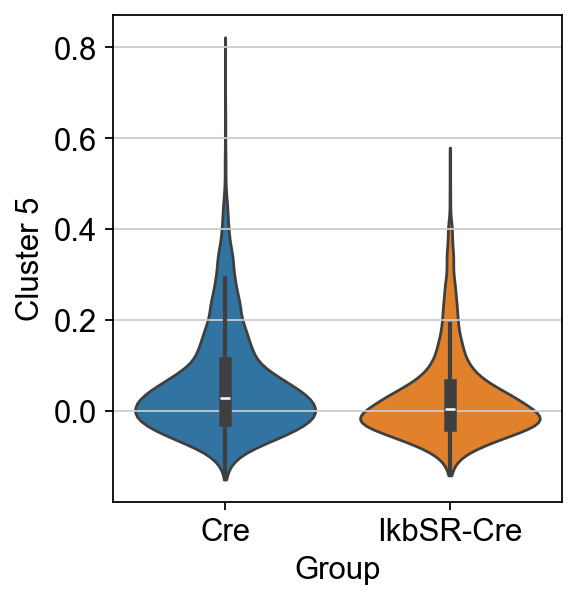

In [167]:
sc.pl.violin(adata, ['Cluster 5'], groupby='Group', order=['Cre','IkbSR-Cre'],stripplot=False, inner='box')

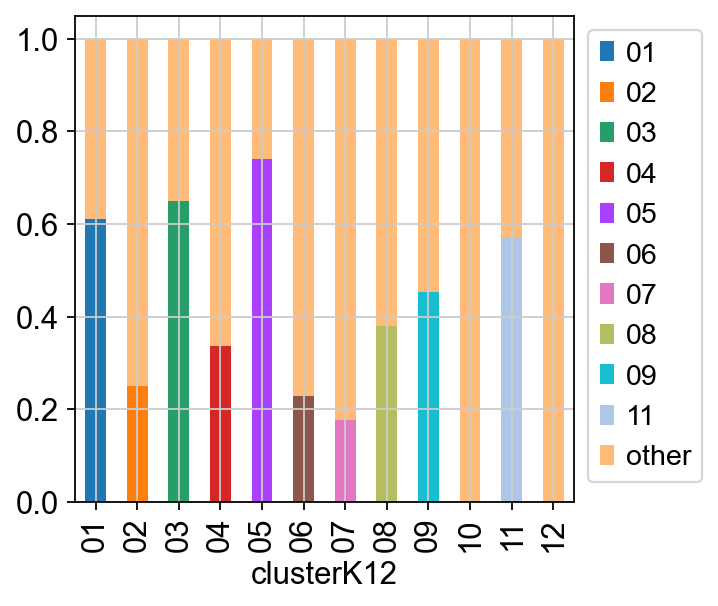

In [168]:
 cell_proportion_df = pd.crosstab(adata[adata.obs.Group=='Cre',:].obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{value_to_plot}_colors"] = colors_list


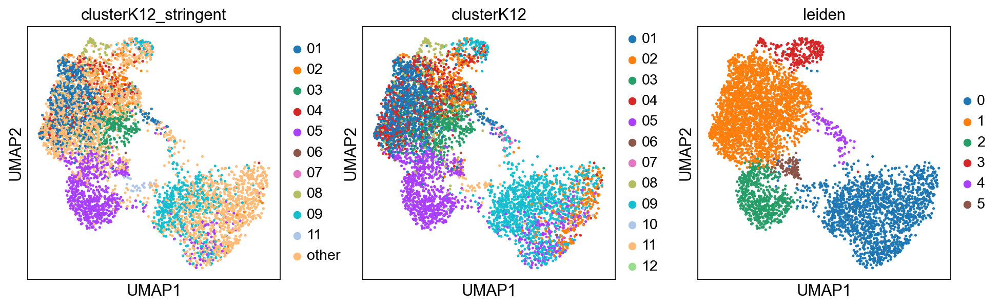

In [169]:
sc.pl.umap(adata[adata.obs.Group=='Cre',:], color=['clusterK12_stringent','clusterK12','leiden'])

/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{value_to_plot}_colors"] = colors_list


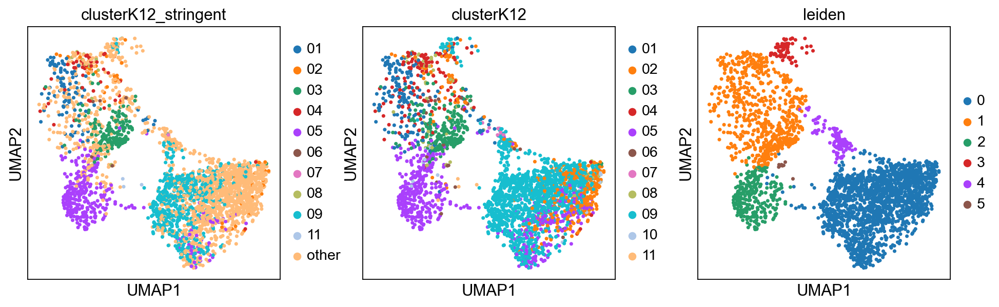

In [170]:
sc.pl.umap(adata[adata.obs.Group=='IkbSR-Cre',:], color=['clusterK12_stringent','clusterK12','leiden'])

In [171]:
adata.obs.Classification.value_counts()

Classification
AY1271_B0305    1483
AY1264_B0301    1392
AY1422_B0304    1252
AY1484_B0310     967
AY1483_B0309     890
AY1268_B0303     836
AY1425_B0308     628
AY1267_B0302     449
AY1263_B0307     349
AY1262_B0306     121
Name: count, dtype: int64

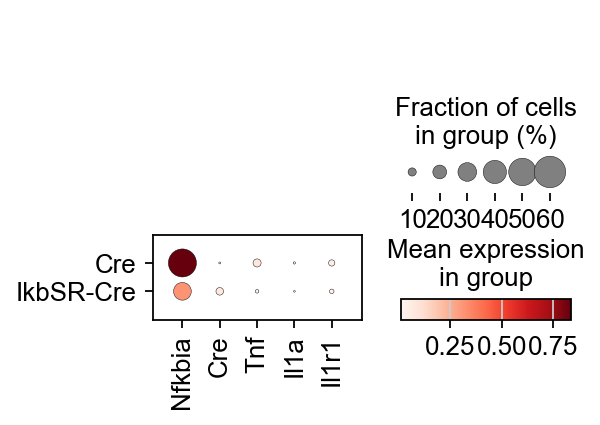

In [172]:
sc.pl.dotplot(adata, ['Nfkbia','Cre', 'Tnf','Il1a','Il1r1'], 'Group')#'Ikbsr-FLAG',

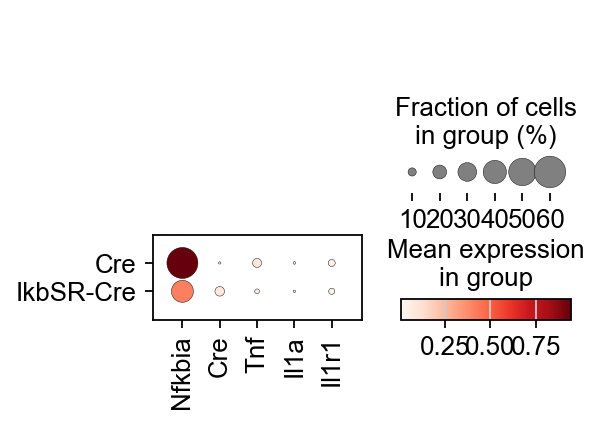

In [173]:
sc.pl.dotplot(adata[adata.obs['clusterK12_stringent'] != 'other',:], ['Nfkbia','Cre','Tnf','Il1a','Il1r1'], 'Group') #'Ikbsr-FLAG', 

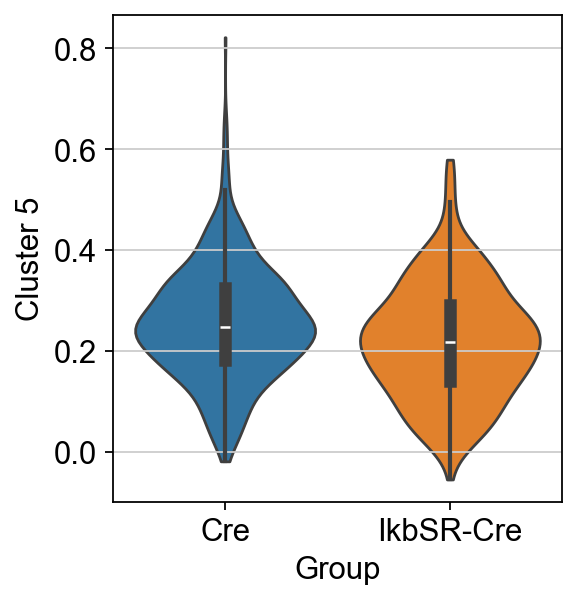

In [174]:
sc.pl.violin(adata[adata.obs.clusterK12_stringent.isin(['05']),:], ['Cluster 5',], groupby='Group', order=['Cre','IkbSR-Cre'],stripplot=False, inner='box')

## Cre Cells

In [175]:
#PtprcCells = adata[adata.X[:,adata.var.index.isin(['Ptprc'])] >= 0.5,:].obs.index
CreCells = adata[adata.obs['Cre_count'] >= 1,:].obs.index

In [176]:
nadata2 = adata[CreCells,:]
nadata2

View of AnnData object with n_obs × n_vars = 346 × 25427
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Cre_count', 'Group', 'score', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'leiden', 'clusterK12', 'clusterK12_stringent', 'umap_density_clusterK12', 'umap_density_Classification', 'umap_density_Group'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'Classification_colors', 'Group_colors', 'leiden', 'leiden_colors', 'umap_density_clusterK12_params', 'umap_density_Classification_params', 'umap_density_Group_params'
    obsm: 'X

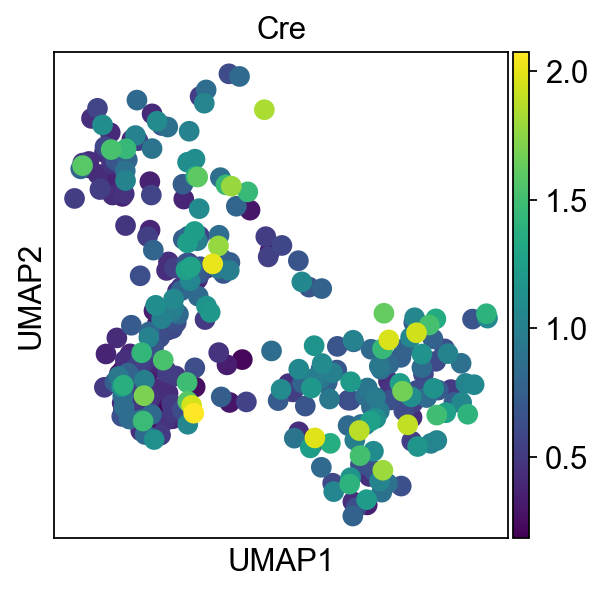

In [177]:
sc.pl.umap(nadata2, color=['Cre', ]) #'Ikbsr-FLAG'

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    847 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    647 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    744 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    698 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    745 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Ldha-ps2'],
      dtype='object')


/home/chanj2/part2a/lib/python3.11/site-packages/scanpy/tools/_score_genes.py:165: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[score_name] = pd.Series(


    finished: added
    'Cluster 6', score of gene set (adata.obs).
    893 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    541 total control genes are used. (0:00:00)
computing score 'Cluster 8'
    finished: added
    'Cluster 8', score of gene set (adata.obs).
    791 total control genes are used. (0:00:00)
computing score 'Cluster 9'
       'CT009486.1', 'AC126687.1', 'AC126799.2', 'AC100406.3', 'Gm14438',
       'Rpl10-ps5', 'Gm14414', 'AC124744.2', 'AC147029.1', 'Gm42845'],
      dtype='object')
    finished: added
    'Cluster 9', score of gene set (adata.obs).
    798 total control genes are used. (0:00:00)
computing score 'Cluster 10'
    finished: added
    'Cluster 10', score of gene set (adata.obs).
    746 total control genes are used. (0:00:00)
computing score 'Cluster 11'
    finished: added
    'Cluster 11', score of gene set (adata.obs).
    694 total control genes are used. (0:

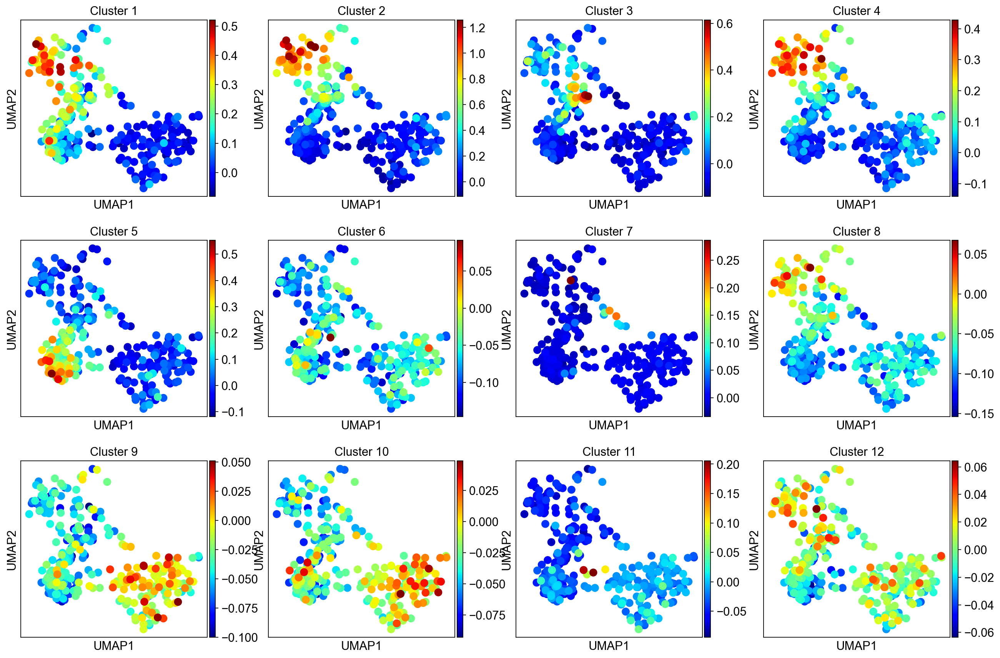

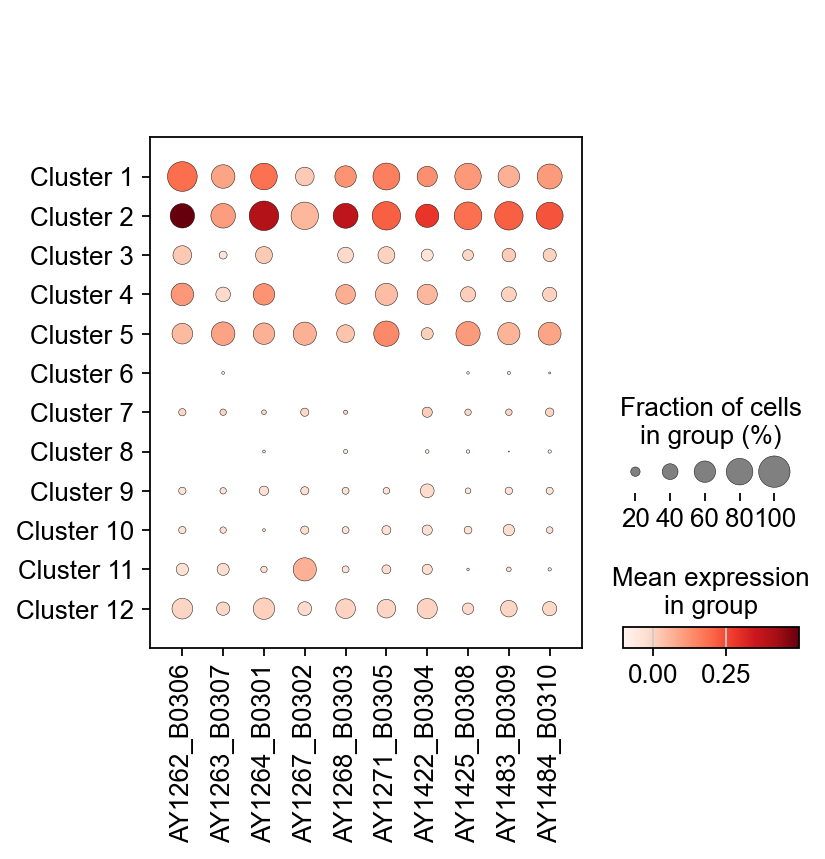

In [178]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(nadata2, numgenes=100)

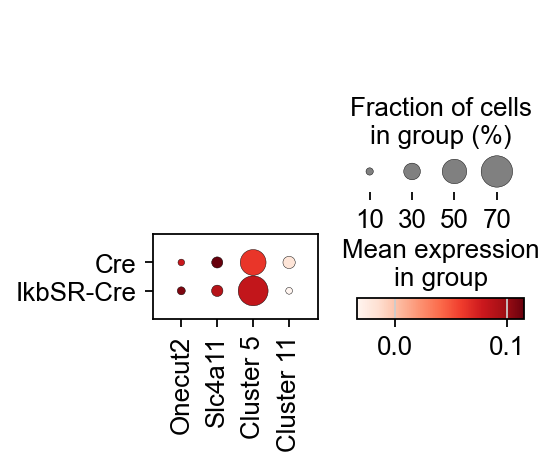

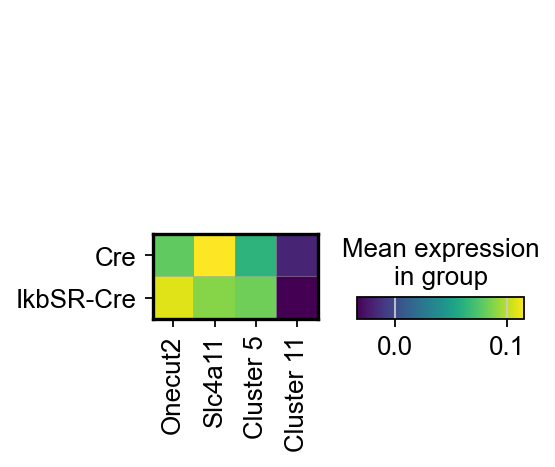

In [179]:
sc.pl.dotplot(nadata2, ['Onecut2','Slc4a11','Cluster 5','Cluster 11'], groupby='Group')
sc.pl.matrixplot(nadata2, ['Onecut2','Slc4a11','Cluster 5','Cluster 11'], groupby='Group')

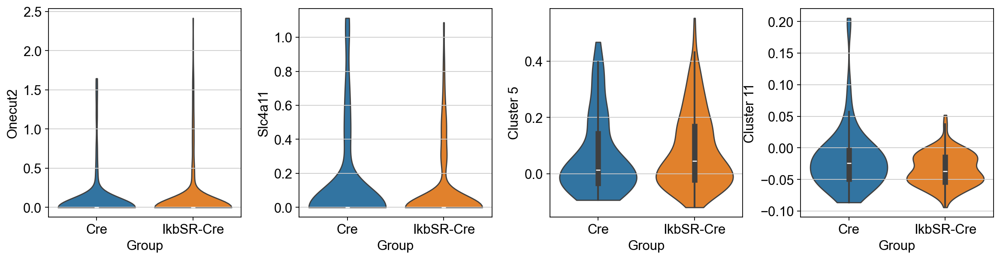

In [180]:
sc.pl.violin(nadata2, ['Onecut2','Slc4a11','Cluster 5','Cluster 11'], groupby='Group', inner='box',stripplot=False)

In [181]:
nadata2.obs.Group.value_counts()

Group
IkbSR-Cre    266
Cre           80
Name: count, dtype: int64

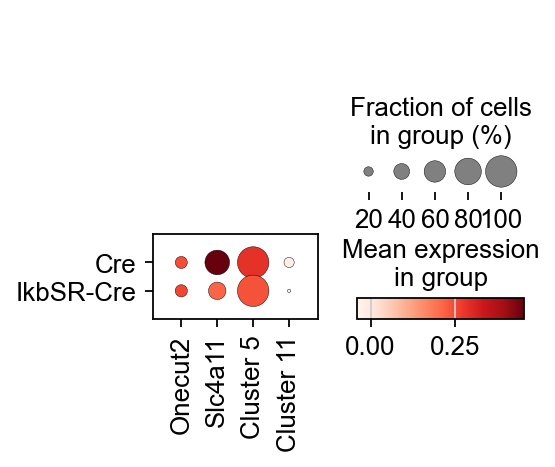

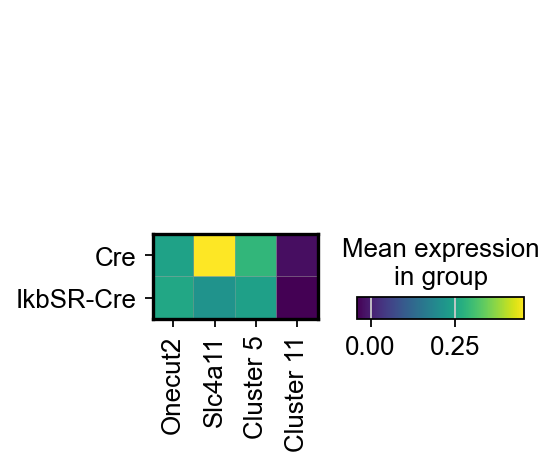

In [183]:
sc.pl.dotplot(nadata2[nadata2.obs.leiden.isin(['2']),:], ['Onecut2','Slc4a11','Cluster 5','Cluster 11'], groupby='Group')
sc.pl.matrixplot(nadata2[nadata2.obs.leiden.isin(['2']),:], ['Onecut2','Slc4a11','Cluster 5','Cluster 11'], groupby='Group')

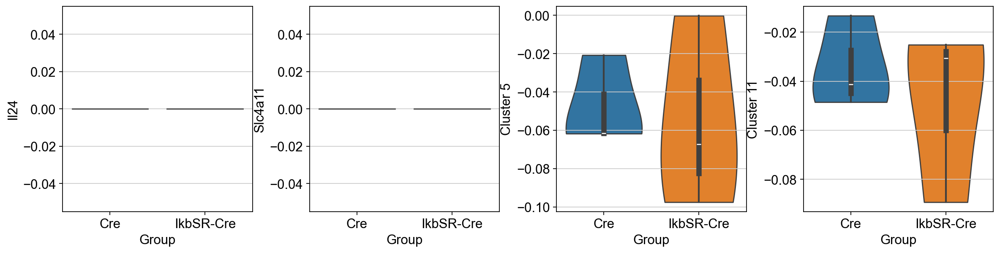

In [186]:
sc.pl.violin(nadata2[nadata2.obs.leiden.isin(['3']),:], ['Il24','Slc4a11','Cluster 5','Cluster 11'], groupby='Group', inner='box',stripplot=False)

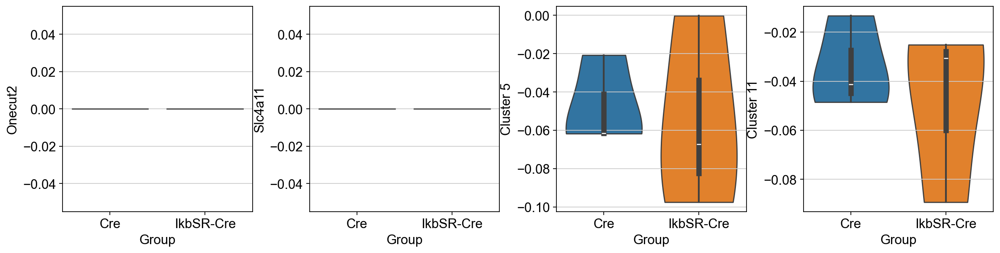

In [184]:
sc.pl.violin(nadata2[nadata2.obs.leiden.isin(['3']),:], ['Onecut2','Slc4a11','Cluster 5','Cluster 11'], groupby='Group', inner='box',stripplot=False)

In [185]:
nadata2[nadata2.obs.leiden.isin(['3']),:].obs.Group.value_counts()

Group
Cre          3
IkbSR-Cre    3
Name: count, dtype: int64

## mKate2 Cells

In [188]:
#PtprcCells = adata[adata.X[:,adata.var.index.isin(['Ptprc'])] >= 0.5,:].obs.index
mKate2Cells = adata[adata.obs['mKate2_count'] >=2, :].obs.index

KeyError: 'mKate2_count'

In [ ]:
adata3 = adata[mKate2Cells,:]
adata3

In [ ]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata3, numgenes=50)

In [ ]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(adata3,numgenes=50)

In [ ]:
sc.pl.dotplot(adata3, ['Onecut2','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')
sc.pl.matrixplot(adata3, ['Onecut2','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')

In [ ]:
sc.pl.umap(adata3, color=['leiden','Cl5Bootstrap2'])

In [ ]:
sc.pl.violin(adata3, ['Onecut2','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', order=['PGKCre','IkbSR'], inner='box',stripplot=False)

In [ ]:
adata3.obs.Group.value_counts()

In [ ]:
sc.pl.dotplot(adata3[adata3.obs.leiden.isin(['3']),:], ['Onecut2','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')
sc.pl.matrixplot(adata3[adata3.obs.leiden.isin(['3']),:], ['Onecut2','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')

In [ ]:
sc.pl.violin(adata3[adata3.obs.leiden.isin(['3']),:], ['Onecut2','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', order=['PGKCre','IkbSR'], inner='box',stripplot=False)

In [ ]:
sc.pl.violin(adata3[adata3.obs.clusterK12_stringent.isin(['05']),:], ['Onecut2','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', order=['PGKCre','IkbSR'], inner='box',stripplot=False)

In [ ]:
sc.pl.violin(adata3[adata3.obs.clusterK12_stringent.isin(['05']),:], ['Il24','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', order=['PGKCre','IkbSR'], inner='box',stripplot=False)

In [ ]:
sc.pl.umap(adata3, color=['Cluster 5 high','Cluster 5', 'Cl5Bootstrap2'])

In [ ]:
sc.pl.violin(adata3[adata3.obs.clusterK12.isin(['05']),:], ['Onecut2','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', order=['PGKCre','IkbSR'], inner='box',stripplot=False)

In [ ]:
sc.pl.violin(adata3[adata3.obs['Cluster 5 high'].isin(['1']),:], ['Il24','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', order=['PGKCre','IkbSR'], inner='box',stripplot=False)

In [ ]:
sc.pl.violin(adata3[adata3.obs.leiden.isin(['3']),:], ['Cl5Bootstrap2'], groupby='Group', order=['PGKCre','IkbSR'], 
             inner='box',stripplot=False, save='PGKvsIkb.svg')

In [ ]:
import scipy.stats
scipy.stats.mannwhitneyu(adata3[adata3.obs.leiden.isin(['3']) & adata3.obs.Group.isin(['PGKCre']),:].obs['Cl5Bootstrap2'], 
                   adata3[adata3.obs.leiden.isin(['3']) & adata3.obs.Group.isin(['IkbSR']),:].obs['Cl5Bootstrap2'], )

In [ ]:
import scipy.stats
scipy.stats.mannwhitneyu(adata3[adata3.obs.clusterK12_stringent.isin(['05']) & adata3.obs.Group.isin(['PGKCre']),:].obs['Cl5Bootstrap2'], 
                   adata3[adata3.obs.clusterK12_stringent.isin(['05']) & adata3.obs.Group.isin(['IkbSR']),:].obs['Cl5Bootstrap2'], )

In [ ]:
adata3[adata3.obs.leiden.isin(['3']),:].obs.Group.value_counts()

In [ ]:
adata3[adata3.obs.leiden.isin(['3']),:].obs.Group.value_counts(normalize=True)

In [ ]:
adata3[adata3.obs.leiden.isin(['3']),:].obs[['Classification','leiden','Group']].value_counts()

In [ ]:
adata3.obs.Classification.value_counts()

## Finding marker genes

Let us compute a ranking for the highly differential genes in each cluster. For this, by default, the `.raw` attribute of AnnData is used in case it has been initialized before. The simplest and fastest method to do so is the t-test.

In [ ]:
sc.pl.umap(adata, color=['leiden'])

In [ ]:
# bug fix
adata.uns['log1p']['base'] = None

In [ ]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [ ]:
sc.settings.verbosity = 2  # reduce the verbosity

The result of a [Wilcoxon rank-sum (Mann-Whitney-U)](https://en.wikipedia.org/wiki/Mann%E2%80%93Whitney_U_test) test is very similar. We recommend using the latter in publications, see e.g., [Sonison & Robinson (2018)](https://doi.org/10.1038/nmeth.4612). You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.

In [ ]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, groupby="leiden")


Save the result.

In [ ]:
adata.write(results_file, compression='gzip')

As an alternative, let us rank genes using logistic regression. For instance, this has been suggested by [Natranos et al. (2018)](https://doi.org/10.1101/258566). The essential difference is that here, we use a multi-variate appraoch whereas conventional differential tests are uni-variate. [Clark et al. (2014)](https://doi.org/10.1186/1471-2105-15-79) has more details.

In [ ]:
sc.tl.rank_genes_groups(adata, 'leiden', method='logreg')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

Reload the object that has been save with the Wilcoxon Rank-Sum test result.

In [ ]:
adata = sc.read(results_file)

#Export for SCENIC analysis
#adata.write_h5ad("write/postSCT-tumor-leiden.h5ad",compression='gzip')
#adata = sc.read("write/postSCT-tumor-leiden.h5ad")

In [ ]:
nfkbgenes = ['Nfkbia', 'Bcl2', 'Bcl2l1','Xiap', ]
inflammatory = ['Tnf', 'Il6', 'Cxcl1', 'Il6']

sc.pl.violin(adata, nfkbgenes, groupby='Group', inner='box',stripplot=False)
sc.pl.violin(adata, inflammatory, groupby='Group', inner='box',stripplot=False)

In [ ]:
sc.pl.violin(adata3, nfkbgenes, groupby='Group', inner='box',stripplot=False)
sc.pl.violin(adata3, inflammatory, groupby='Group', inner='box',stripplot=False)

## GSEA - leiden 3

In [ ]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

In [ ]:
sc.tl.rank_genes_groups(adata, 'leiden', groups=['3'], reference='rest', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=20)

In [ ]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
results_df = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj','scores']}) #.to_excel('test.xlsx')
results_df.to_excel('write/leiden_3.xlsx')

In [ ]:
import gseapy
#Available databases : ‘Human’, ‘Mouse’, ‘Yeast’, ‘Fly’, ‘Fish’, ‘Worm’ 
gene_set_names = gseapy.get_library_name(organism='Mouse')
print(gene_set_names)
#gsets = 'Descartes_Cell_Types_and_Tissue_2021'
#gsets = 'Tabula_Muris'
gsets = 'MSigDB_Hallmark_2020'
#gsets = 'The_Kinase_Library_2023'
#gsets = 'TF_Perturbations_Followed_by_Expression'

In [ ]:
#?gseapy.enrichr
#glist0 = sc.get.rank_genes_groups_df(adata4, group='PGKCre', 
#                                    key='rank_genes_groups', #log2fc_min=0.25, 
#                                    pval_cutoff=0.01)['names'].squeeze().str.strip().tolist()
glist0=results_df[(results_df['3_p'] < 0.01) & (results_df['3_s'] > 0)]['3_n']
print(len(glist0))
enr_res0 = gseapy.enrichr(gene_list=glist0,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0.results.to_excel('write/GSEA_leiden_3_up.xlsx')
enr_res0.results.head(20)

In [ ]:
#?gseapy.enrichr
#glist0 = sc.get.rank_genes_groups_df(adata4, group='PGKCre', 
#                                    key='rank_genes_groups', #log2fc_min=0.25, 
#                                    pval_cutoff=0.01)['names'].squeeze().str.strip().tolist()
glist2=results_df[(results_df['3_p'] < 0.01) & (results_df['3_s'] < 0)]['3_n']
print(len(glist2))
enr_res2 = gseapy.enrichr(gene_list=glist2,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res2.results.to_excel('write/GSEA_leiden_3_down.xlsx')
enr_res2.results.head(20)

In [ ]:
gseapy.barplot(enr_res0.res2d,title="%s Leiden 3 Up" % gsets)
gseapy.barplot(enr_res2.res2d,title="%s Leiden 3 Down" % gsets)

In [ ]:
sc.pl.umap(adata, color=['leiden','Nfkb1','Cluster 5','Slc4a11'], cmap='Reds')

In [ ]:
sc.pl.dotplot(adata, ['Nfkb1'], groupby='leiden')

## GSEA - leiden 0

In [ ]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

In [ ]:
sc.tl.rank_genes_groups(adata, 'leiden', groups=['0'], reference='rest', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=20)

In [ ]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
results_df = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj','scores']}) #.to_excel('test.xlsx')
results_df.to_excel('write/leiden_0.xlsx')

In [ ]:
import gseapy
#Available databases : ‘Human’, ‘Mouse’, ‘Yeast’, ‘Fly’, ‘Fish’, ‘Worm’ 
gene_set_names = gseapy.get_library_name(organism='Mouse')
print(gene_set_names)
#gsets = 'Descartes_Cell_Types_and_Tissue_2021'
#gsets = 'Tabula_Muris'
gsets = 'MSigDB_Hallmark_2020'
#gsets = 'The_Kinase_Library_2023'
#gsets = 'TF_Perturbations_Followed_by_Expression'

In [ ]:
#?gseapy.enrichr
#glist0 = sc.get.rank_genes_groups_df(adata4, group='PGKCre', 
#                                    key='rank_genes_groups', #log2fc_min=0.25, 
#                                    pval_cutoff=0.01)['names'].squeeze().str.strip().tolist()
glist0=results_df[(results_df['0_p'] < 0.01) & (results_df['0_s'] > 0)]['0_n']
print(len(glist0))
enr_res0 = gseapy.enrichr(gene_list=glist0,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0.results.to_excel('write/GSEA_leiden_0_up.xlsx')
enr_res0.results.head(20)

In [ ]:
#?gseapy.enrichr
#glist0 = sc.get.rank_genes_groups_df(adata4, group='PGKCre', 
#                                    key='rank_genes_groups', #log2fc_min=0.25, 
#                                    pval_cutoff=0.01)['names'].squeeze().str.strip().tolist()
glist2=results_df[(results_df['0_p'] < 0.01) & (results_df['0_s'] < 0)]['0_n']
print(len(glist2))
enr_res2 = gseapy.enrichr(gene_list=glist2,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res2.results.to_excel('write/GSEA_leiden_0_down.xlsx')
enr_res2.results.head(20)

In [ ]:
gseapy.barplot(enr_res0.res2d,title="%s Leiden 0 Up" % gsets)
gseapy.barplot(enr_res2.res2d,title="%s Leiden 0 Down" % gsets)

## GSEA - clusterK12_stringent

In [ ]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

In [ ]:
sc.tl.rank_genes_groups(adata, 'clusterK12_stringent', groups=['05'], reference='rest', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=20)

In [ ]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
results_df = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj','scores']}) #.to_excel('test.xlsx')
results_df.to_excel('write/clusterK12_stringent_05.xlsx')

In [ ]:
import gseapy
#Available databases : ‘Human’, ‘Mouse’, ‘Yeast’, ‘Fly’, ‘Fish’, ‘Worm’ 
gene_set_names = gseapy.get_library_name(organism='Mouse')
print(gene_set_names)
#gsets = 'Descartes_Cell_Types_and_Tissue_2021'
#gsets = 'Tabula_Muris'
gsets = 'MSigDB_Hallmark_2020'
#gsets = 'The_Kinase_Library_2023'
#gsets = 'TF_Perturbations_Followed_by_Expression'

In [ ]:
#?gseapy.enrichr
#glist0 = sc.get.rank_genes_groups_df(adata4, group='PGKCre', 
#                                    key='rank_genes_groups', #log2fc_min=0.25, 
#                                    pval_cutoff=0.01)['names'].squeeze().str.strip().tolist()
glist0=results_df[(results_df['05_p'] < 0.01) & (results_df['05_s'] > 0)]['05_n']
print(len(glist0))
enr_res0 = gseapy.enrichr(gene_list=glist0,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0.results.to_excel('write/GSEA_K12_stringent_05_up.xlsx')
enr_res0.results.head(20)

In [ ]:
#?gseapy.enrichr
#glist0 = sc.get.rank_genes_groups_df(adata4, group='PGKCre', 
#                                    key='rank_genes_groups', #log2fc_min=0.25, 
#                                    pval_cutoff=0.01)['names'].squeeze().str.strip().tolist()
glist2=results_df[(results_df['05_p'] < 0.01) & (results_df['05_s'] < 0)]['05_n']
print(len(glist2))
enr_res2 = gseapy.enrichr(gene_list=glist2,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res2.results.to_excel('write/GSEA_K12_stringent_05_down.xlsx')
enr_res2.results.head(20)

In [ ]:
gseapy.barplot(enr_res0.res2d,title="%s clusterK12_stringent 05 Up" % gsets)
gseapy.barplot(enr_res2.res2d,title="%s clusterK12_stringent 05 Down" % gsets)

## Determine if variance is equivalent between groups

In [ ]:
import scipy

In [ ]:
scipy.stats.bartlett(*[adata3.obs.Cl5Bootstrap2[(adata.obs.leiden.isin(['2']) & adata3.obs['Classification'].isin([y]))] for y in adata3.obs.Classification.cat.categories])

## Run Welch's Anova Variant

In [ ]:
import pingouin as pg

In [ ]:
pg.welch_anova(dv='Cl5Bootstrap2',between='Group',data=adata3[adata3.obs.leiden.isin(['2'])].obs)

## Now Identify all populations against the control that is significant

In [ ]:
#b = pg.pairwise_gameshowell(dv='Cl5Bootstrap2',between='cLibrary',data=adata8[adata8.obs.leiden.isin(['1'])].obs)
b = pg.pairwise_gameshowell(dv='Cl5Bootstrap2',between='Group',data=adata3[adata3.obs.leiden.isin(['2']),:].obs)

In [ ]:
b

In [ ]:
scipy.stats.mannwhitneyu(adata3[adata3.obs.leiden.isin(['2']) & adata3.obs.Group.isin(['PGKCre']),:].obs.Cl5Bootstrap2,
                        adata3[adata3.obs.leiden.isin(['2']) & adata3.obs.Group.isin(['IkbSR']),:].obs.Cl5Bootstrap2)

## Now isolate just Cluster 5 cells

In [ ]:
adata4 = adata.raw.to_adata()[adata3[adata3.obs.leiden.isin(['2']),:].obs.index,:]

In [ ]:
adata4

In [ ]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p']['base'] = None

In [ ]:
sc.pp.highly_variable_genes(adata4, batch_key='Group') #batch_key=Classification

In [ ]:
sc.pl.highly_variable_genes(adata4)

In [ ]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata4.var.highly_variable_intersection['Ikbsr-FLAG'] = False
adata4.var.highly_variable_intersection['Cre'] = False
adata4.var.highly_variable_intersection['mKate2'] = False

In [ ]:
adata4 = adata4[:, adata4.var.highly_variable_intersection]

In [ ]:
sc.pp.regress_out(adata4, ['total_counts', 'pct_counts_mt'])

In [ ]:
sc.pp.scale(adata4, max_value=10)

## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [ ]:
sc.tl.pca(adata4, svd_solver='arpack', n_comps=150)

We can make a scatter plot in the PCA coordinates, but we will not use that later on.

In [ ]:
sc.pl.pca(adata4, color='Kras')

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`. In our experience, often a rough estimate of the number of PCs does fine.

In [ ]:
sc.pl.pca_variance_ratio(adata4, log=True, n_pcs=150)

Save the result.

In [ ]:
adata4

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [ ]:
sc.pp.neighbors(adata4, n_neighbors=15, n_pcs=50)

## Embedding the neighborhood graph

We suggest embedding the graph in two dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [ ]:
sc.tl.umap(adata4)

In [ ]:
sc.tl.leiden(adata4, resolution=0.25)

In [ ]:
sc.pl.umap(adata4, color=['Group','leiden'])

In [ ]:
sc.tl.embedding_density(adata4, basis='umap', groupby='Group')

In [ ]:
sc.pl.embedding_density(adata4, basis='umap', key='umap_density_Group')

## Explore Phase

In [ ]:
sc.pl.dotplot(adata,['Mki67'],groupby='Group')

In [ ]:
cell_cycle_genes = [x.strip() for x in open('./regev_lab_cell_cycle_genes_mouse.txt')]

In [ ]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

In [ ]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

In [ ]:
adata_cc_genes = adata[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color='phase')

In [ ]:
 cell_proportion_df = pd.crosstab(adata.obs['phase'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [ ]:
cell_proportion_df = pd.crosstab(adata.obs['phase'],adata.obs['Group'], normalize='columns').T
cell_proportion_df

In [ ]:
adata.obs[['Classification','Group','phase']].value_counts(sort=False)


## Monte-carlo determination of proportions

In [ ]:
obs1 = adata[adata.obs.Group.isin(['IkbSR']),:].obs.clusterK12_stringent
adata[adata.obs.Group.isin(['PGKCre']),:].obs.clusterK12_stringent.value_counts()

In [ ]:
%%timeit
#from sklearn.model_selection import train_test_split
obs1 = adata[adata.obs.Group.isin(['IkbSR']),:].obs.clusterK12_stringent
obs2 = adata[adata.obs.Group.isin(['PGKCre']),:].obs.clusterK12_stringent

def monteCarloEmpiricP(obs1, obs2, target, num_trials=1000, show=False):
    mu = obs1.value_counts()[target] - obs2.value_counts()[target]
    a = np.array([0]*(len(obs1)+len(obs2)))
    a[0:obs1.value_counts()[target] + obs2.value_counts()[target]] = 1
    empiric = []
    for x in range(0,num_trials):
        np.random.shuffle(a)
        empiric.append(sum(a[0:len(obs1)]) - sum(a[len(obs1):]))
    if show:
        _ = plt.hist(empiric, bins='auto')
        plt.ylabel("Count")
        plt.title("Empiric Distribution")
        plt.axvline(x=mu)
        plt.show()
        #print(mu)
    p = sum(mu > empiric)/num_trials
    if (mu > np.median(empiric)):
        p = 1 - p
    p *= 2
    return(p)
print(monteCarloEmpiricP(obs1, obs2, '05',show=True))
#print("P values: G1 %0.3e, S: %0.3e, G2M: %0.3e" % (monteCarloEmpiricP(obs1, obs2, 'G1'),
#    monteCarloEmpiricP(obs1, obs2, 'S'),
#    monteCarloEmpiricP(obs1, obs2, 'G2M')))

In [ ]:
from sklearn.model_selection import train_test_split
obs1 = adata[adata.obs.Group.isin(['IkbSR']),:].obs.leiden
obs2 = adata[adata.obs.Group.isin(['PGKCre']),:].obs.leiden

def monteCarloEmpiricP(obs1, obs2, target, num_trials=10000, show=False):
    mu = obs1.value_counts()[target] - obs2.value_counts()[target]
    a = np.array([0]*(len(obs1)+len(obs2)))
    a[0:obs1.value_counts()[target] + obs2.value_counts()[target]] = 1
    empiric = []
    for x in range(0,num_trials):
        np.random.shuffle(a)
        empiric.append(sum(a[0:len(obs1)]) - sum(a[len(obs1):]))
    if show:
        _ = plt.hist(empiric, bins='auto')
        plt.ylabel("Count")
        plt.title("Empiric Distribution")
        plt.axvline(x=mu)
        plt.show()
        #print(mu)
    p = sum(mu > empiric)/num_trials
    if (mu > np.median(empiric)):
        p = 1 - p
    p *= 2
    return(p)
print(monteCarloEmpiricP(obs1, obs2, '2',show=True))
#print("P values: G1 %0.3e, S: %0.3e, G2M: %0.3e" % (monteCarloEmpiricP(obs1, obs2, 'G1'),
#    monteCarloEmpiricP(obs1, obs2, 'S'),
#    monteCarloEmpiricP(obs1, obs2, 'G2M')))

In [ ]:
from sklearn.model_selection import train_test_split
obs1 = adata3[adata3.obs.Group.isin(['IkbSR']),:].obs.leiden
obs2 = adata3[adata3.obs.Group.isin(['PGKCre']),:].obs.leiden

def monteCarloEmpiricP(obs1, obs2, target, num_trials=1000, show=False):
    mu = obs1.value_counts()[target] - obs2.value_counts()[target]
    a = np.array([0]*(len(obs1)+len(obs2)))
    a[0:obs1.value_counts()[target] + obs2.value_counts()[target]] = 1
    empiric = []
    for x in range(0,num_trials):
        np.random.shuffle(a)
        empiric.append(sum(a[0:len(obs1)]) - sum(a[len(obs1):]))
    if show:
        _ = plt.hist(empiric, bins='auto')
        plt.ylabel("Count")
        plt.title("Empiric Distribution")
        plt.axvline(x=mu)
        plt.show()
        #print(mu)
    p = sum(mu > empiric)/num_trials
    if (mu > np.median(empiric)):
        p = 1 - p
    p *= 2
    return(p)
print(monteCarloEmpiricP(obs1, obs2, '2',show=True))
#print("P values: G1 %0.3e, S: %0.3e, G2M: %0.3e" % (monteCarloEmpiricP(obs1, obs2, 'G1'),
#    monteCarloEmpiricP(obs1, obs2, 'S'),
#    monteCarloEmpiricP(obs1, obs2, 'G2M')))
adata3[adata3.obs.Group == 'IkbSR'].obs.leiden.value_counts(sort=False, normalize=True)

In [ ]:
adata3[adata3.obs.Group == 'IkbSR'].obs.leiden.value_counts(sort=False, normalize=True)

In [ ]:
adata3[adata3.obs.Group == 'PGKCre'].obs.leiden.value_counts(sort=False, normalize=True)

In [ ]:
_ = plt.hist(adata3[adata3.obs.Group.isin(['IkbSR']) & adata3.obs.leiden.isin(['2']),:].obs.Cl5Bootstrap2, bins='auto')
plt.ylabel("Count")
plt.title("Empiric Distribution")
#plt.axvline(x=mu)
plt.show()

In [ ]:
_ = plt.hist(adata3[adata3.obs.Group.isin(['PGKCre']) & adata3.obs.leiden.isin(['2']),:].obs.Cl5Bootstrap2, bins='auto')
plt.ylabel("Count")
plt.title("Empiric Distribution")
#plt.axvline(x=mu)
plt.show()

## Annotate with GSEA

In [ ]:
sc.tl.rank_genes_groups(adata3, 'Group', groups=['IkbSR'], reference='PGKCre', method='wilcoxon')
sc.pl.rank_genes_groups(adata3, n_genes=20, sharey=False)
sc.pl.rank_genes_groups_dotplot(adata3, n_genes=5, groupby="Group")


In [ ]:
result = adata3.uns['rank_genes_groups']
groups = result['names'].dtype.names
results_df = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj','scores', 'logfoldchanges']}) #.to_excel('test.xlsx')
results_df
results_df.to_excel("IkbSRgenes.xlsx")

In [ ]:
import gseapy
#Available databases : ‘Human’, ‘Mouse’, ‘Yeast’, ‘Fly’, ‘Fish’, ‘Worm’ 
gene_set_names = gseapy.get_library_name(organism='Mouse')
print(gene_set_names)
#gsets = 'Descartes_Cell_Types_and_Tissue_2021'
#gsets = 'Tabula_Muris'
gsets = 'MSigDB_Hallmark_2020'
#gsets = 'The_Kinase_Library_2023'
#gsets = 'TF_Perturbations_Followed_by_Expression'

In [ ]:
#?gseapy.enrichr
#glist0 = sc.get.rank_genes_groups_df(adata4, group='PGKCre', 
#                                    key='rank_genes_groups', #log2fc_min=0.25, 
#                                    pval_cutoff=0.01)['names'].squeeze().str.strip().tolist()
glist0=results_df[(results_df['IkbSR_p'] < 0.01) & (results_df['IkbSR_s'] < 0)]['IkbSR_n']
print(len(glist0))
enr_res0 = gseapy.enrichr(gene_list=glist0,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0.results.head(20)
enr_res0.results.to_excel("IkbSRdown.xlsx")

In [ ]:
#?gseapy.enrichr
#glist1 = sc.get.rank_genes_groups_df(adata4, group='IkbSR', 
#                                    key='rank_genes_groups', #log2fc_min=0.25, 
#                                    pval_cutoff=0.01)['names'].squeeze().str.strip().tolist()
glist1=results_df[(results_df['IkbSR_p'] < 0.01) & (results_df['IkbSR_s'] > 0)]['IkbSR_n']
print(len(glist1))
enr_res1 = gseapy.enrichr(gene_list=glist1,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res1.results.head(20)

In [ ]:
result = adata4.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj','scores']}).head(200) #.to_excel('test.xlsx')

In [ ]:
gseapy.barplot(enr_res0.res2d,title="%s IkbSR Down" % gsets)
gseapy.barplot(enr_res1.res2d,title="%s IkbSR Up" % gsets)
#gseapy.barplot(enr_res2.res2d,title="%s Cluster 2" % gsets)

In [ ]:
gseapy.dotplot(enr_res0.res2d, figsize=(3,5), title="IkbSR_down", cmap = plt.cm.autumn_r)
plt.show()
gseapy.dotplot(enr_res1.res2d, figsize=(3,5), title="IkbSR_up", cmap = plt.cm.autumn_r)
plt.show()


In [ ]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [ ]:
clusters

In [ ]:
glist2=results_df[(results_df['IkbSR_p'] < 0.01) & (results_df['IkbSR_s'] > 0)]['IkbSR_n']
print(len(glist2))
enr_res2 = gseapy.enrichr(gene_list=glist2,
                     #organism='Mouse',
                        background=None,
                     gene_sets=clusters,
#                     description='pathway',
                     cutoff = 0.5)
enr_res2.results.head(20)

In [ ]:
glist3=results_df[(results_df['IkbSR_p'] < 0.01) & (results_df['IkbSR_s'] < 0)]['IkbSR_n']
print(len(glist3))
enr_res3 = gseapy.enrichr(gene_list=glist3,
                     #organism='Mouse',
                        background=None,
                     gene_sets=clusters,
#                     description='pathway',
                     cutoff = 0.5)
enr_res3.results.head(20)

In [ ]:
gseapy.dotplot(enr_res2.res2d, figsize=(3,5), title="IkbSR_up", cmap = plt.cm.autumn_r)
plt.show()
gseapy.dotplot(enr_res3.res2d, figsize=(3,5), title="IkbSR_down", cmap = plt.cm.autumn_r)
plt.show()

## aData single cell GSEA

In [ ]:
adata3.obs.Group

In [ ]:
adata3_u = adata3.copy()
adata3_u.var.index = adata3_u.var.index.str.upper() # must be uppercase

In [ ]:
res = gseapy.gsea(data=adata3_u.to_df().T, # row -> genes, column-> samples
        gene_sets=gsets,
        cls=adata3_u.obs.Group,
        permutation_num=1000,
        permutation_type='phenotype',
        outdir=None,
        organism='Mouse',
        method='s2n', # signal_to_noise
        threads= 16, verbose=True)

In [ ]:
res.res2d.head(10)

In [ ]:
res.ranking.shape # raking metric

In [ ]:
## Heatmap of gene expression
i = 1
genes = res.res2d.Lead_genes.iloc[i].split(";")
ax = gseapy.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(6,5),
           cmap=plt.cm.viridis,
           xticklabels=False)

In [ ]:
res

In [ ]:
term = res.res2d.Term
gseapy.gseaplot(res.ranking, term=term[i], **res.results[term[i]])
axs = res.plot(terms=term[:5])
#gseapy.plot.gseaplot(enr_res3.res2d, figsize=(3,5), title="IkbSR_down")

In [ ]:
result = adata3.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs = pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})

In [ ]:
degs.head()

In [ ]:
sc.tl.rank_genes_groups(adata3,
                        groupby='Group',
                        use_raw=False,
                        method='wilcoxon',
                        groups=["IkbSR"],
                        reference='PGKCre')

## InferCNV

In [ ]:
import infercnvpy as cnv
import matplotlib.pyplot as plt

In [ ]:
cnv.io.genomic_position_from_gtf('GTF/gencode.vM31.annotation.gtf.gz', adata=adata4,inplace=True)

In [ ]:
cnv.tl.infercnv(
    adata4,
#    reference_key="leiden",
#    reference_cat=[
#        "0",
#    ],
    window_size=100,
)


In [ ]:
cnv.pl.chromosome_heatmap(adata4, groupby="Group")

In [ ]:
cnv.pl.chromosome_heatmap_summary(adata4, groupby="Group")

In [ ]:
cnv.tl.pca(adata4)
cnv.pp.neighbors(adata4)
cnv.tl.leiden(adata4,resolution=0.25)

In [ ]:
cnv.pl.chromosome_heatmap(adata4, groupby="cnv_leiden", dendrogram=True)

In [ ]:
cnv.pl.chromosome_heatmap_summary(adata4, groupby="cnv_leiden")

In [ ]:
cnv.tl.umap(adata4)
cnv.tl.cnv_score(adata4)

In [ ]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(11, 11))
ax4.axis("off")
cnv.pl.umap(
    adata4,
    color="cnv_leiden",
    legend_loc="on data",
    legend_fontoutline=2,
    ax=ax1,
    show=False,
)
cnv.pl.umap(adata4, color="cnv_score", ax=ax2, show=False)
cnv.pl.umap(adata4, color="Group", ax=ax3,groups=['PGKCre'])